# UNet Model

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import MaxPooling2D,Conv2D,Dense,BatchNormalization,concatenate,Input,Dropout,Maximum,Activation,Dense,Flatten,UpSampling2D,Conv2DTranspose
from tensorflow.keras.optimizers import SGD,Adam,RMSprop
import tensorflow.keras.callbacks as callbacks
import tensorflow.keras.initializers as initializers
from tensorflow.keras.callbacks import Callback
from tensorflow.keras import regularizers

In [ ]:
############################################ U-net #############################################

############ Encoder #############
input_ = Input(shape=(192,192,4),name='input')                                              

block1_conv1 = Conv2D(64,3,padding='same',activation='relu',name='block1_conv1')(input_)
block1_conv2 = Conv2D(64,3,padding='same',activation='relu',name='block1_conv2')(block1_conv1)
block1_norm = BatchNormalization(name='block1_batch_norm')(block1_conv2)
block1_pool = MaxPooling2D(name='block1_pool')(block1_norm)

block2_conv1 = Conv2D(128,3,padding='same',activation='relu',name='block2_conv1')(block1_pool)
block2_conv2 = Conv2D(128,3,padding='same',activation='relu',name='block2_conv2')(block2_conv1)
block2_norm = BatchNormalization(name='block2_batch_norm')(block2_conv2)
block2_pool = MaxPooling2D(name='block2_pool')(block2_norm)

encoder_dropout_1 = Dropout(0.2,name='encoder_dropout_1')(block2_pool)

block3_conv1 = Conv2D(256,3,padding='same',activation='relu',name='block3_conv1')(encoder_dropout_1)
block3_conv2 = Conv2D(256,3,padding='same',activation='relu',name='block3_conv2')(block3_conv1)
block3_norm = BatchNormalization(name='block3_batch_norm')(block3_conv2)
block3_pool = MaxPooling2D(name='block3_pool')(block3_norm)

block4_conv1 = Conv2D(512,3,padding='same',activation='relu',name='block4_conv1')(block3_pool)
block4_conv2 = Conv2D(512,3,padding='same',activation='relu',name='block4_conv2')(block4_conv1)
block4_norm = BatchNormalization(name='block4_batch_norm')(block4_conv2)
block4_pool = MaxPooling2D(name='block4_pool')(block4_norm)
################### Encoder end ######################

block5_conv1 = Conv2D(1024,3,padding='same',activation='relu',name='block5_conv1')(block4_pool)
# encoder_dropout_2 = Dropout(0.2,name='encoder_dropout_2')(block5_conv1)

########### Decoder ################

up_pool1 = Conv2DTranspose(1024,3,strides = (2, 2),padding='same',activation='relu',name='up_pool1')(block5_conv1)
merged_block1 = concatenate([block4_norm,up_pool1],name='merged_block1')
decod_block1_conv1 = Conv2D(512,3, padding = 'same', activation='relu',name='decod_block1_conv1')(merged_block1)

up_pool2 = Conv2DTranspose(512,3,strides = (2, 2),padding='same',activation='relu',name='up_pool2')(decod_block1_conv1)
merged_block2 = concatenate([block3_norm,up_pool2],name='merged_block2')
decod_block2_conv1 = Conv2D(256,3,padding = 'same',activation='relu',name='decod_block2_conv1')(merged_block2)

decoder_dropout_1 = Dropout(0.2,name='decoder_dropout_1')(decod_block2_conv1)

up_pool3 = Conv2DTranspose(256,3,strides = (2, 2),padding='same',activation='relu',name='up_pool3')(decoder_dropout_1)
merged_block3 = concatenate([block2_norm,up_pool3],name='merged_block3')
decod_block3_conv1 = Conv2D(128,3,padding = 'same',activation='relu',name='decod_block3_conv1')(merged_block3)

up_pool4 = Conv2DTranspose(128,3,strides = (2, 2),padding='same',activation='relu',name='up_pool4')(decod_block3_conv1)
merged_block4 = concatenate([block1_norm,up_pool4],name='merged_block4')
decod_block4_conv1 = Conv2D(64,3,padding = 'same',activation='relu',name='decod_block4_conv1')(merged_block4)
############ Decoder End ######################################

# decoder_dropout_2 = Dropout(0.2,name='decoder_dropout_2')(decod_block4_conv1)

pre_output = Conv2D(64,1,padding = 'same',activation='relu',name='pre_output')(decod_block4_conv1)

output = Conv2D(4,1,padding='same',activation='softmax',name='output')(pre_output)

model = Model(inputs = input_, outputs = output,name="Modèle UNet")
model.summary()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Model: "Modèle UNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 192, 192, 4) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 192, 192, 64) 2368        input[0][0]                      
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 192, 192, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_batch_norm (BatchNormali (None, 192, 192, 64) 256         block1_conv2[0][0]               
_______

####  Metrics are used to monitor and measure the performance of our Model

In [ ]:
from tensorflow.keras import backend as K

def dice_coef(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    return (2. * intersection) / (K.sum(K.square(y_true),axis=-1) + K.sum(K.square(y_pred),axis=-1) + epsilon)

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

### Load Testing Data

In [ ]:
import numpy as np
X_test = np.load('../Test/X_test4.npy')
Y_test = np.load('../Test/Y_test4.npy')

## UNet with 5 epoches


### Load model and training history data

In [ ]:
from tensorflow.keras.models import model_from_json
json_file = open('Model/unet_model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
unet_model_5 = model_from_json(loaded_model_json)

unet_model_5.load_weights("Model/unet_model.h5")
print("Loaded model from disk")

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [ ]:
import pandas as pd 
history_5 = pd.read_csv("History/history.csv")
history_5.head()

,Unnamed: 0,loss,dice_coef,f1_m,precision_m,recall_m,val_loss,val_dice_coef,val_f1_m,val_precision_m,val_recall_m
0,0,0.032675,0.967326,0.967299,0.967422,0.967176,0.040384,0.959616,0.961651,0.968091,0.955296
1,1,0.032272,0.967728,0.967499,0.967565,0.967432,0.033018,0.966983,0.968003,0.968476,0.967531
2,2,0.030533,0.969468,0.969509,0.971834,0.967203,0.032419,0.967581,0.968332,0.968723,0.967942
3,3,0.026837,0.973164,0.973339,0.978921,0.967827,0.040221,0.959780,0.962017,0.981569,0.943272
4,4,0.022562,0.977439,0.977127,0.978511,0.975749,0.024664,0.975336,0.974887,0.977475,0.972314


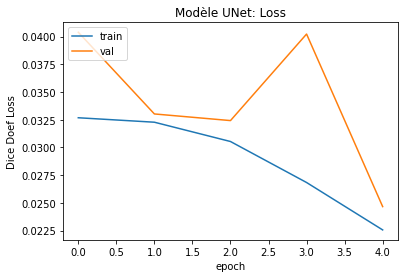

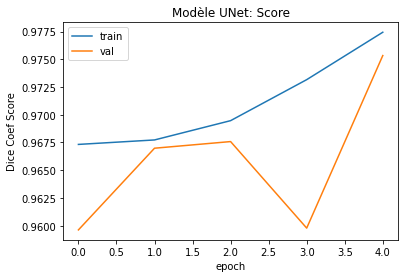

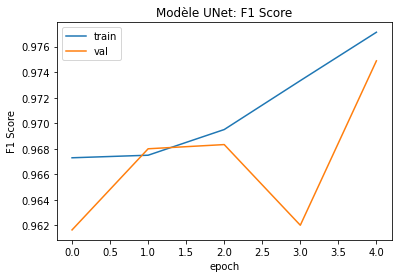

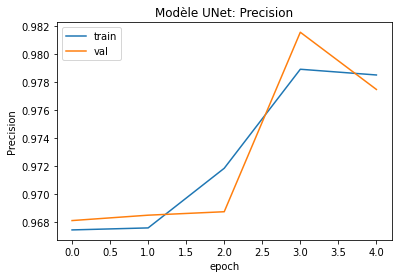

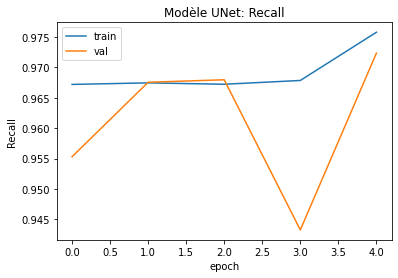

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history_5['loss'])
plt.plot(history_5['val_loss'])
plt.title('Modèle UNet: Loss')
plt.ylabel('Dice Doef Loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Loss.png")
plt.plot(history_5['dice_coef'])
plt.plot(history_5['val_dice_coef'])
plt.title('Modèle UNet: Score')
plt.ylabel('Dice Coef Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Score.png")
plt.plot(history_5['f1_m'])
plt.plot(history_5['val_f1_m'])
plt.title('Modèle UNet: F1 Score')
plt.ylabel('F1 Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_F1_Score.png")
plt.plot(history_5['precision_m'])
plt.plot(history_5['val_precision_m'])
plt.title('Modèle UNet: Precision')
plt.ylabel('Precision')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Precision.png")
plt.plot(history_5['recall_m'])
plt.plot(history_5['val_recall_m'])
plt.title('Modèle UNet: Recall')
plt.ylabel('Recall')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Recall.png")

In [ ]:
from tensorflow.keras.utils import to_categorical
Y_test_encod = to_categorical(Y_test)

In [ ]:
unet_model_5.compile(optimizer=Adam(lr=1e-5),loss=dice_coef_loss,metrics=[dice_coef,f1_m,precision_m, recall_m])

In [ ]:
loss,score,f1_score,precision,recall = unet_model_5.evaluate(X_test,Y_test_encod,verbose=0)

In [ ]:
print("Loss = ",loss,"Score= ",score,"F1-Score= ",f1_score,"Precision= ",precision,"Recall= ",recall)

Loss =  0.010759410824169192 Score=  0.98924077 F1-Score=  0.98818135 Precision=  0.9885738 Recall=  0.9877894


In [ ]:
Y_pre = np.argmax(unet_model_5.predict(X_test),axis=-1)

In [ ]:
np.unique(Y_pre)

array([0, 1, 2])

In [ ]:
Y_pre=Y_pre.reshape(-1,192,192,1)

In [ ]:
Y_test.shape,X_test.shape

((684, 192, 192, 1), (684, 192, 192, 4))

X_test 0


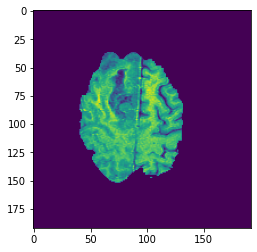

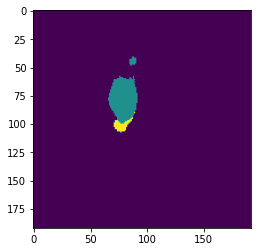

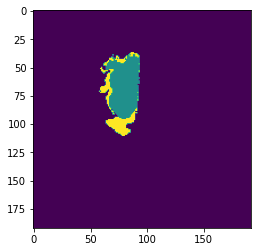

X_test 1


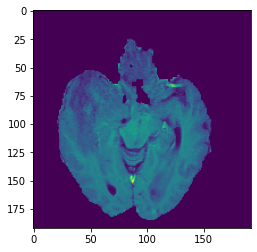

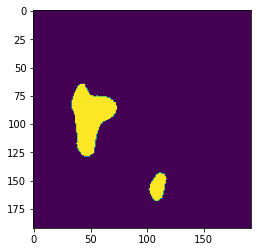

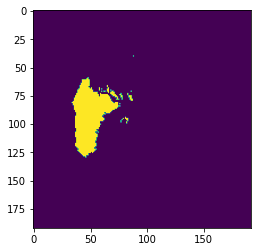

X_test 2


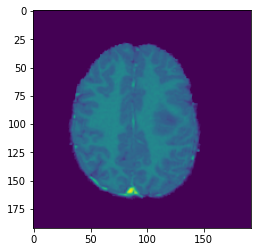

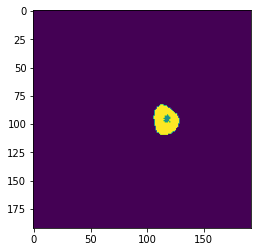

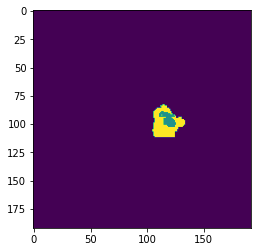

X_test 3


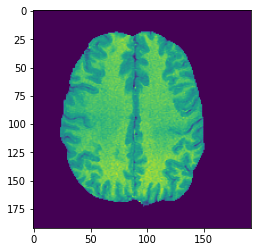

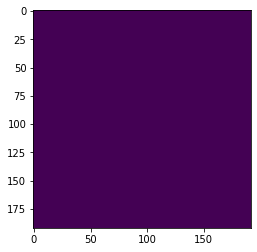

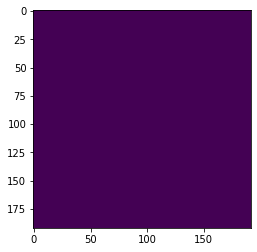

X_test 4


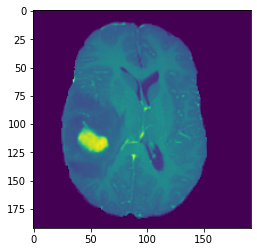

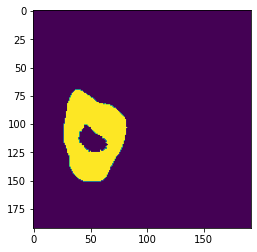

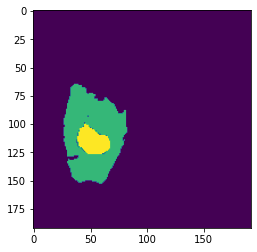

X_test 5


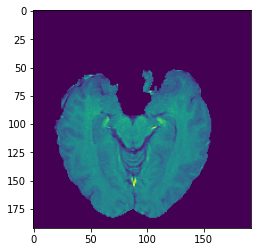

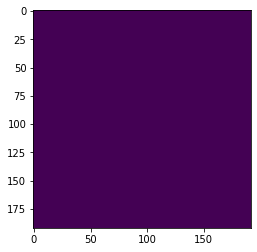

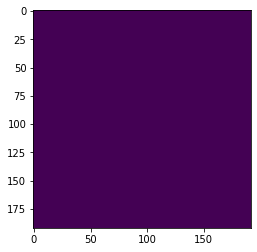

X_test 6


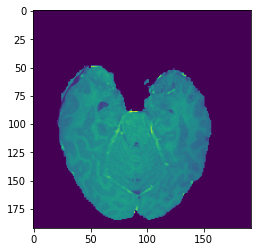

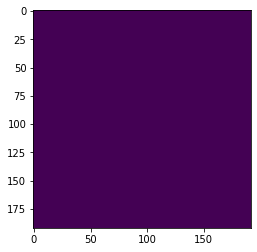

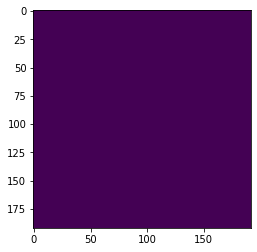

X_test 7


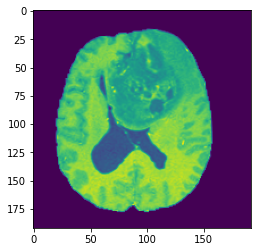

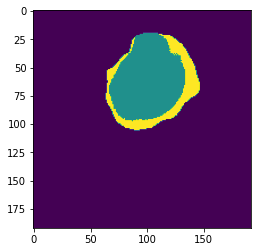

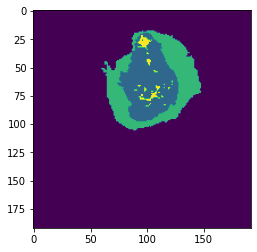

X_test 8


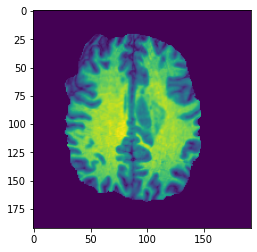

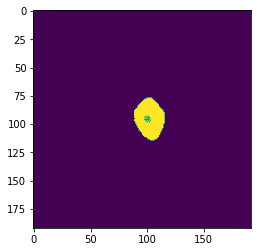

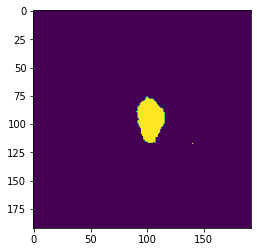

X_test 9


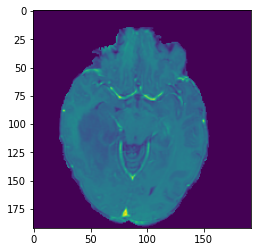

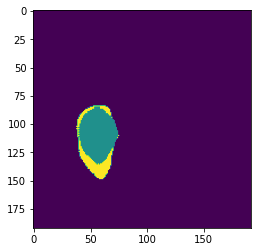

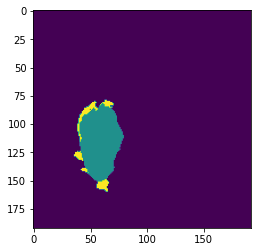

X_test 10


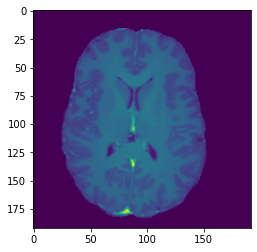

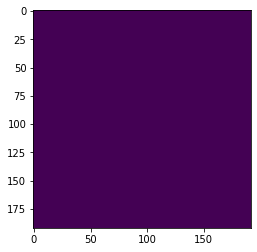

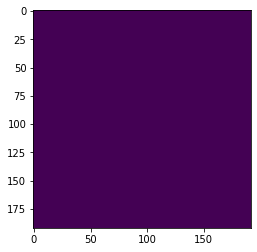

X_test 11


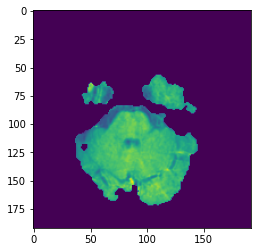

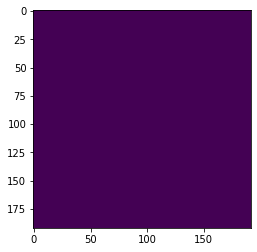

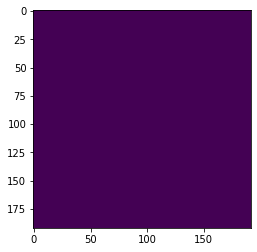

X_test 12


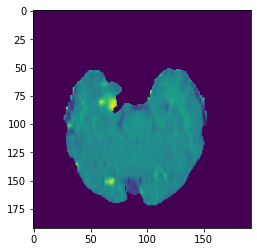

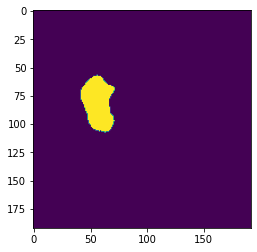

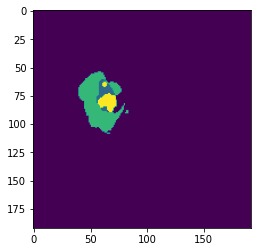

X_test 13


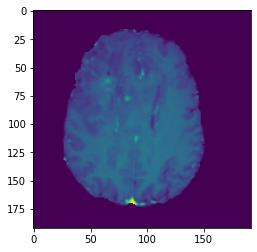

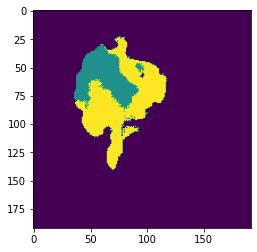

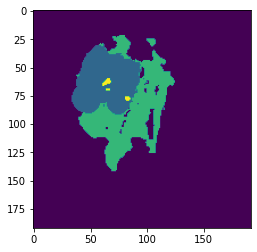

X_test 14


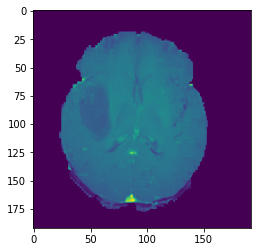

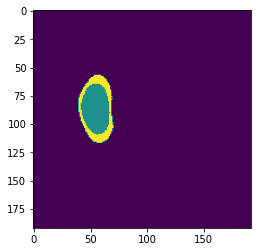

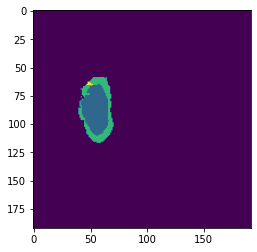

X_test 15


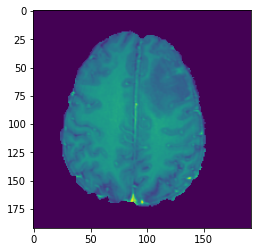

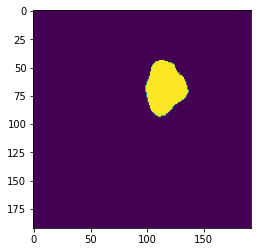

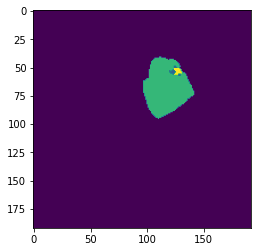

X_test 16


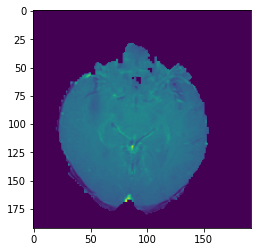

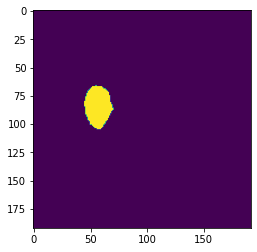

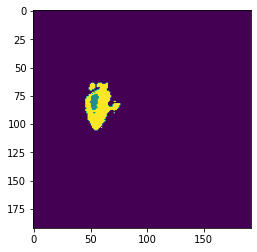

X_test 17


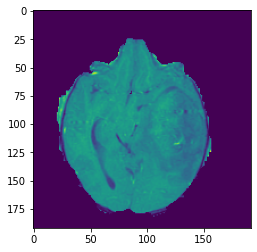

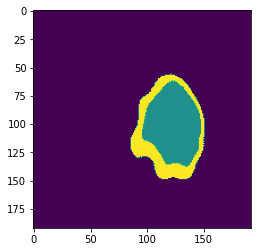

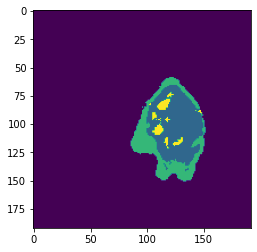

X_test 18


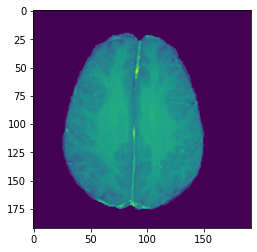

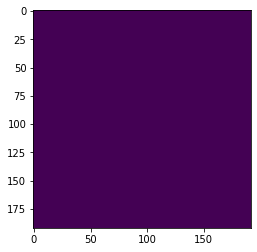

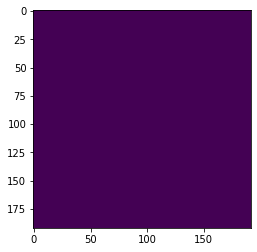

X_test 19


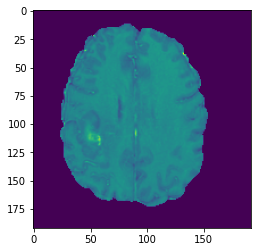

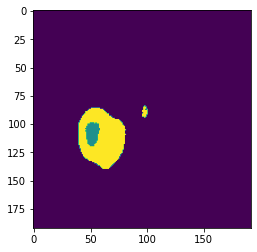

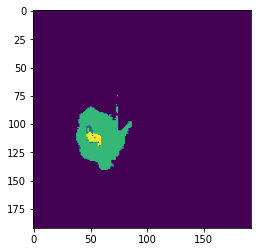

X_test 20


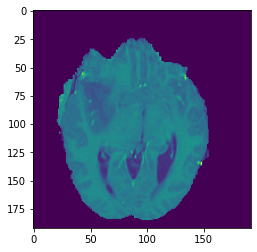

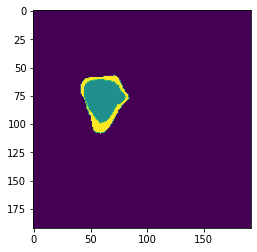

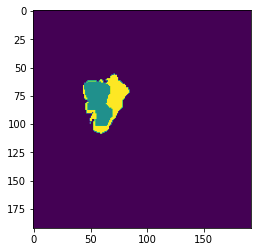

X_test 21


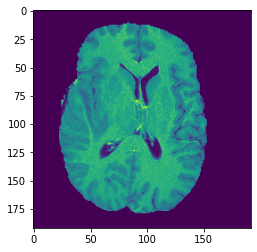

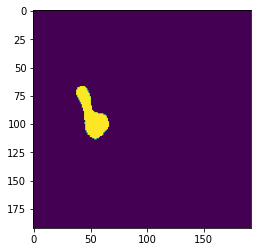

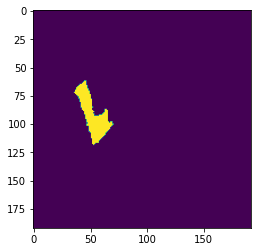

X_test 22


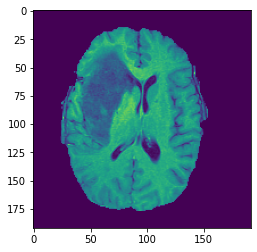

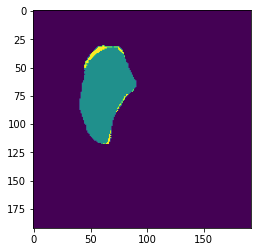

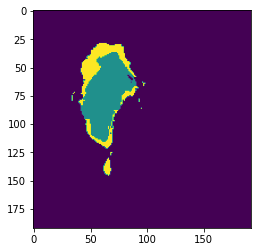

X_test 23


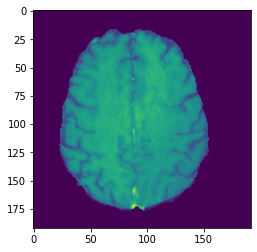

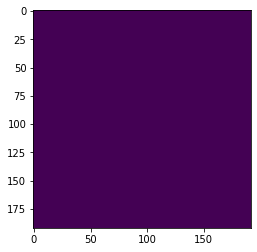

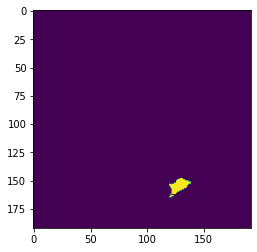

X_test 24


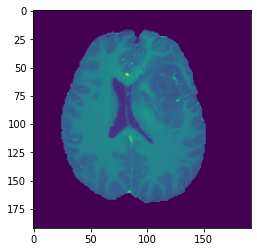

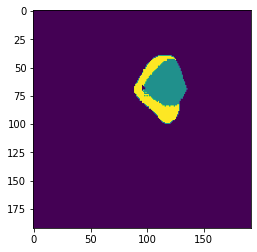

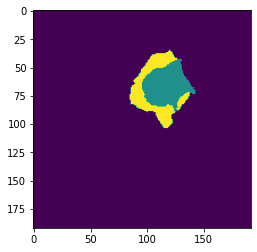

X_test 25


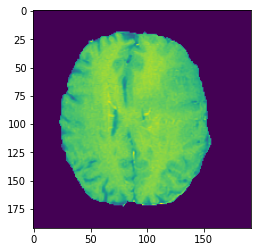

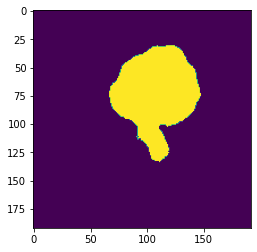

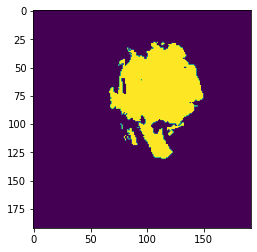

X_test 26


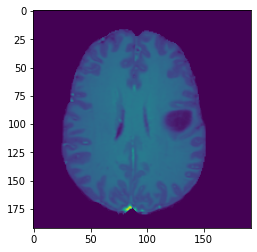

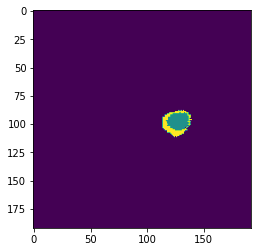

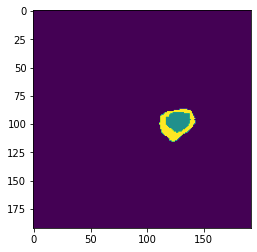

X_test 27


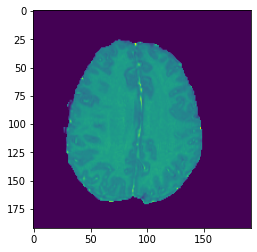

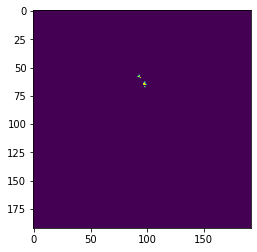

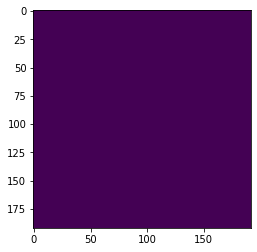

X_test 28


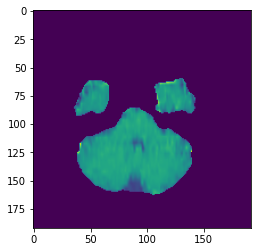

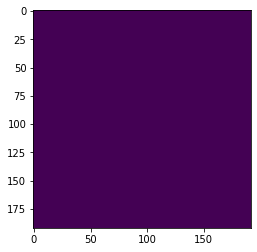

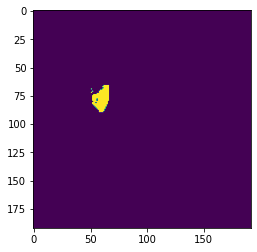

X_test 29


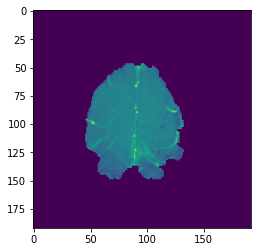

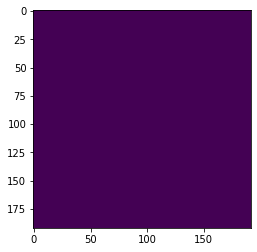

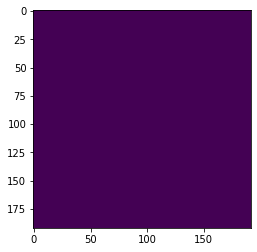

X_test 30


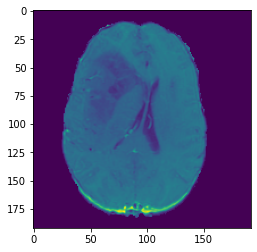

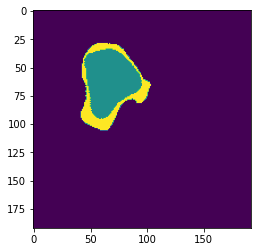

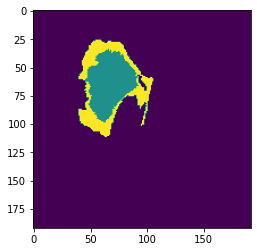

X_test 31


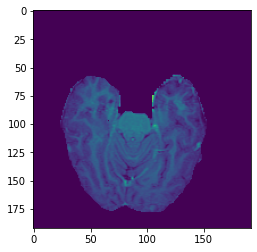

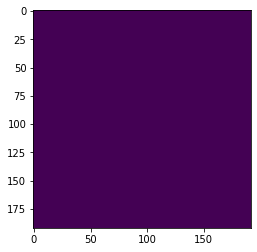

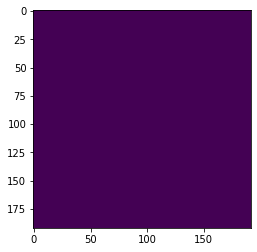

X_test 32


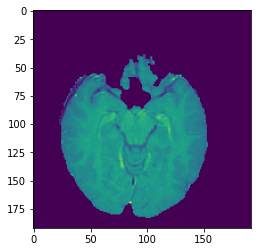

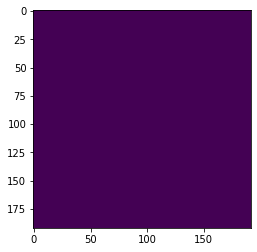

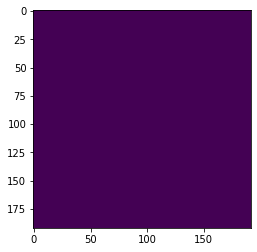

X_test 33


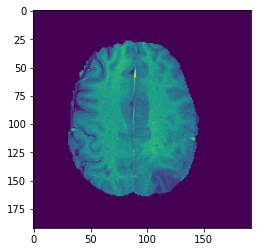

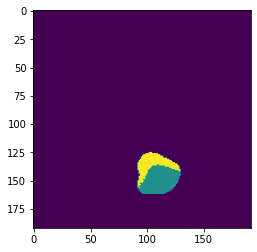

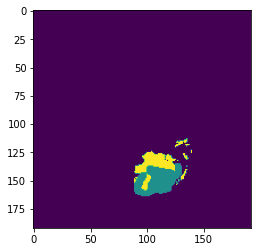

X_test 34


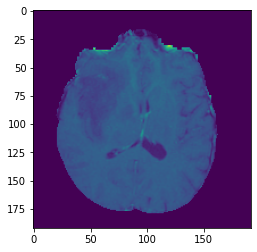

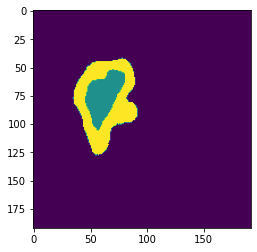

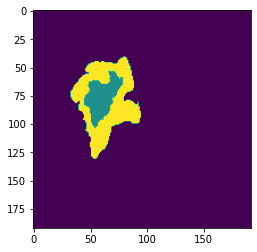

X_test 35


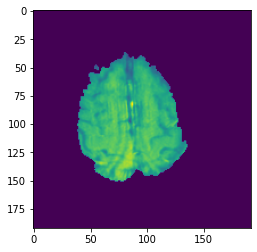

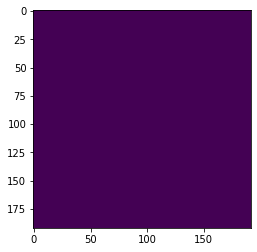

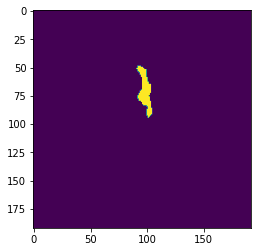

X_test 36


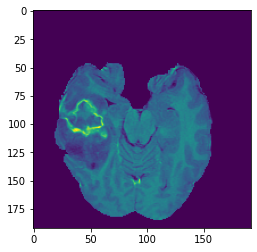

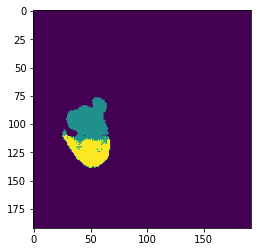

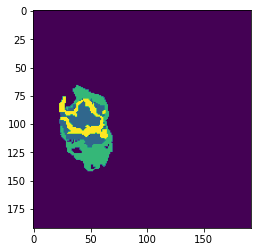

X_test 37


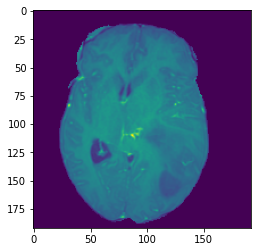

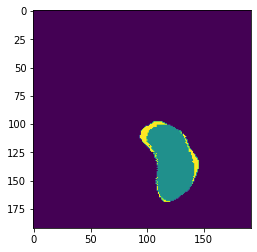

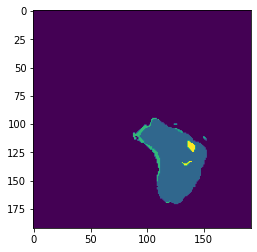

X_test 38


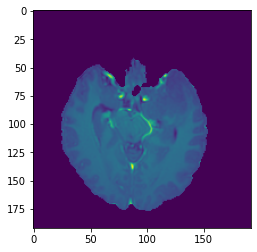

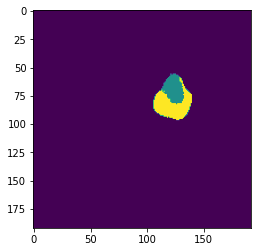

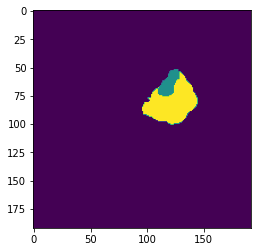

X_test 39


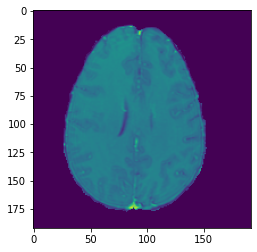

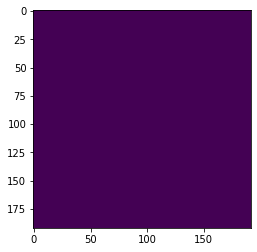

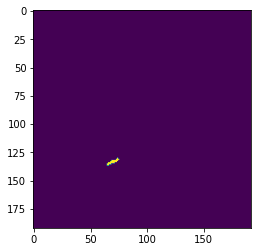

X_test 40


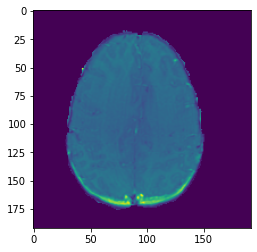

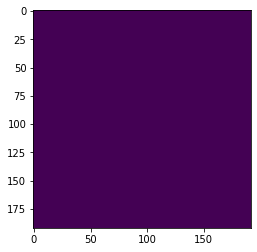

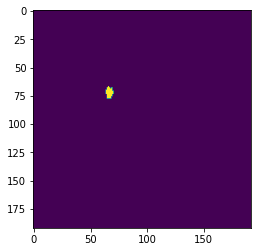

X_test 41


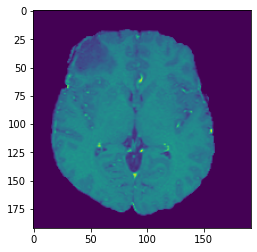

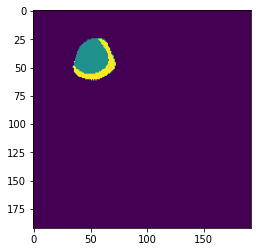

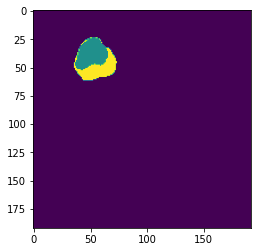

X_test 42


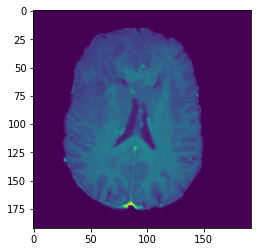

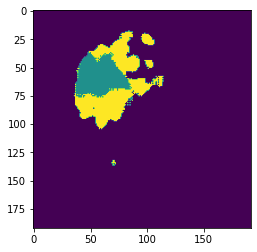

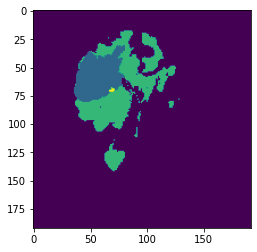

X_test 43


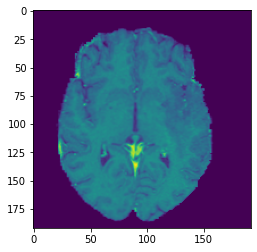

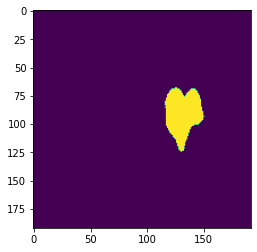

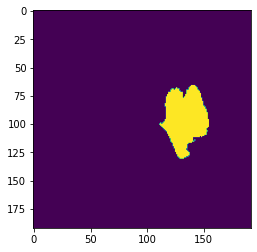

X_test 44


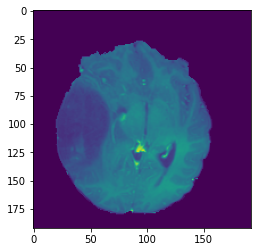

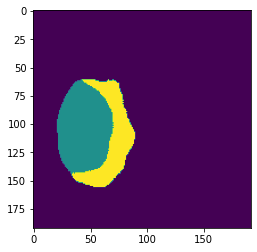

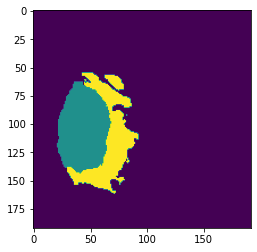

X_test 45


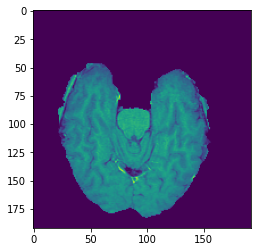

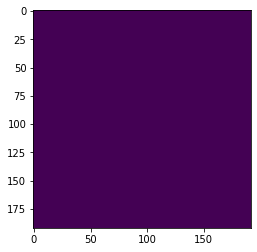

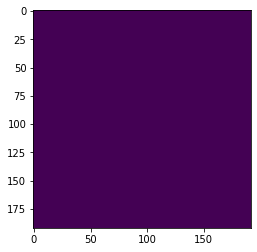

X_test 46


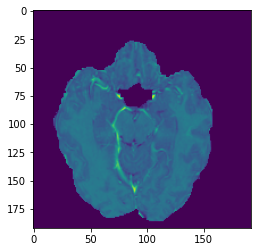

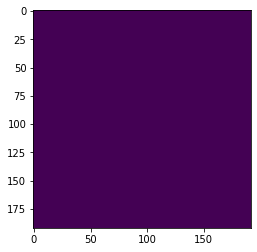

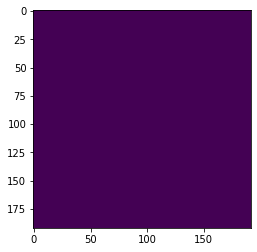

X_test 47


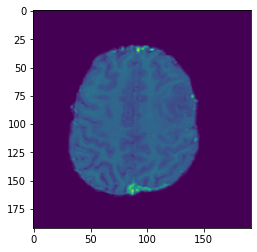

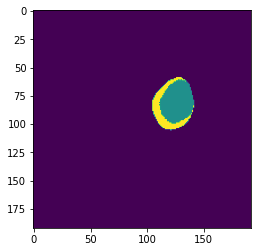

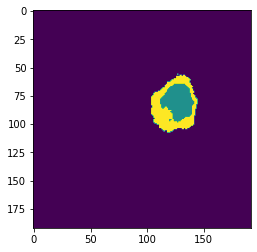

X_test 48


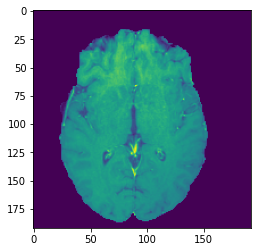

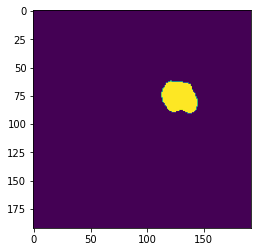

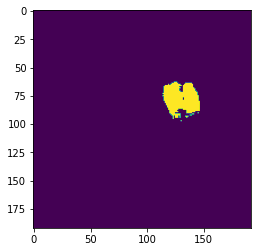

X_test 49


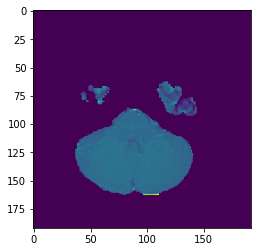

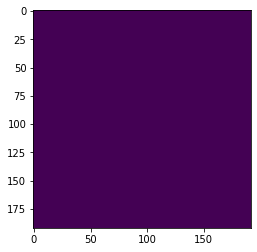

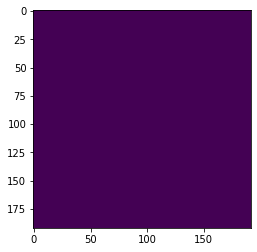

X_test 50


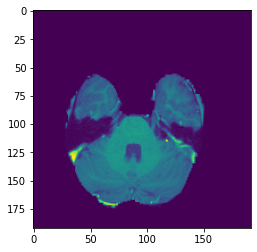

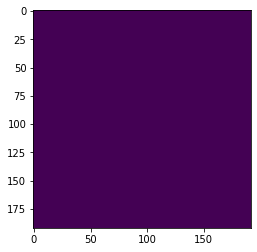

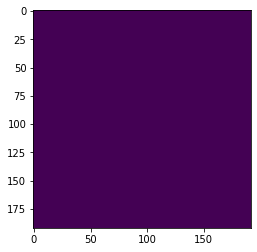

X_test 51


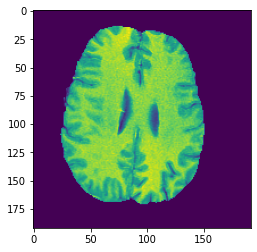

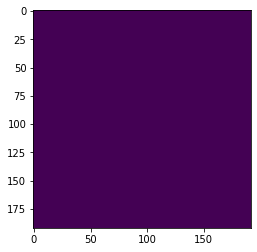

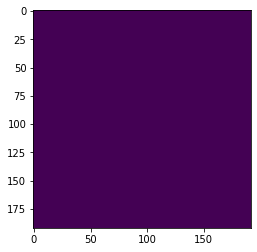

X_test 52


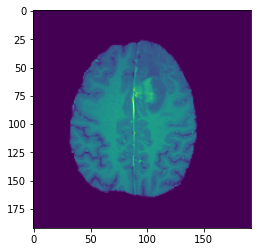

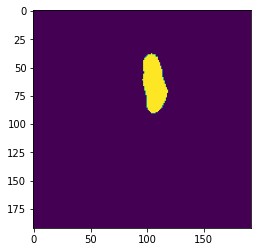

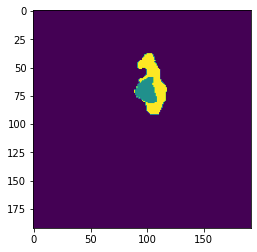

X_test 53


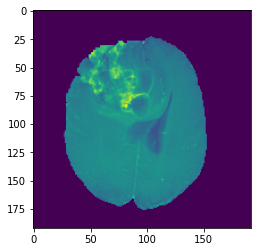

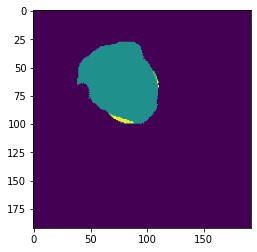

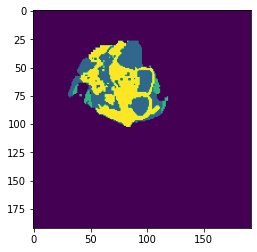

X_test 54


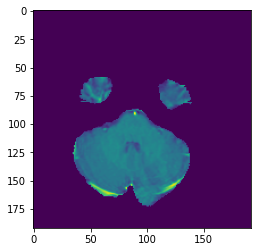

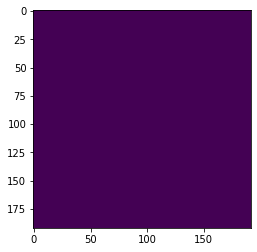

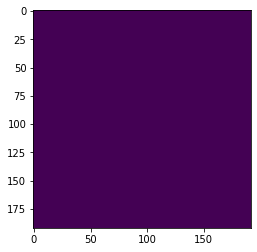

X_test 55


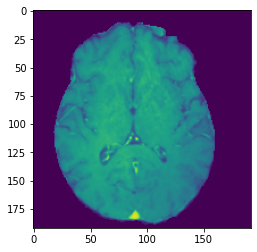

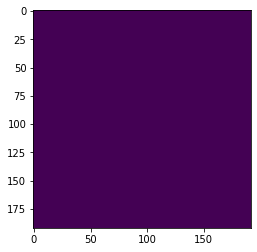

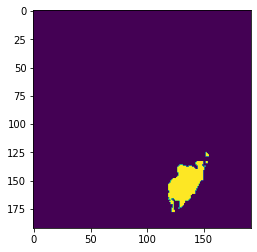

X_test 56


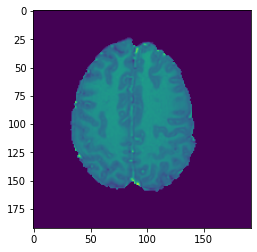

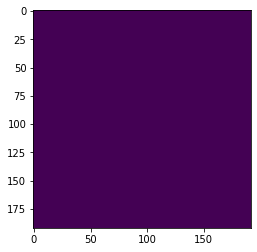

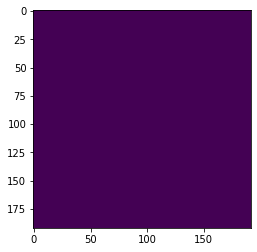

X_test 57


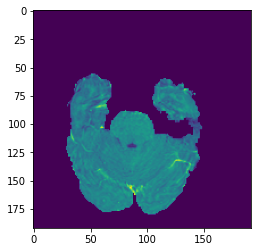

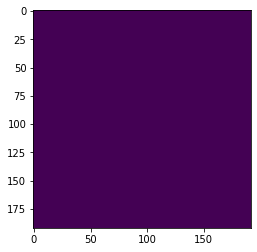

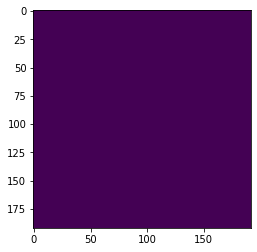

X_test 58


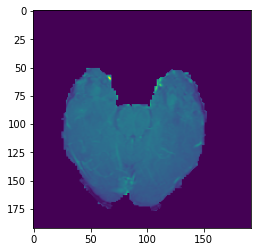

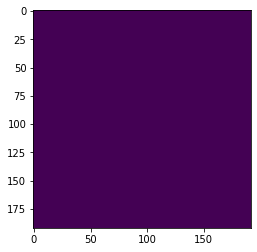

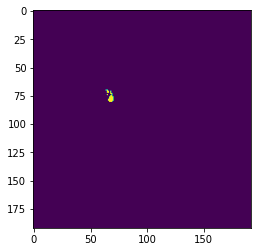

X_test 59


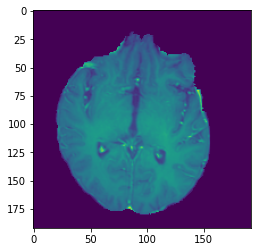

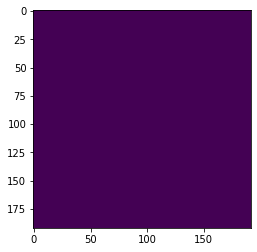

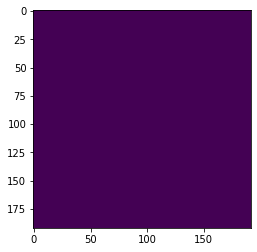

X_test 60


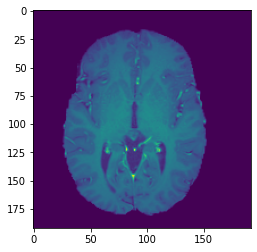

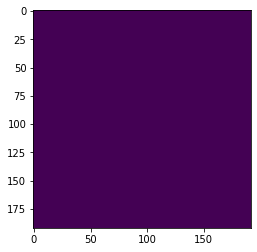

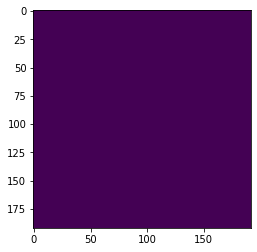

X_test 61


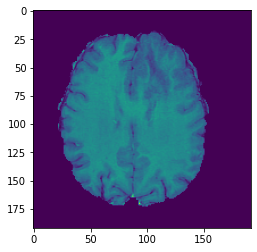

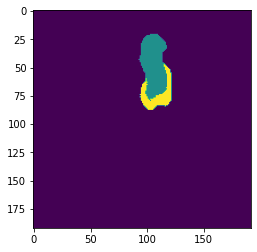

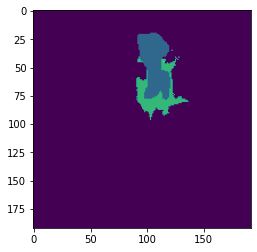

X_test 62


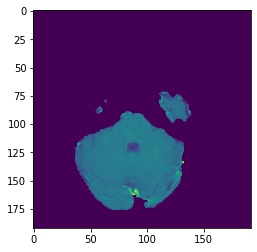

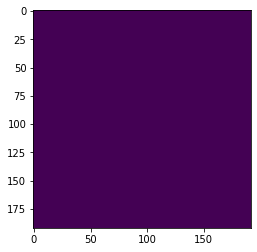

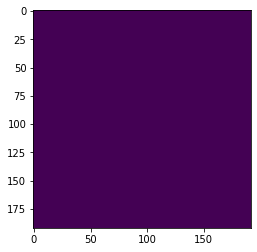

X_test 63


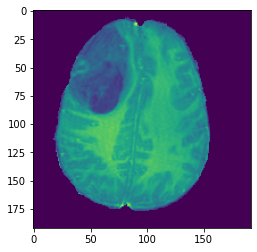

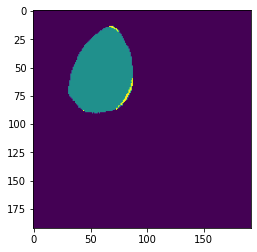

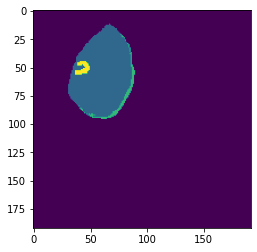

X_test 64


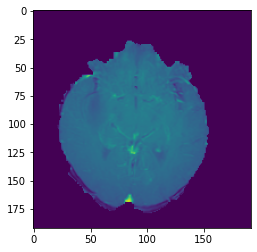

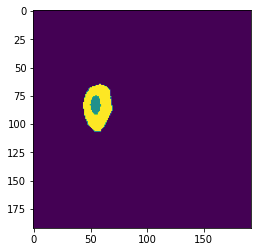

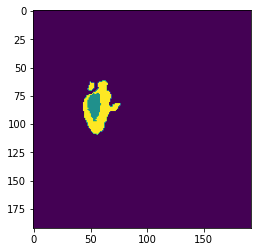

X_test 65


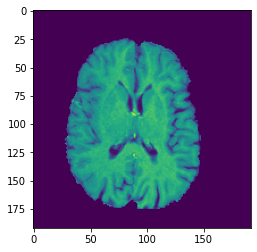

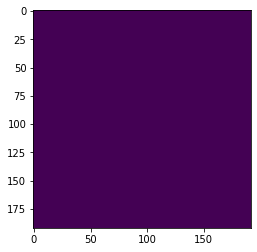

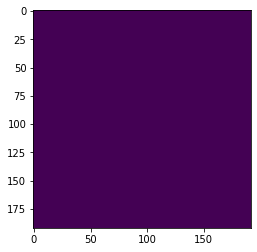

X_test 66


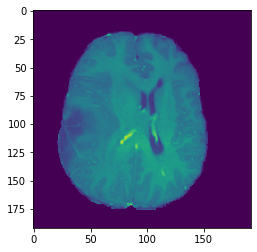

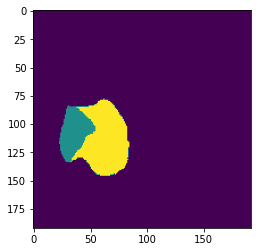

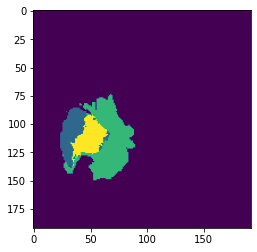

X_test 67


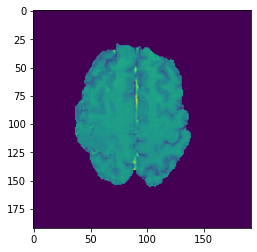

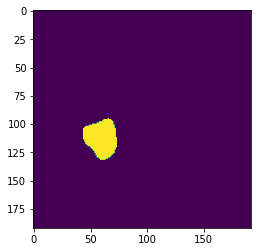

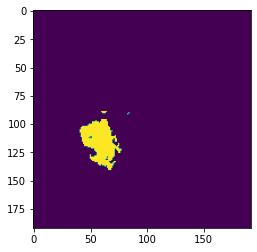

X_test 68


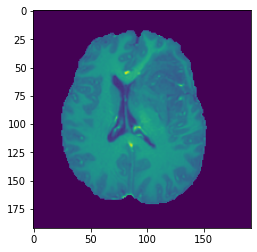

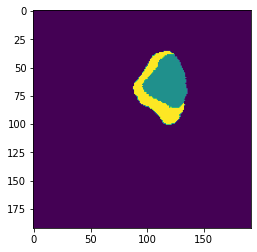

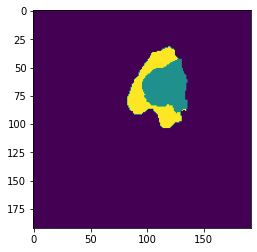

X_test 69


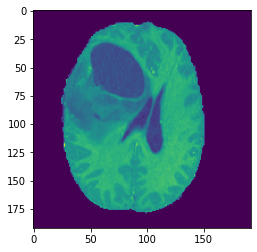

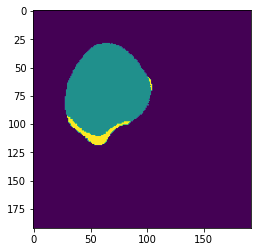

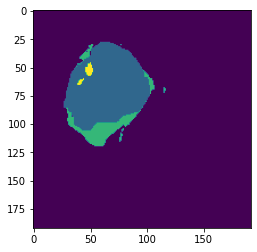

X_test 70


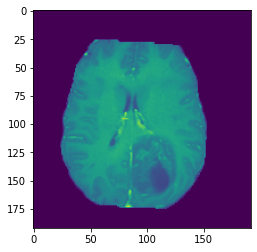

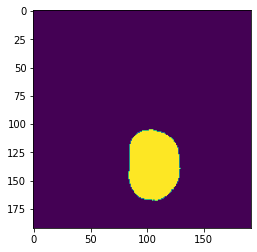

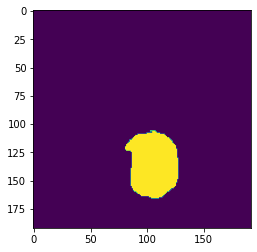

X_test 71


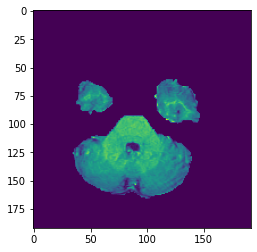

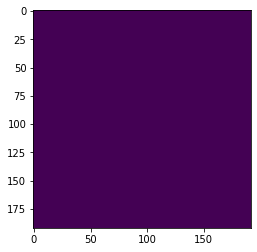

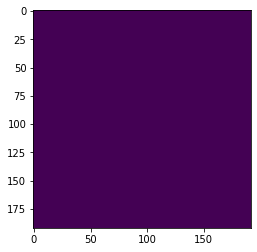

X_test 72


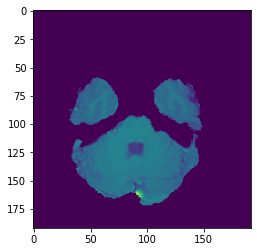

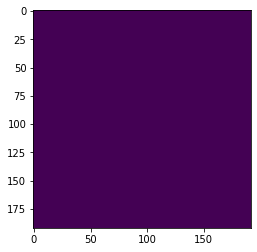

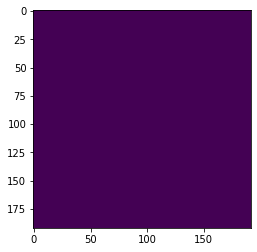

X_test 73


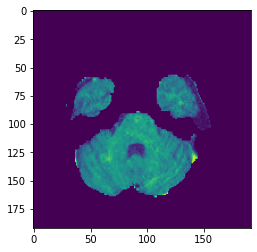

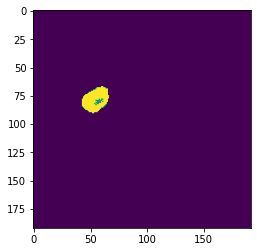

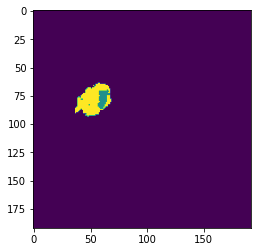

X_test 74


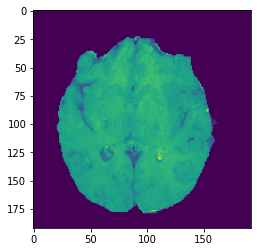

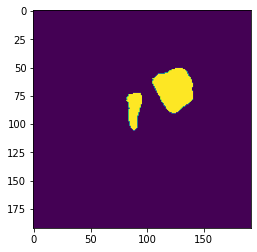

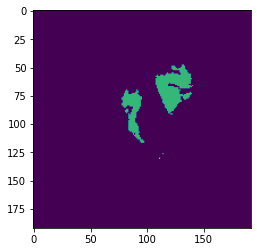

X_test 75


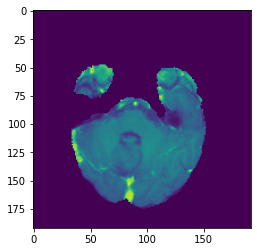

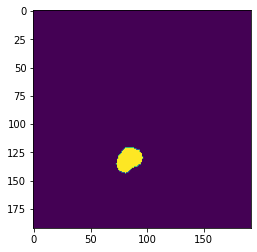

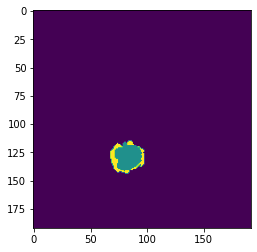

X_test 76


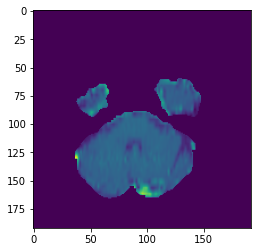

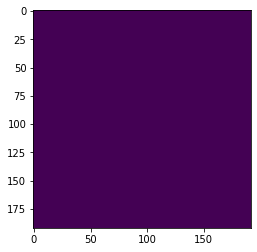

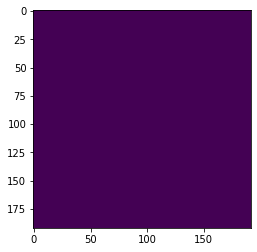

X_test 77


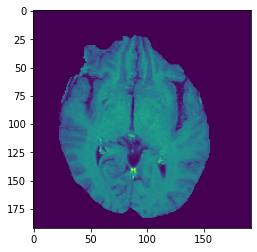

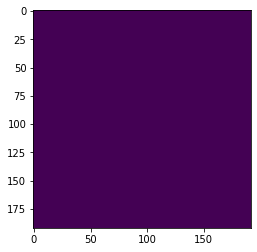

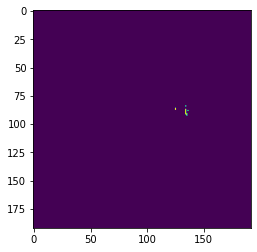

X_test 78


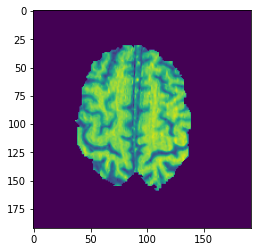

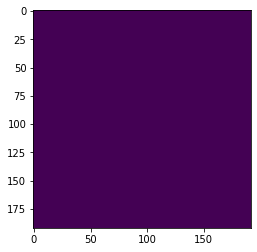

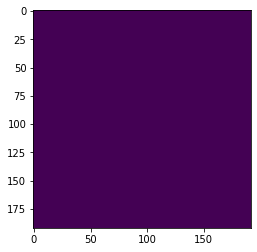

X_test 79


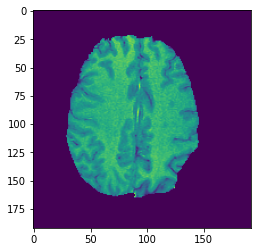

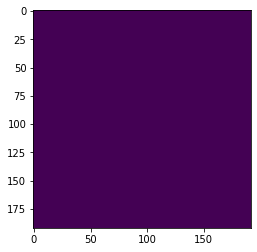

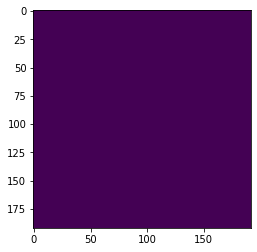

X_test 80


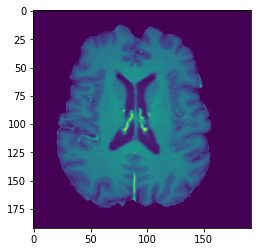

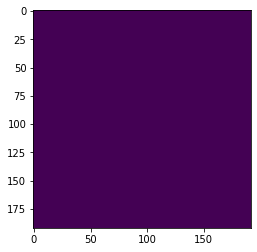

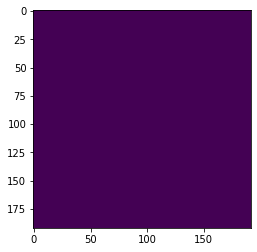

X_test 81


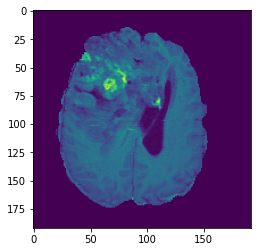

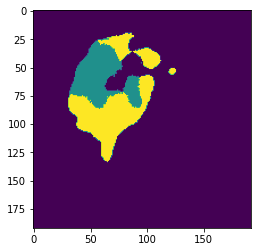

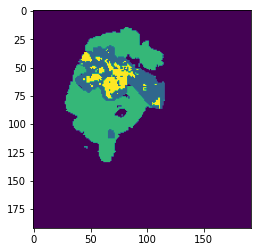

X_test 82


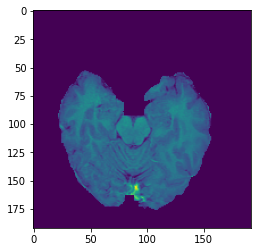

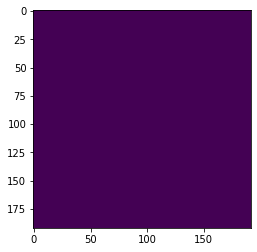

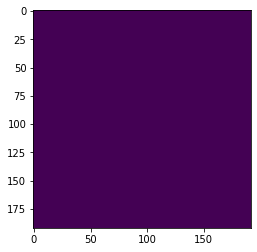

X_test 83


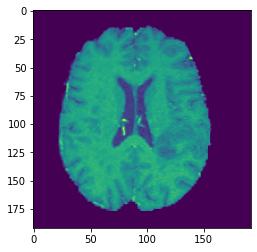

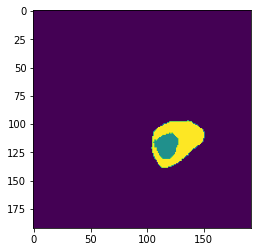

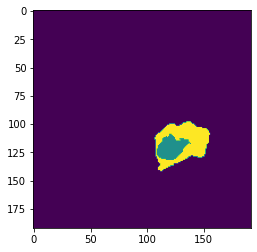

X_test 84


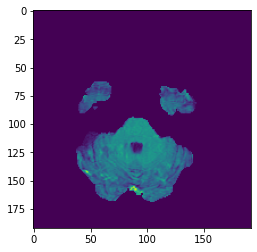

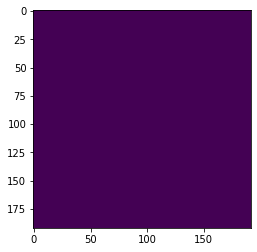

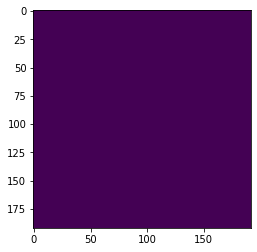

X_test 85


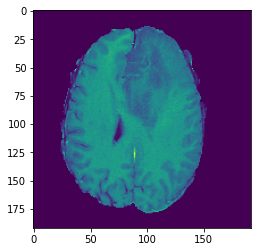

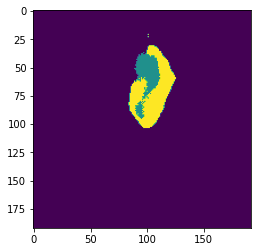

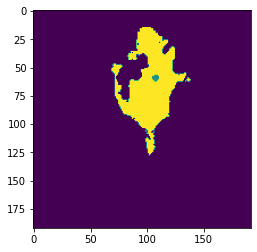

X_test 86


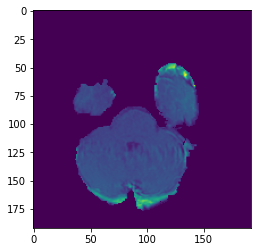

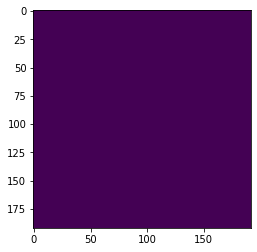

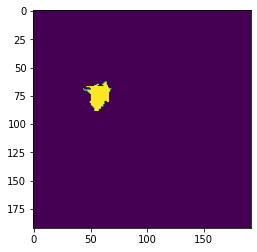

X_test 87


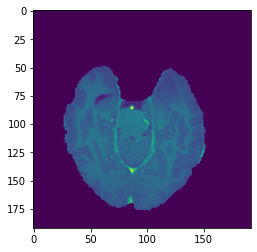

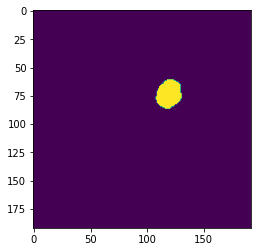

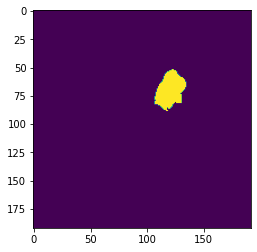

X_test 88


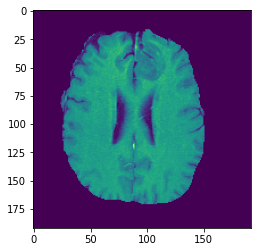

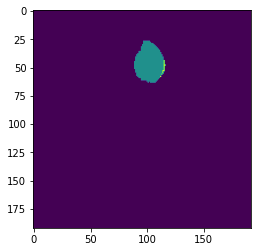

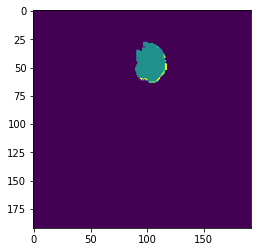

X_test 89


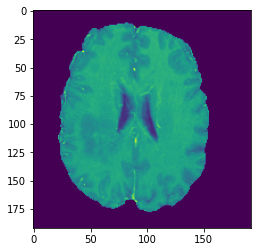

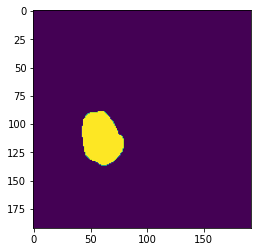

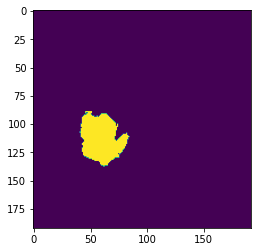

In [ ]:
for i in range(0,90):
  print('X_test '+ str(i))
  plt.imshow(X_test[i,:,:,2])
  plt.show()
  plt.imshow(Y_pre[i,:,:,0])
  plt.show()
  plt.imshow(Y_test[i,:,:,0])
  plt.show()

## UNet with 15 epoches

### Load model and training history data

In [ ]:
from tensorflow.keras.models import model_from_json
json_file = open('Model/unet15_model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
unet_model_15 = model_from_json(loaded_model_json)

unet_model_15.load_weights("Model/unet15_model.h5")
print("Loaded model from disk")

Loaded model from disk


In [ ]:
import pandas as pd 
history_15 = pd.read_csv("History/history15u.csv")
history_15.head()

,Unnamed: 0,loss,dice_coef,f1_m,precision_m,recall_m,val_loss,val_dice_coef,val_f1_m,val_precision_m,val_recall_m
0,0,0.020049,0.979952,0.979372,0.981245,0.977507,0.021221,0.978780,0.977872,0.981252,0.974519
1,1,0.017910,0.982091,0.980761,0.983044,0.978490,0.018738,0.981263,0.979775,0.981354,0.978202
2,2,0.016492,0.983508,0.982027,0.983451,0.980607,0.017812,0.982188,0.980691,0.981650,0.979734
3,3,0.015434,0.984567,0.983171,0.984324,0.982022,0.018430,0.981571,0.980306,0.980875,0.979738
4,4,0.014570,0.985431,0.984169,0.985107,0.983233,0.016594,0.983406,0.982082,0.982790,0.981375


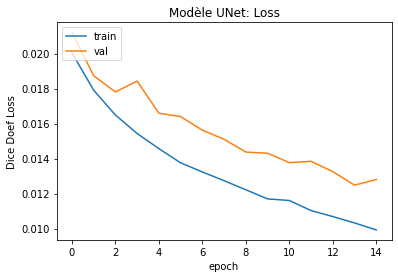

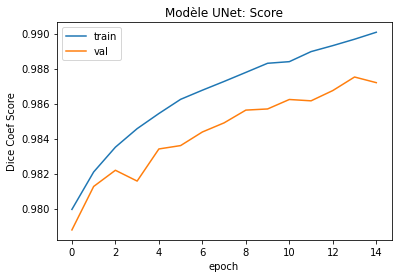

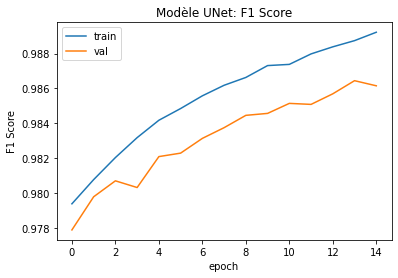

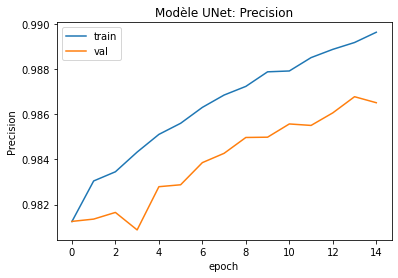

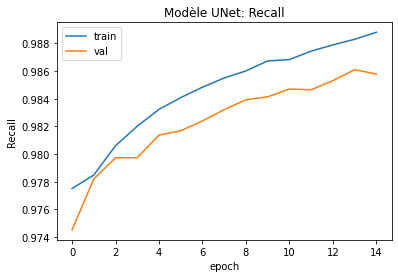

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history_15['loss'])
plt.plot(history_15['val_loss'])
plt.title('Modèle UNet: Loss')
plt.ylabel('Dice Doef Loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Loss.png")
plt.plot(history_15['dice_coef'])
plt.plot(history_15['val_dice_coef'])
plt.title('Modèle UNet: Score')
plt.ylabel('Dice Coef Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Score.png")
plt.plot(history_15['f1_m'])
plt.plot(history_15['val_f1_m'])
plt.title('Modèle UNet: F1 Score')
plt.ylabel('F1 Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_F1_Score.png")
plt.plot(history_15['precision_m'])
plt.plot(history_15['val_precision_m'])
plt.title('Modèle UNet: Precision')
plt.ylabel('Precision')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Precision.png")
plt.plot(history_15['recall_m'])
plt.plot(history_15['val_recall_m'])
plt.title('Modèle UNet: Recall')
plt.ylabel('Recall')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Recall.png")

In [ ]:
unet_model_15.compile(optimizer=Adam(lr=1e-5),loss=dice_coef_loss,metrics=[dice_coef,f1_m,precision_m, recall_m])

In [ ]:
loss,score,f1_score,precision,recall = unet_model_15.evaluate(X_test,Y_test_encod,verbose=0)

In [ ]:
print("Loss = ",loss,"Score= ",score,"F1-Score= ",f1_score,"Precision= ",precision,"Recall= ",recall)

Loss =  0.010759410911310486 Score=  0.98924077 F1-Score=  0.98818135 Precision=  0.9885738 Recall=  0.9877894


In [ ]:
Y_pre = np.argmax(unet_model_15.predict(X_test),axis=-1)

In [ ]:
np.unique(Y_pre)

array([0, 1, 2])

In [ ]:
Y_pre=Y_pre.reshape(-1,192,192,1)

In [ ]:
Y_test.shape,X_test.shape

((684, 192, 192, 1), (684, 192, 192, 4))

X_test 0


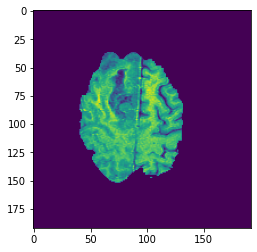

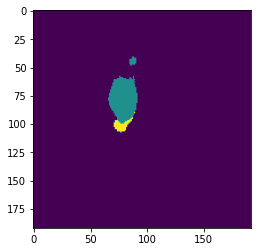

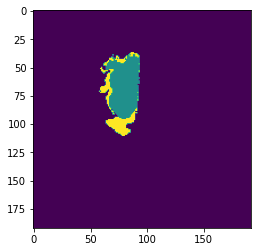

X_test 1


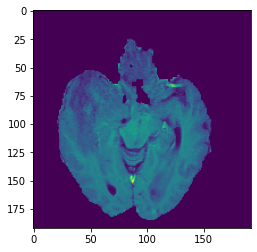

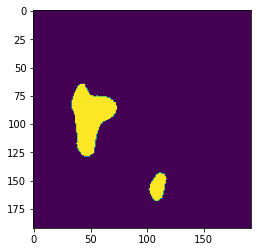

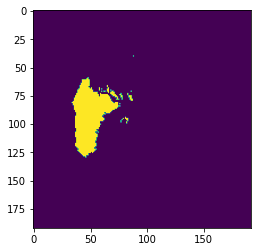

X_test 2


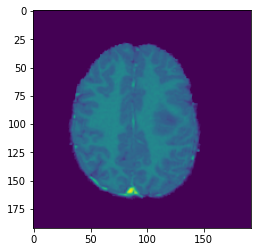

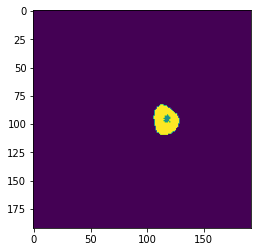

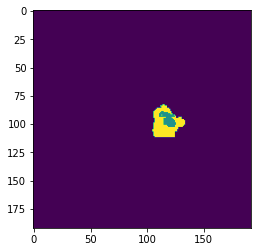

X_test 3


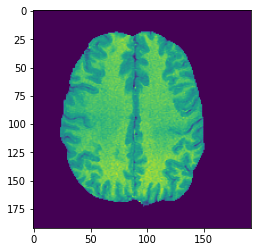

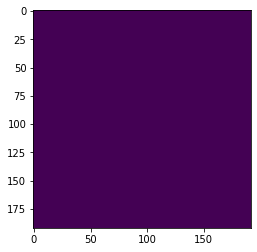

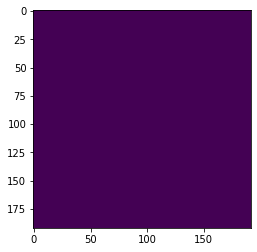

X_test 4


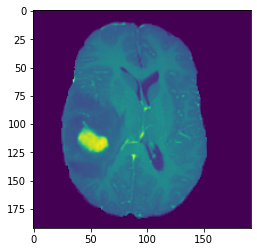

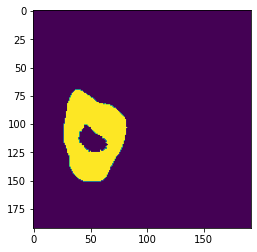

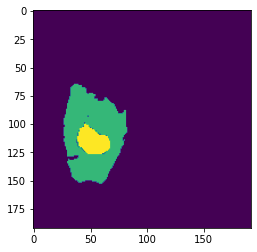

X_test 5


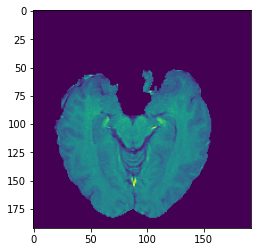

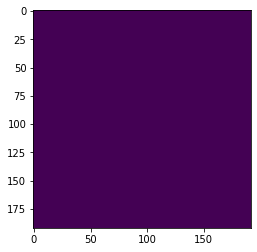

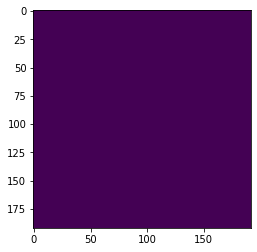

X_test 6


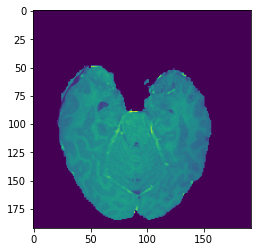

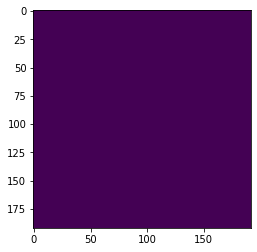

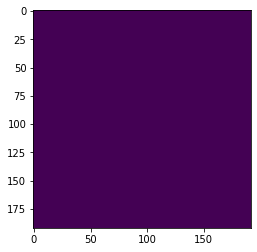

X_test 7


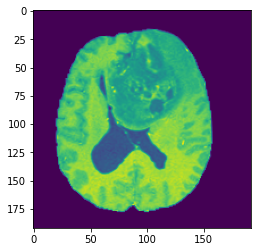

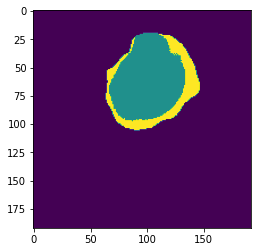

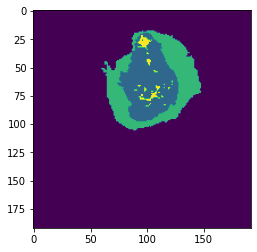

X_test 8


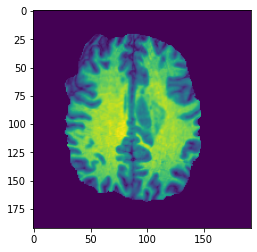

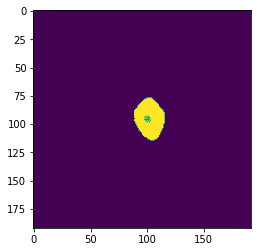

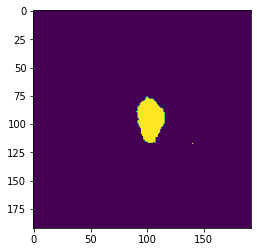

X_test 9


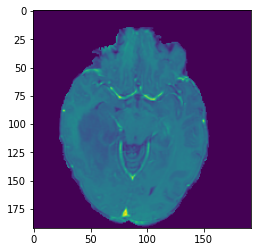

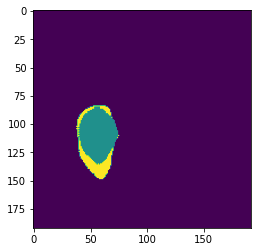

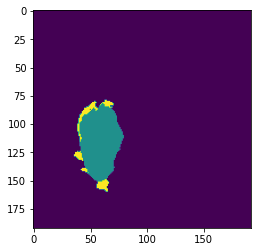

X_test 10


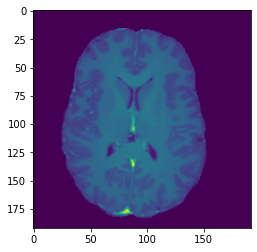

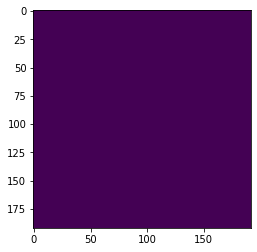

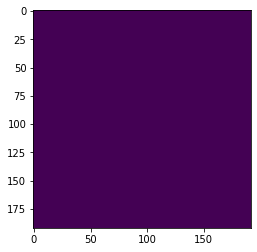

X_test 11


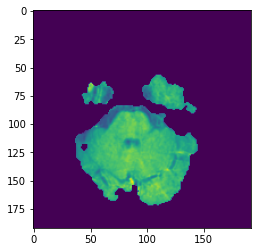

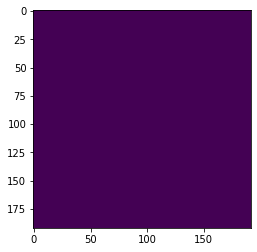

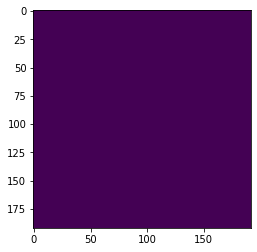

X_test 12


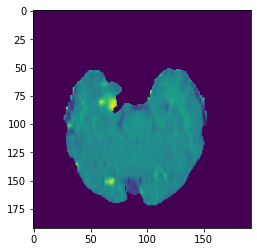

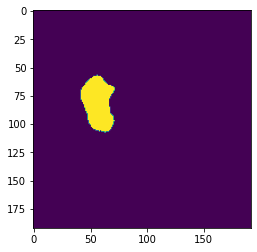

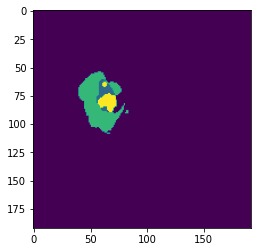

X_test 13


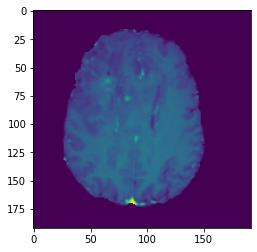

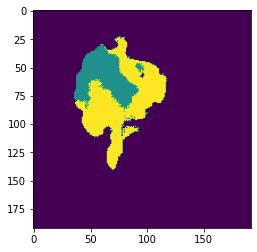

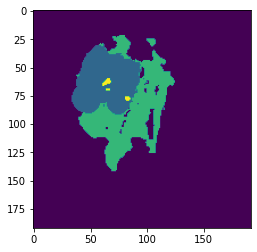

X_test 14


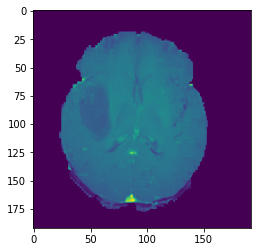

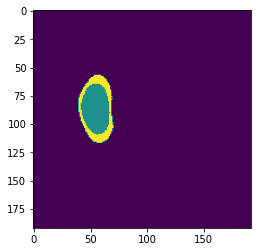

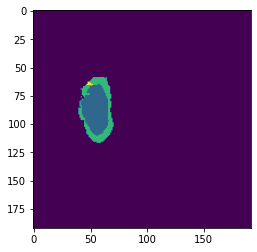

X_test 15


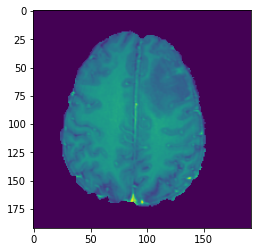

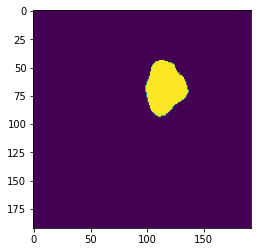

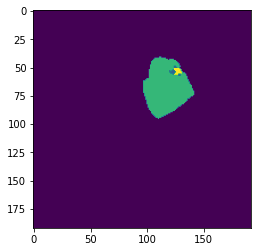

X_test 16


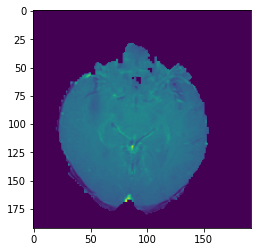

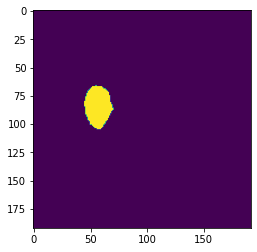

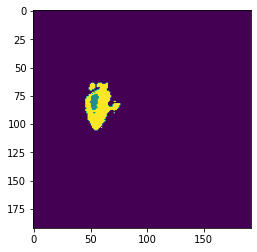

X_test 17


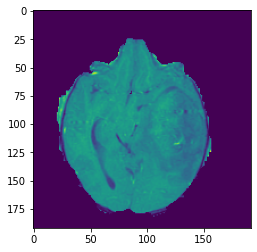

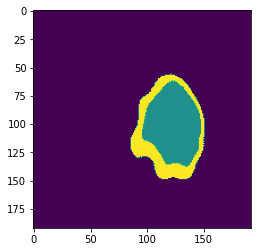

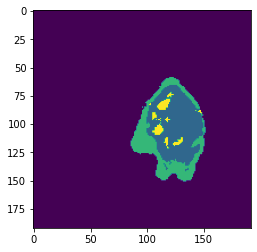

X_test 18


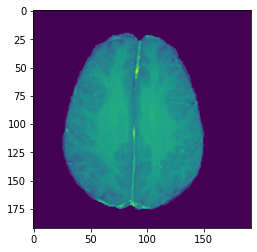

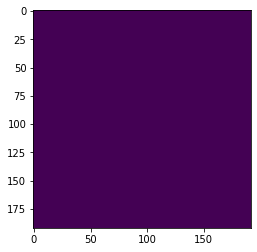

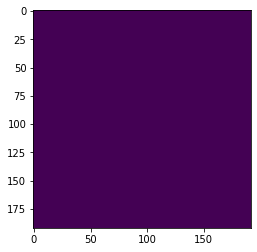

X_test 19


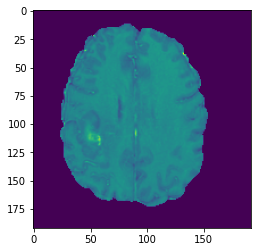

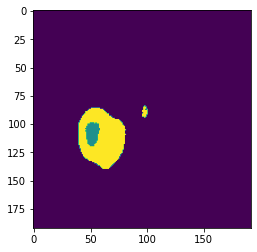

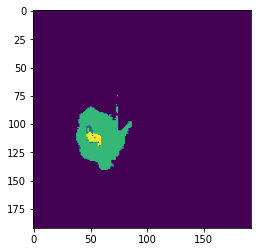

X_test 20


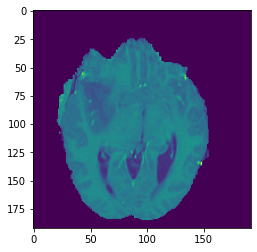

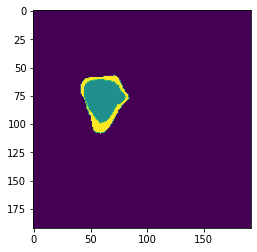

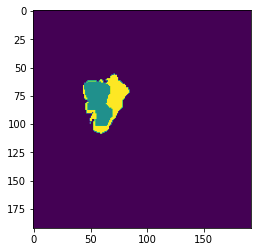

X_test 21


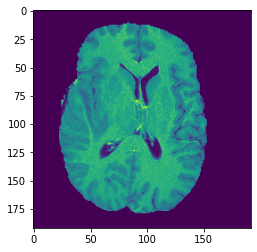

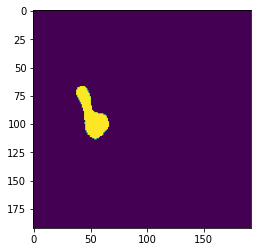

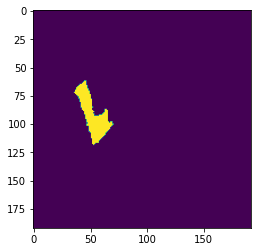

X_test 22


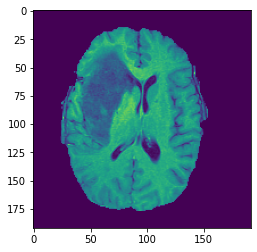

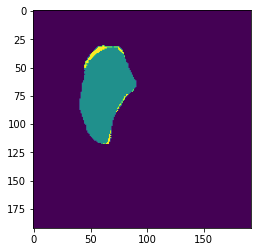

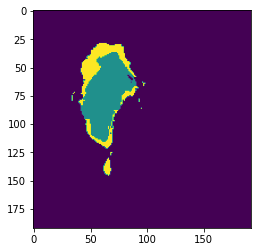

X_test 23


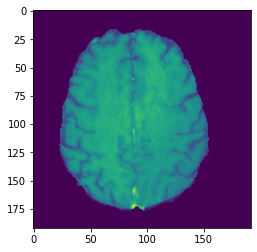

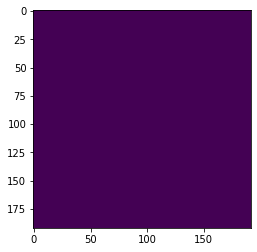

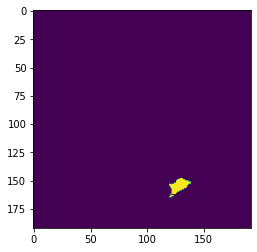

X_test 24


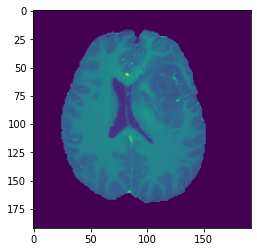

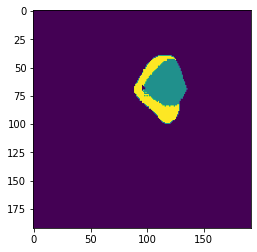

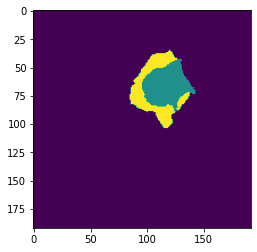

X_test 25


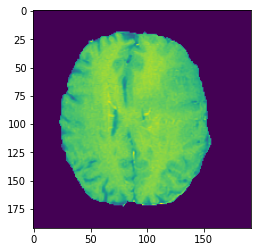

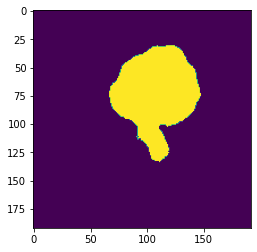

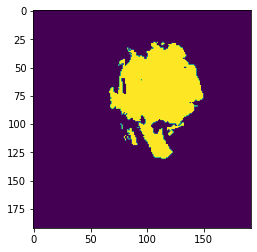

X_test 26


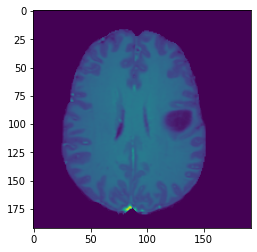

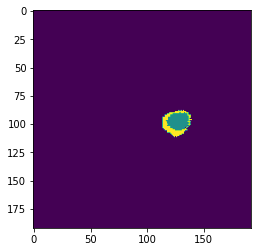

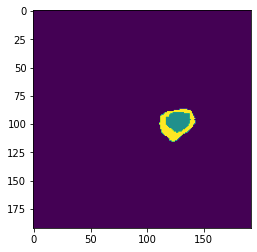

X_test 27


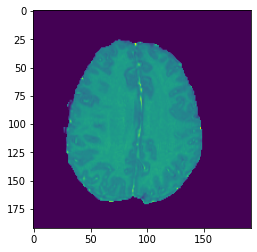

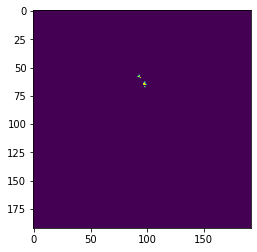

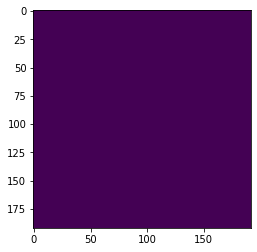

X_test 28


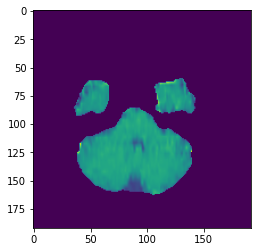

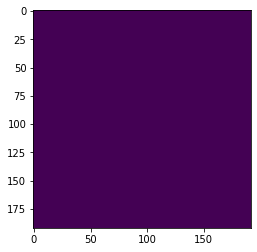

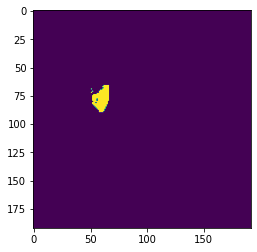

X_test 29


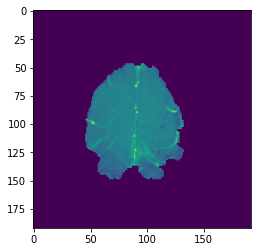

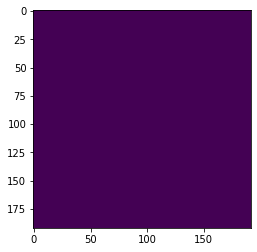

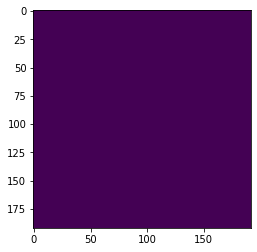

X_test 30


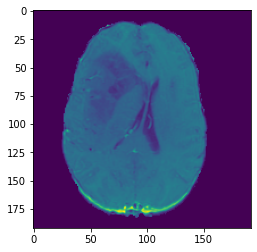

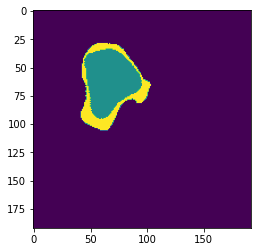

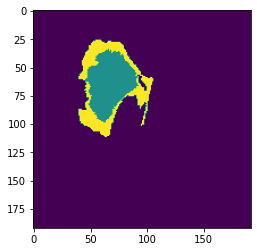

X_test 31


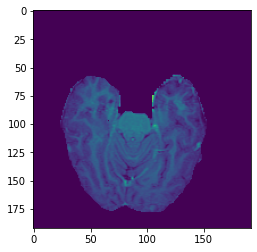

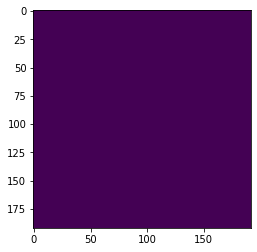

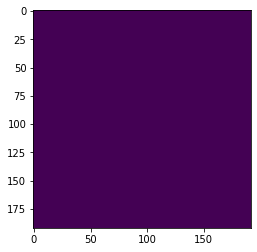

X_test 32


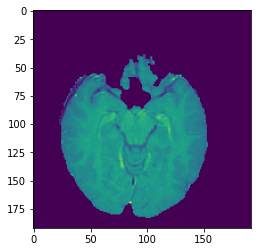

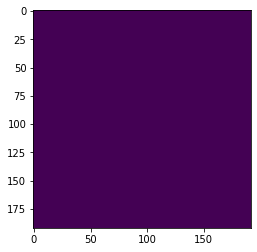

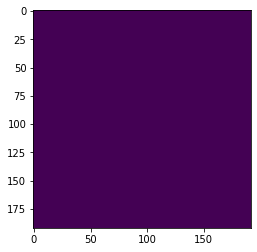

X_test 33


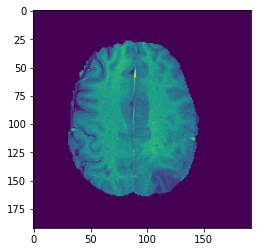

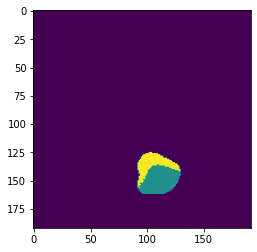

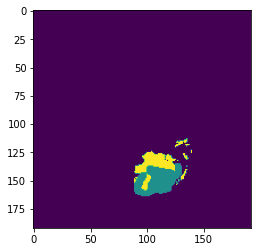

X_test 34


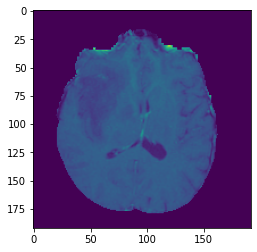

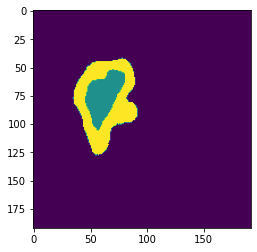

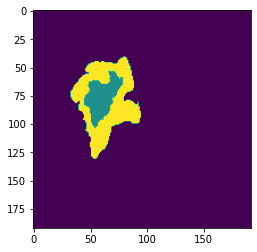

X_test 35


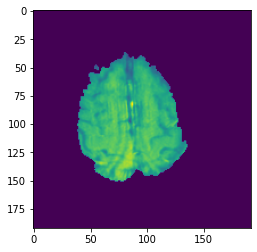

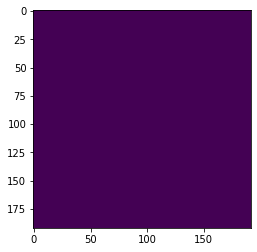

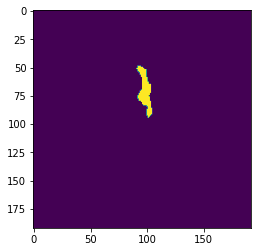

X_test 36


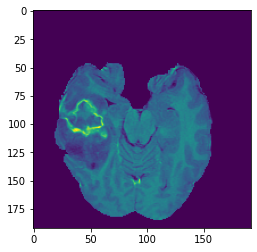

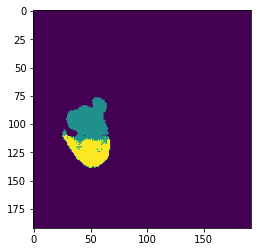

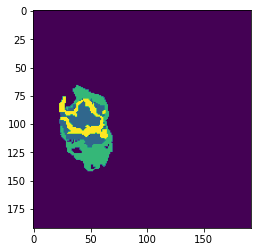

X_test 37


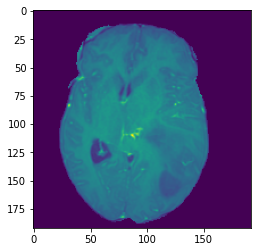

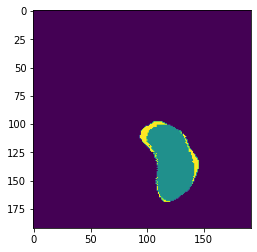

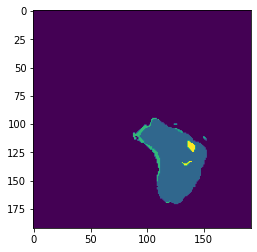

X_test 38


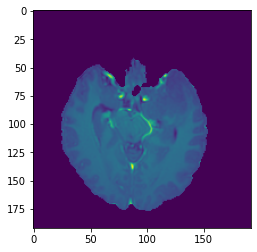

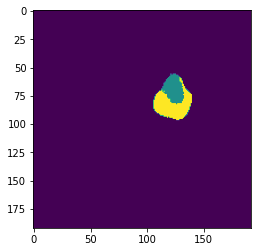

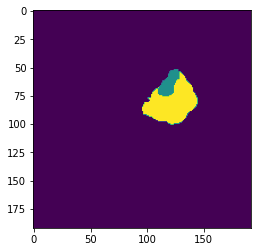

X_test 39


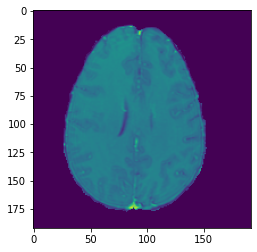

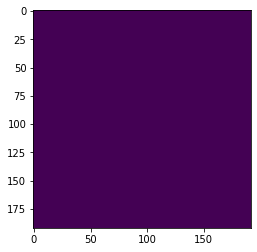

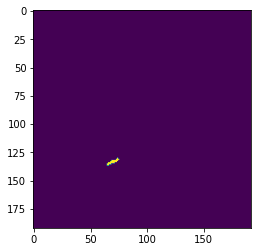

X_test 40


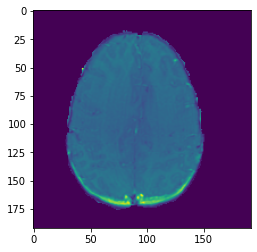

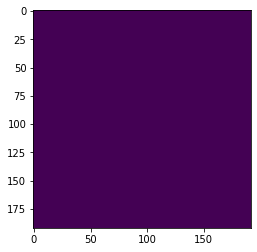

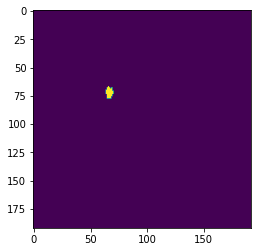

X_test 41


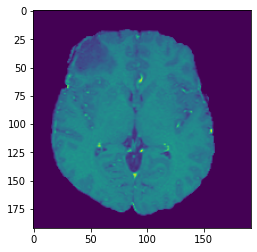

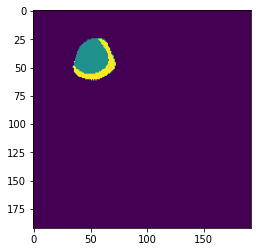

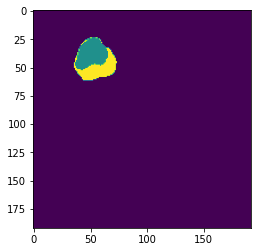

X_test 42


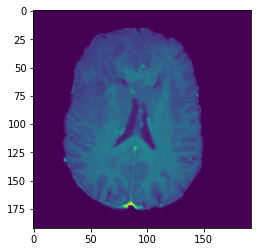

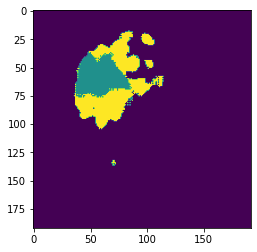

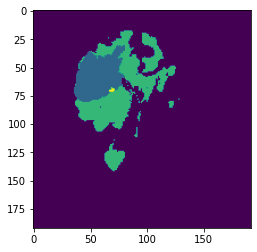

X_test 43


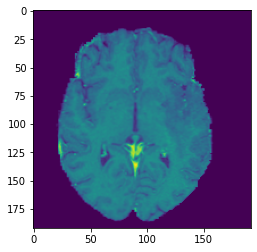

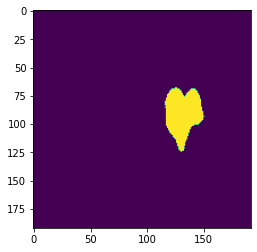

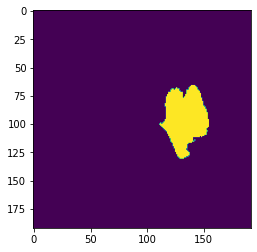

X_test 44


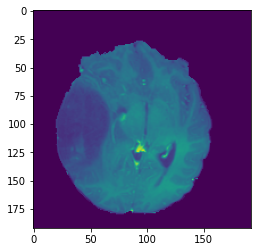

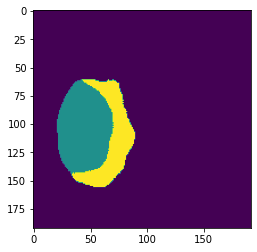

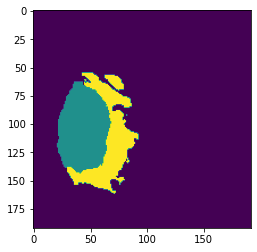

X_test 45


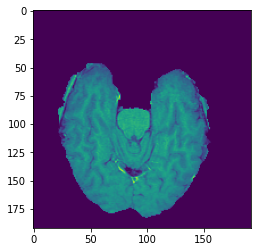

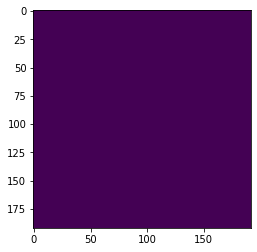

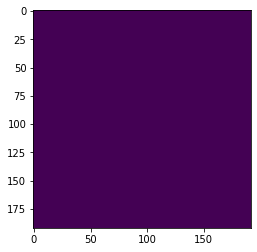

X_test 46


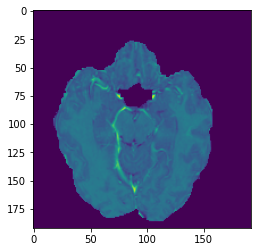

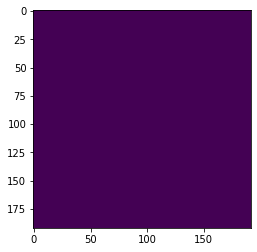

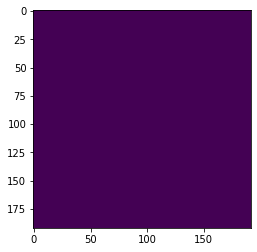

X_test 47


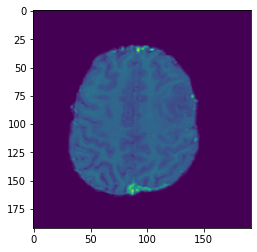

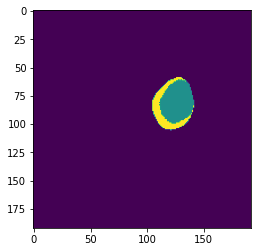

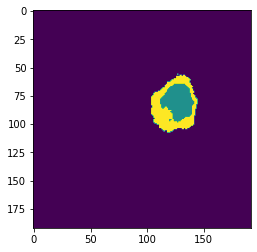

X_test 48


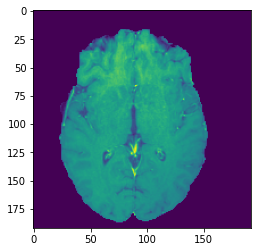

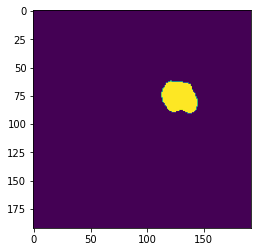

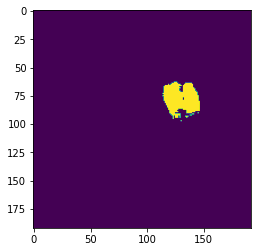

X_test 49


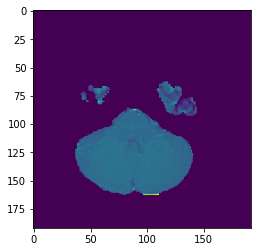

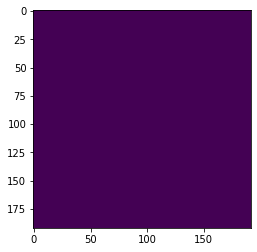

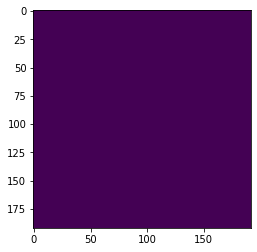

X_test 50


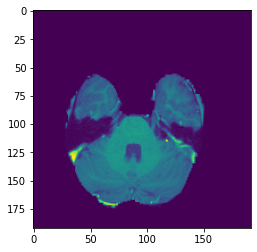

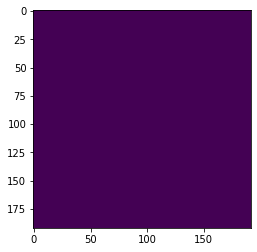

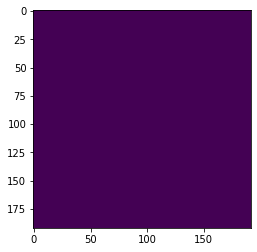

X_test 51


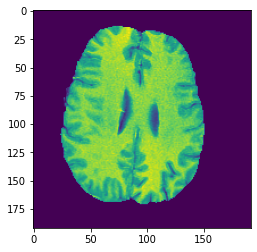

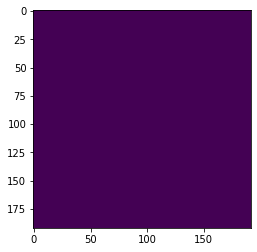

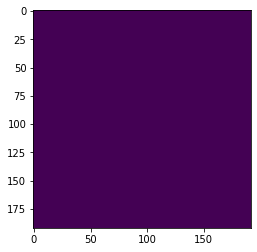

X_test 52


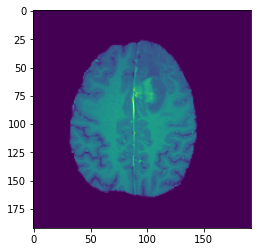

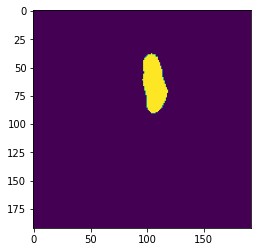

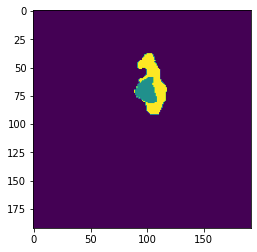

X_test 53


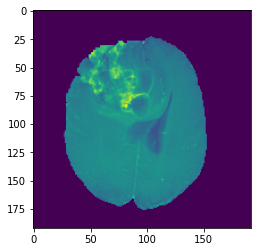

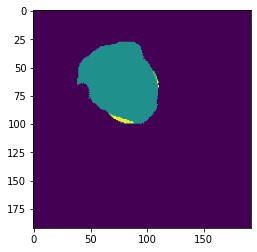

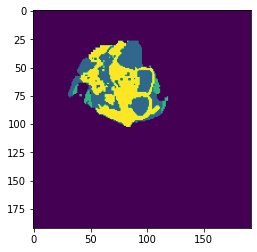

X_test 54


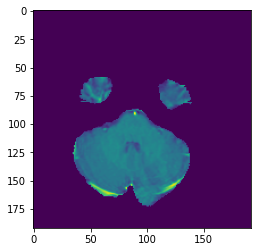

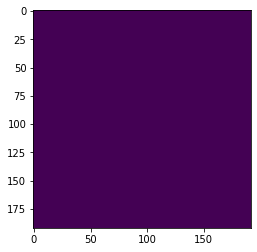

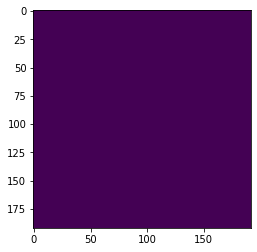

X_test 55


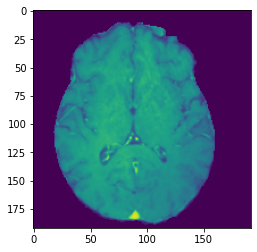

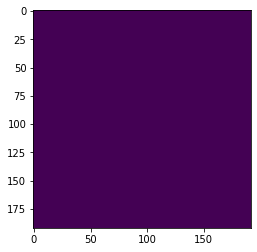

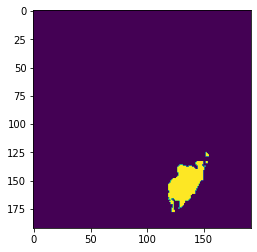

X_test 56


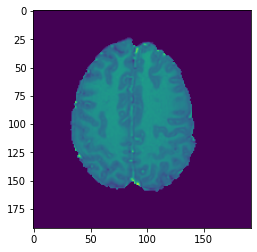

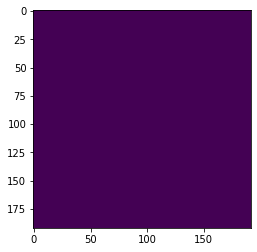

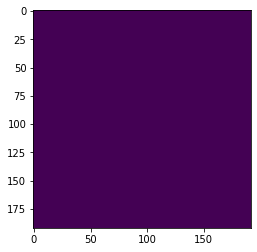

X_test 57


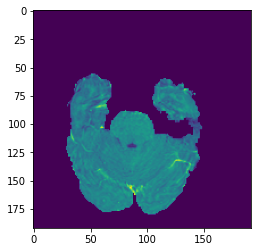

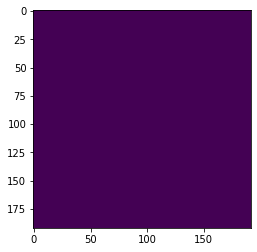

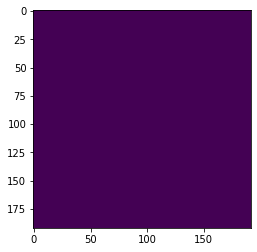

X_test 58


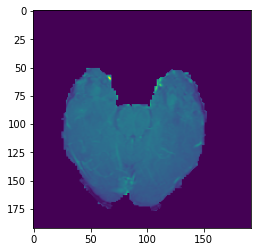

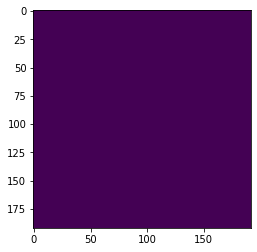

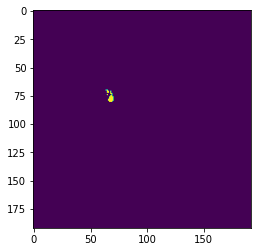

X_test 59


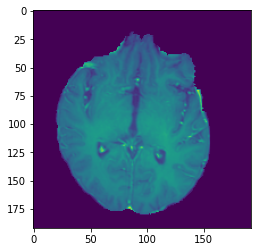

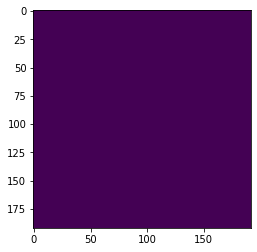

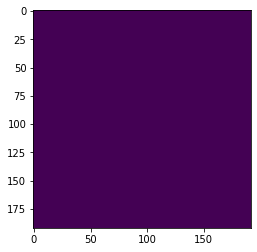

X_test 60


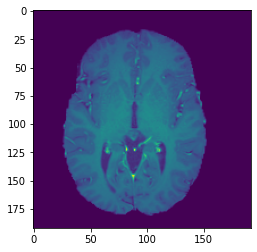

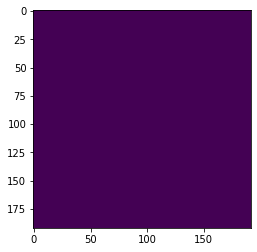

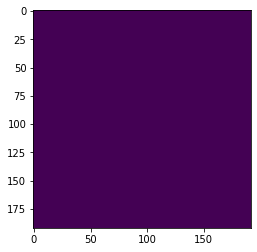

X_test 61


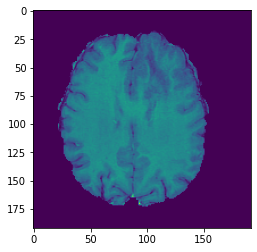

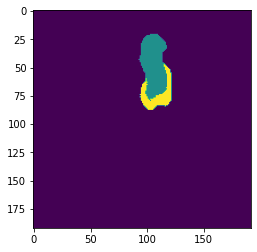

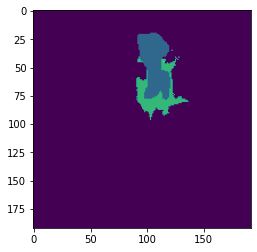

X_test 62


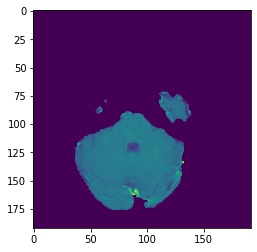

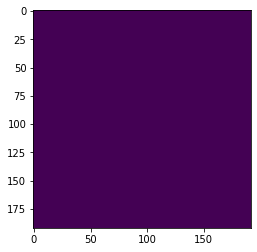

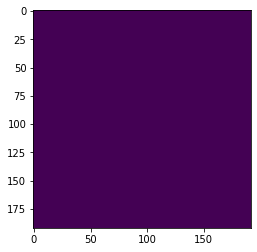

X_test 63


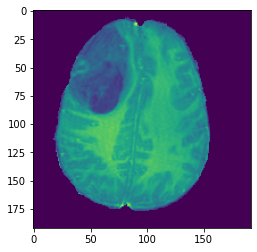

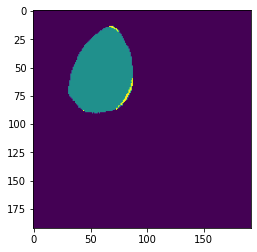

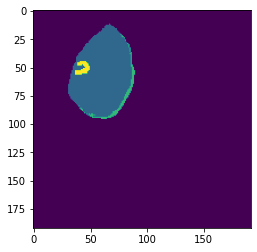

X_test 64


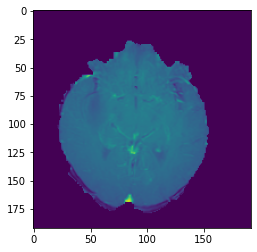

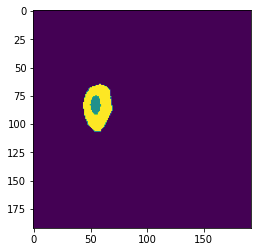

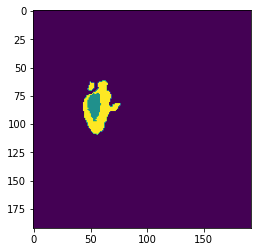

X_test 65


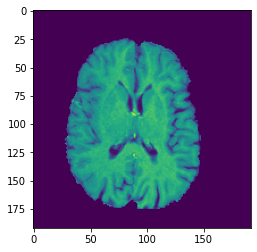

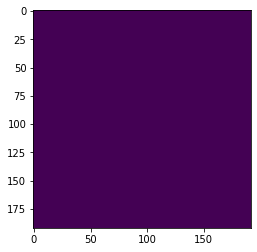

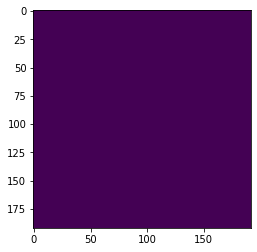

X_test 66


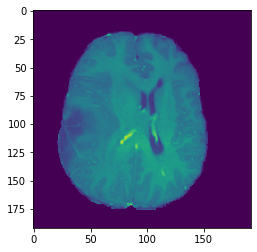

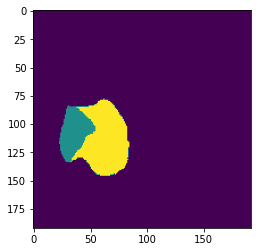

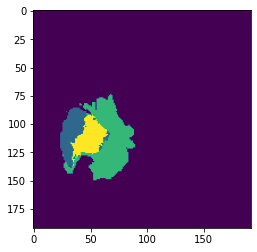

X_test 67


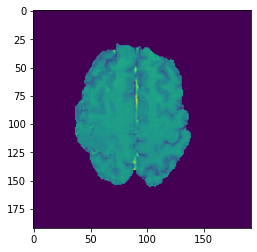

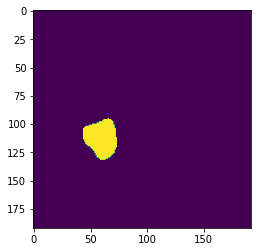

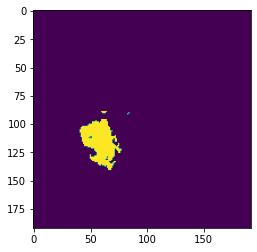

X_test 68


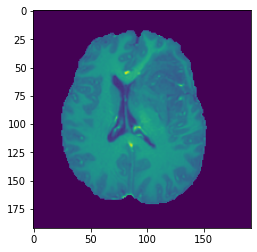

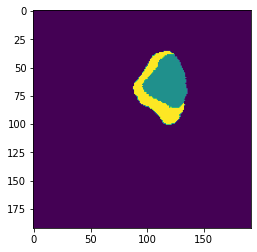

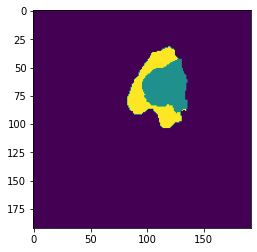

X_test 69


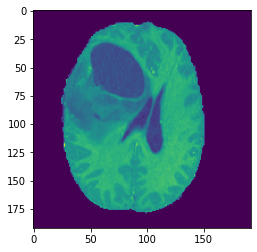

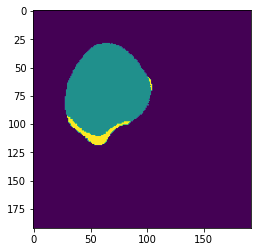

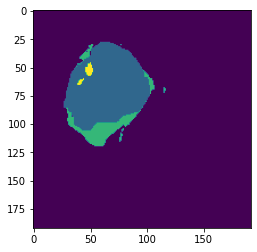

X_test 70


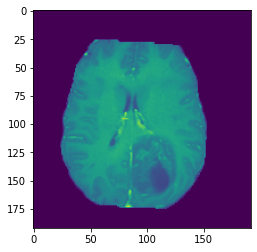

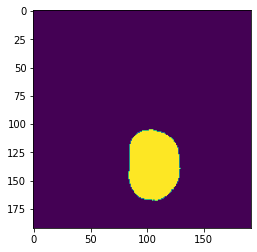

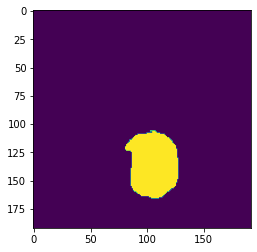

X_test 71


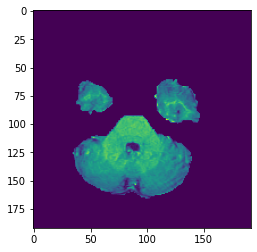

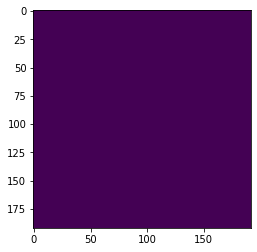

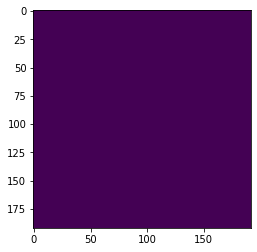

X_test 72


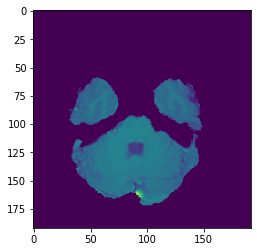

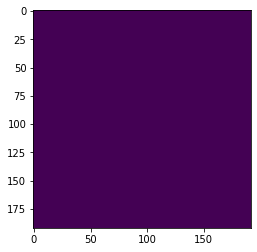

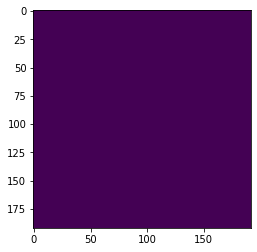

X_test 73


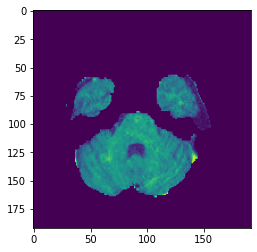

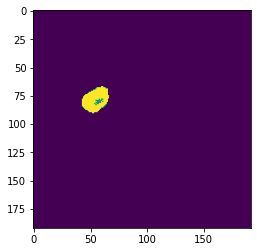

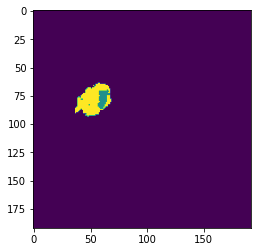

X_test 74


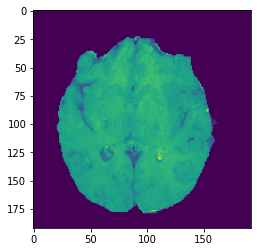

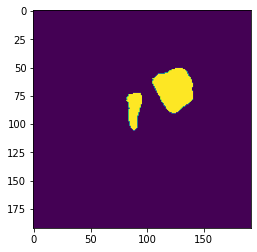

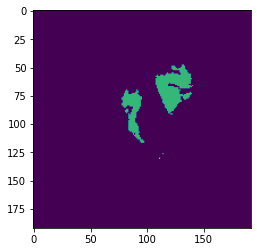

X_test 75


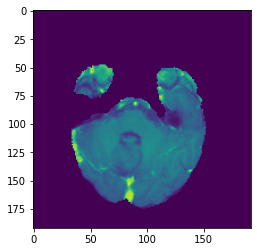

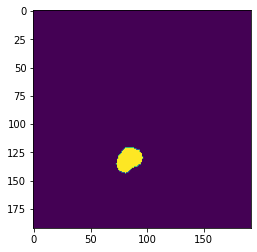

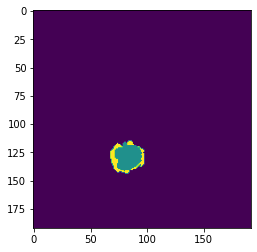

X_test 76


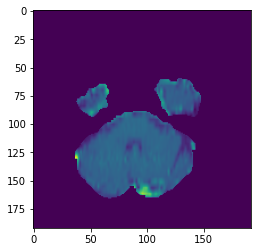

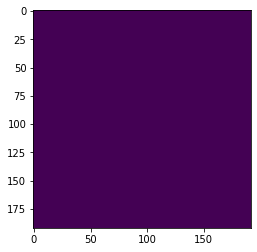

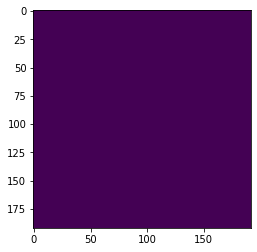

X_test 77


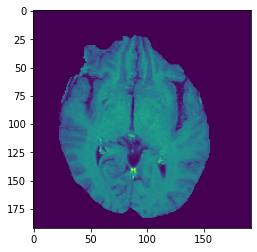

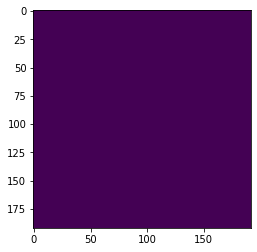

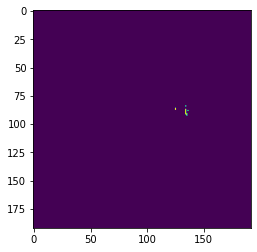

X_test 78


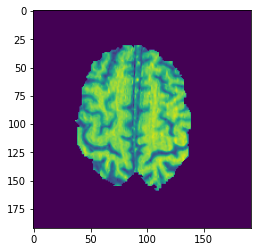

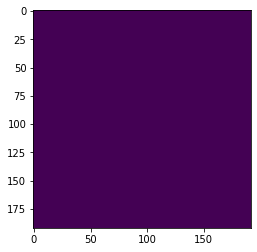

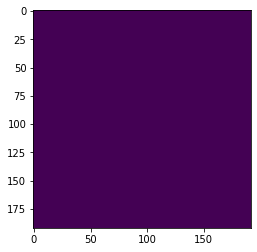

X_test 79


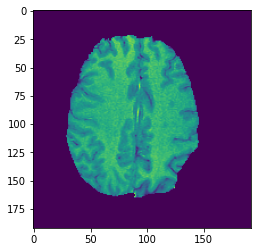

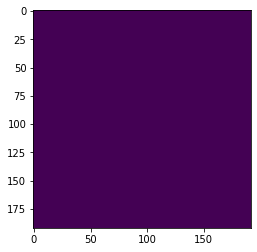

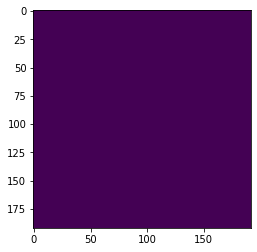

X_test 80


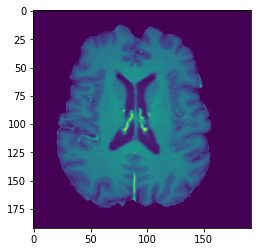

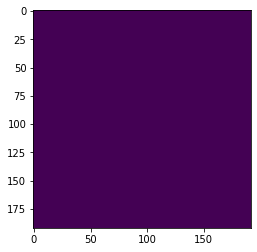

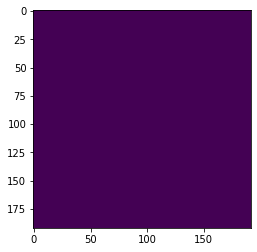

X_test 81


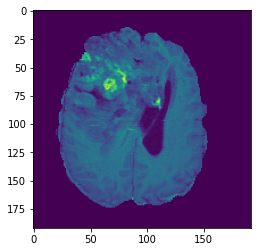

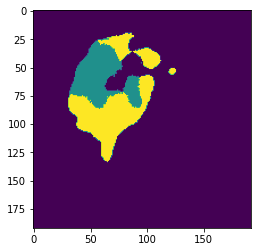

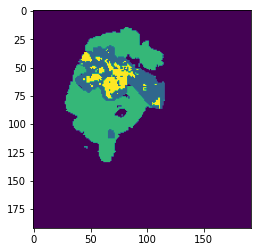

X_test 82


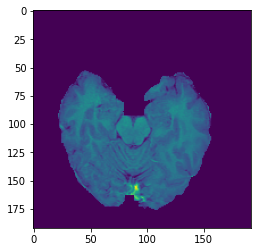

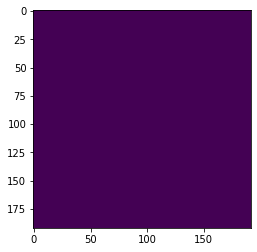

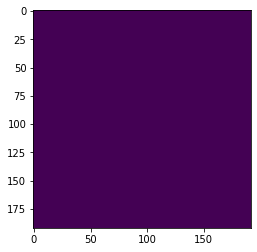

X_test 83


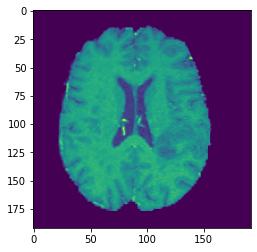

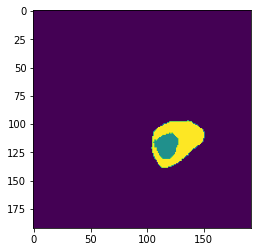

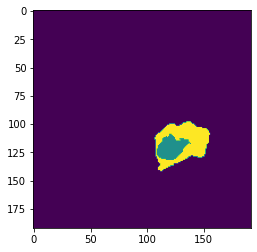

X_test 84


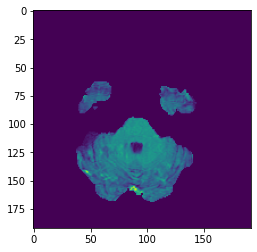

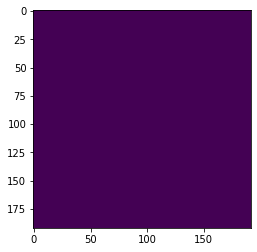

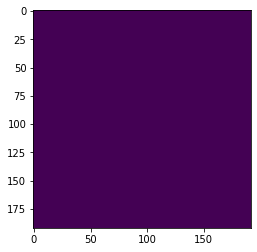

X_test 85


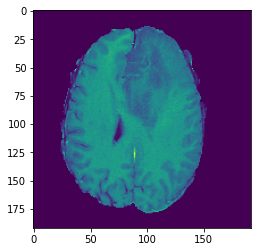

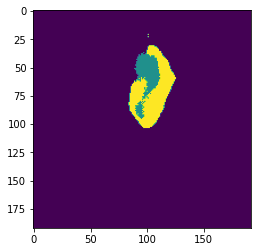

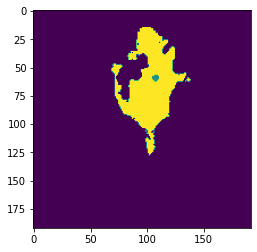

X_test 86


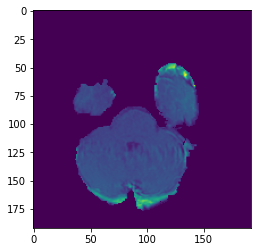

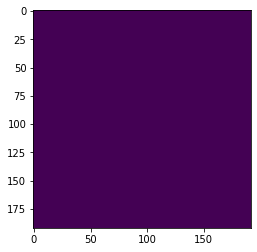

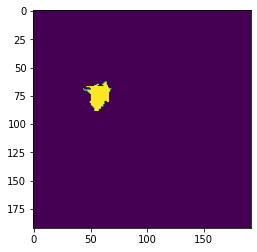

X_test 87


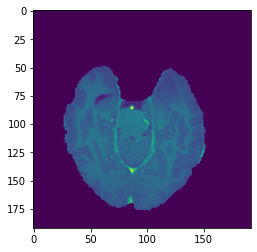

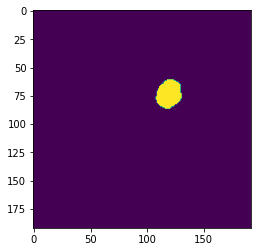

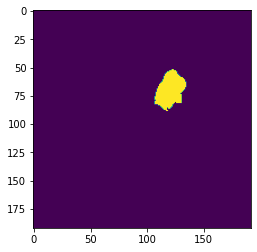

X_test 88


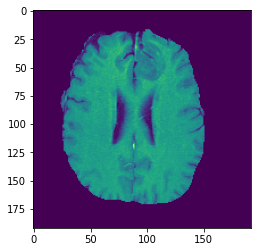

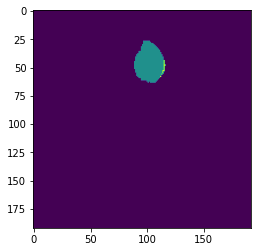

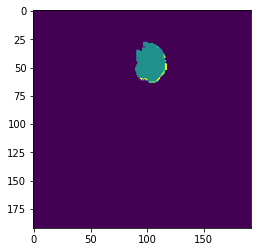

X_test 89


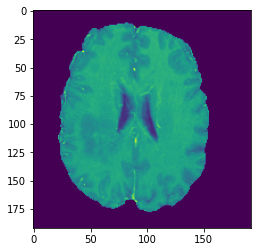

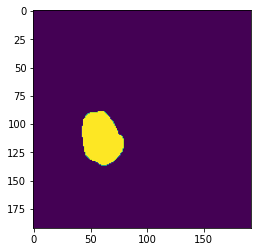

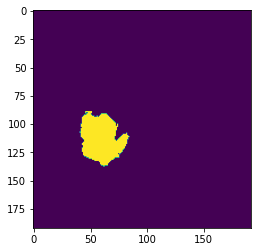

In [ ]:
for i in range(0,90):
  print('X_test '+ str(i))
  plt.imshow(X_test[i,:,:,2])
  plt.show()
  plt.imshow(Y_pre[i,:,:,0])
  plt.show()
  plt.imshow(Y_test[i,:,:,0])
  plt.show()

## UNet with 30 epoches


### Load model and training history data

In [ ]:
from tensorflow.keras.models import model_from_json
json_file = open('Model/unet30_model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
unet_model_30 = model_from_json(loaded_model_json)

unet_model_30.load_weights("Model/unet30_model.h5")
print("Loaded model from disk")


Loaded model from disk


In [ ]:
import pandas as pd 
history_30 = pd.read_csv("History/history30u.csv")
history_30.head()

,Unnamed: 0,loss,dice_coef,f1_m,precision_m,recall_m,val_loss,val_dice_coef,val_f1_m,val_precision_m,val_recall_m
0,0,0.009857,0.990143,0.989282,0.989667,0.988899,0.013657,0.986343,0.985328,0.985615,0.985041
1,1,0.009534,0.990467,0.989605,0.989985,0.989225,0.012489,0.987512,0.986495,0.986807,0.986183
2,2,0.009323,0.990677,0.989899,0.990254,0.989545,0.011499,0.988502,0.987491,0.987773,0.987209
3,3,0.009128,0.990872,0.990040,0.990372,0.989707,0.011704,0.988296,0.987298,0.987584,0.987013
4,4,0.008937,0.991063,0.990295,0.990622,0.989968,0.011482,0.988519,0.987523,0.987822,0.987225


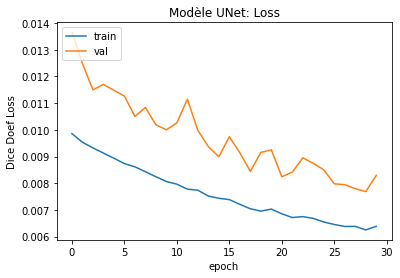

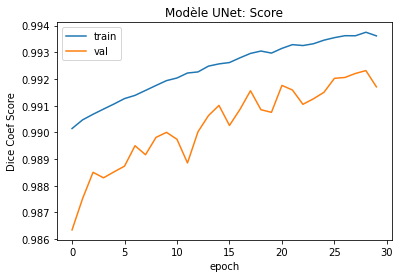

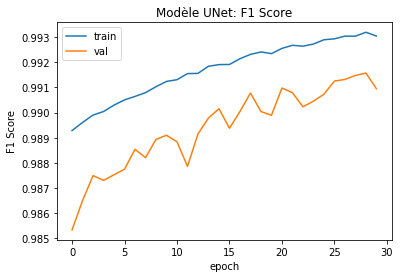

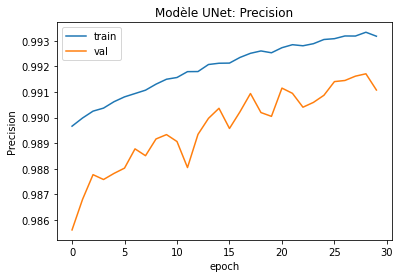

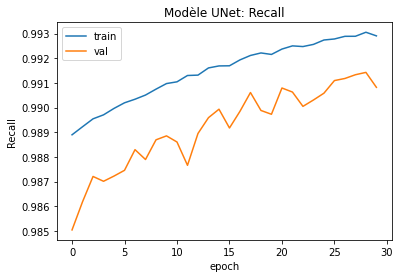

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history_30['loss'])
plt.plot(history_30['val_loss'])
plt.title('Modèle UNet: Loss')
plt.ylabel('Dice Doef Loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Loss.png")
plt.plot(history_30['dice_coef'])
plt.plot(history_30['val_dice_coef'])
plt.title('Modèle UNet: Score')
plt.ylabel('Dice Coef Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Score.png")
plt.plot(history_30['f1_m'])
plt.plot(history_30['val_f1_m'])
plt.title('Modèle UNet: F1 Score')
plt.ylabel('F1 Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_F1_Score.png")
plt.plot(history_30['precision_m'])
plt.plot(history_30['val_precision_m'])
plt.title('Modèle UNet: Precision')
plt.ylabel('Precision')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Precision.png")
plt.plot(history_30['recall_m'])
plt.plot(history_30['val_recall_m'])
plt.title('Modèle UNet: Recall')
plt.ylabel('Recall')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Recall.png")

In [ ]:
unet_model_30.compile(optimizer=Adam(lr=1e-5),loss=dice_coef_loss,metrics=[dice_coef,f1_m,precision_m, recall_m])

In [ ]:
loss,score,f1_score,precision,recall = unet_model_30.evaluate(X_test,Y_test_encod,verbose=0)

In [ ]:
print("Loss = ",loss,"Score= ",score,"F1-Score= ",f1_score,"Precision= ",precision,"Recall= ",recall)

Loss =  0.006835196842575631 Score=  0.993165 F1-Score=  0.99250275 Precision=  0.9926243 Recall=  0.99238145


In [ ]:
Y_pre = np.argmax(unet_model_30.predict(X_test),axis=-1)

In [ ]:
np.unique(Y_pre)

array([0, 1, 2])

In [ ]:
Y_pre=Y_pre.reshape(-1,192,192,1)

X_test 0


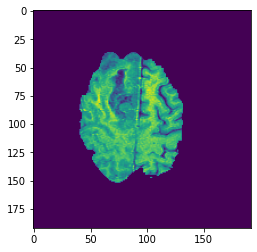

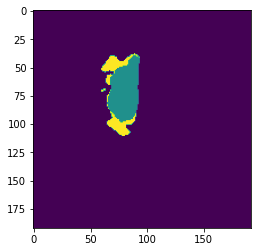

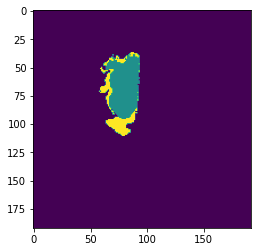

X_test 1


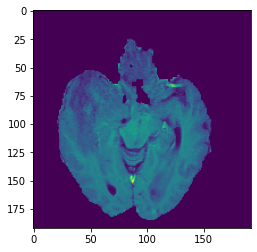

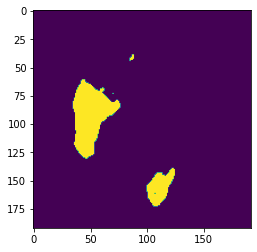

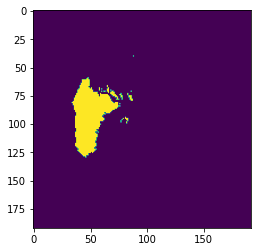

X_test 2


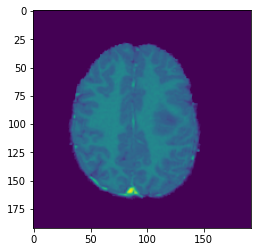

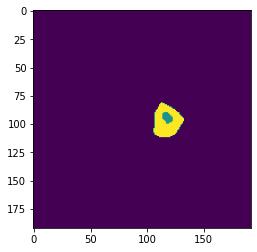

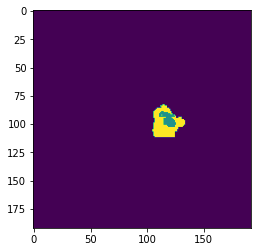

X_test 3


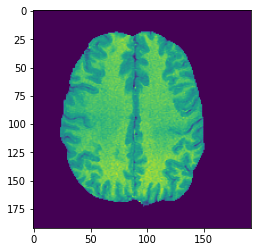

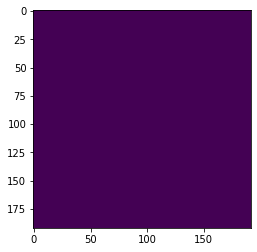

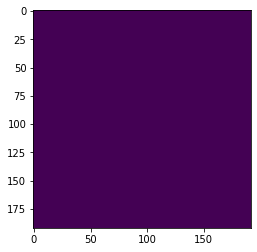

X_test 4


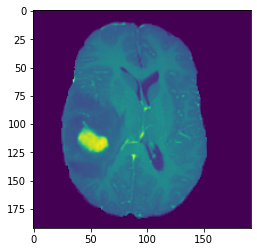

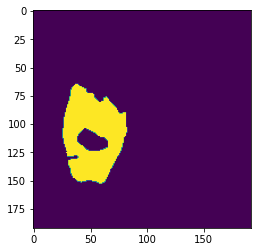

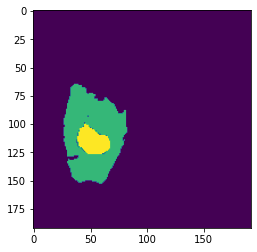

X_test 5


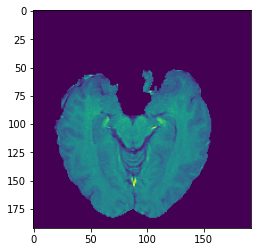

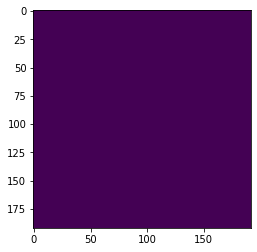

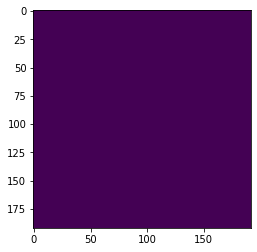

X_test 6


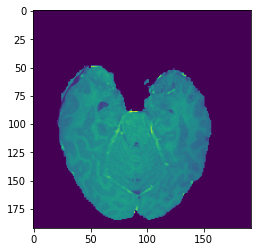

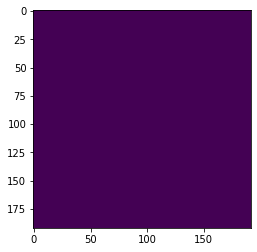

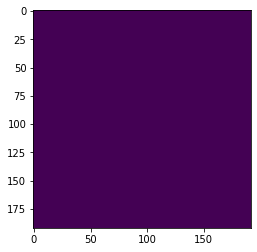

X_test 7


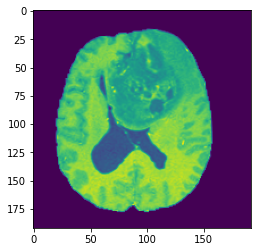

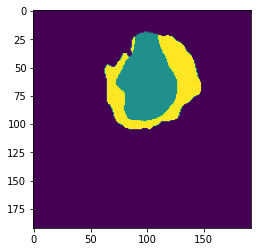

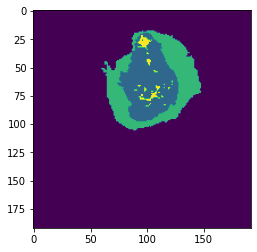

X_test 8


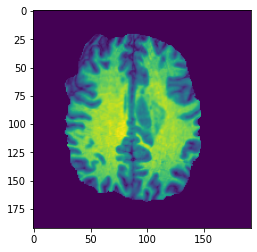

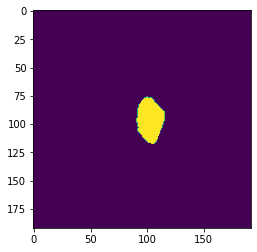

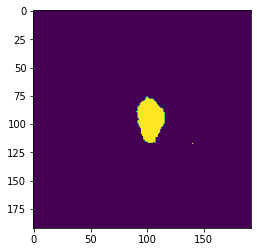

X_test 9


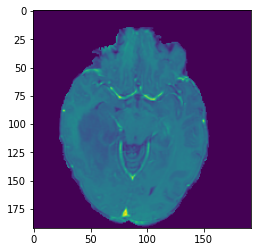

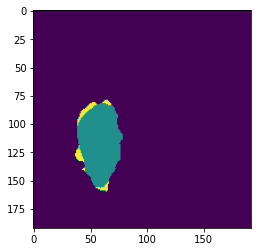

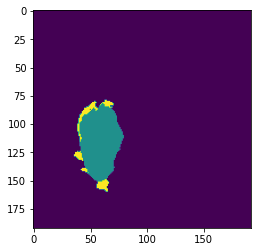

X_test 10


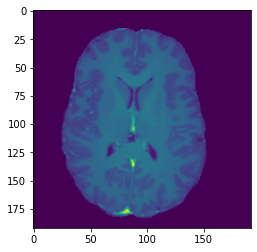

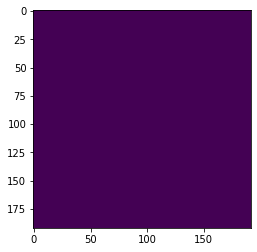

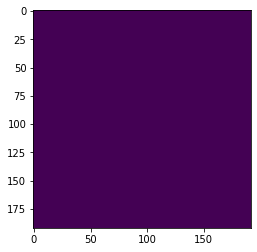

X_test 11


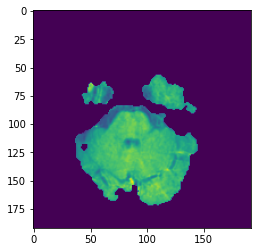

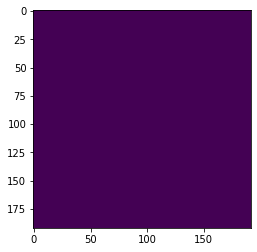

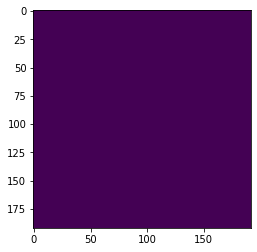

X_test 12


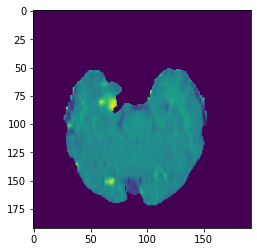

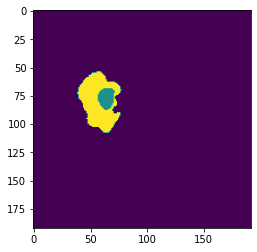

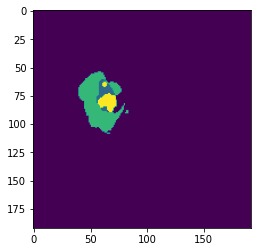

X_test 13


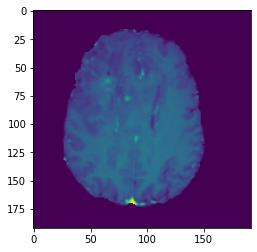

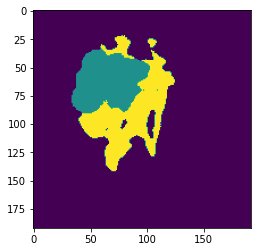

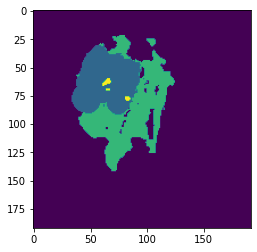

X_test 14


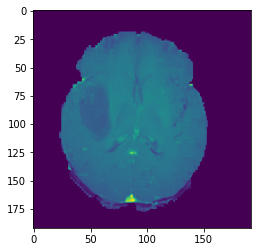

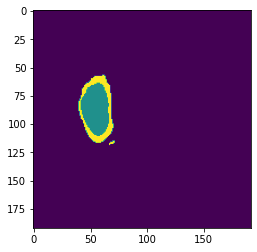

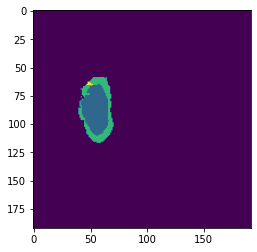

X_test 15


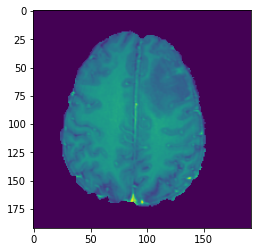

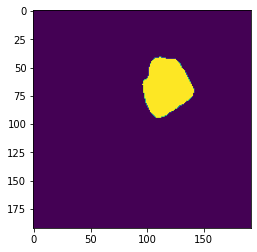

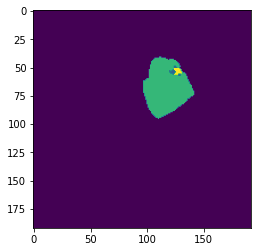

X_test 16


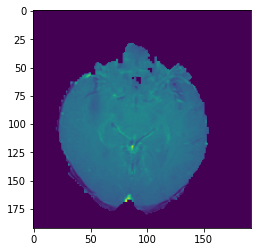

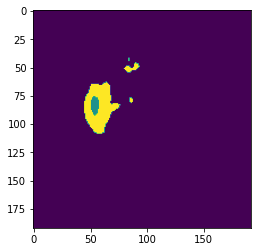

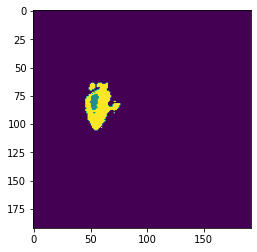

X_test 17


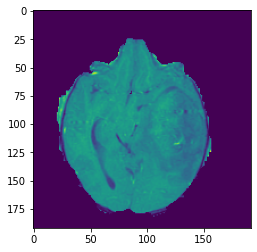

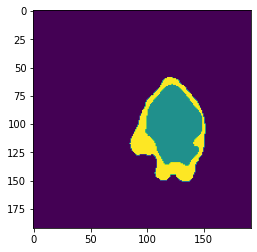

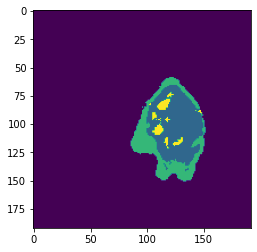

X_test 18


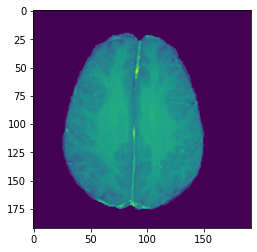

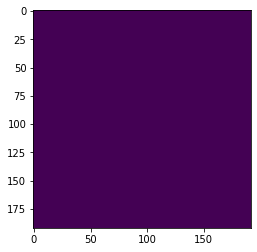

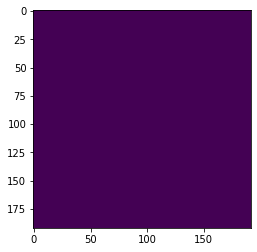

X_test 19


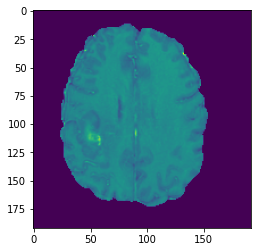

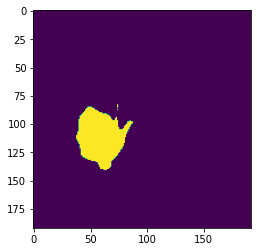

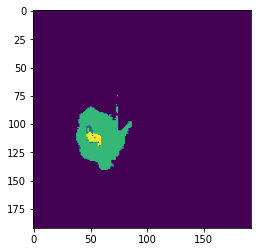

X_test 20


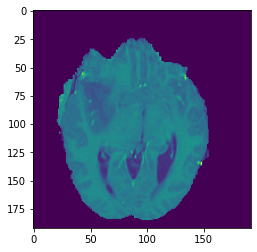

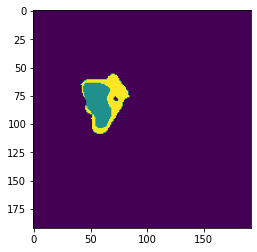

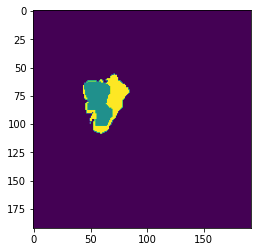

X_test 21


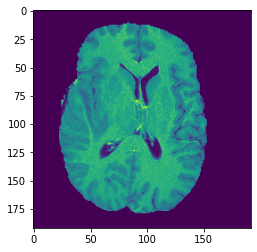

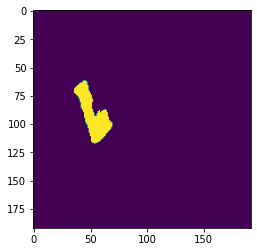

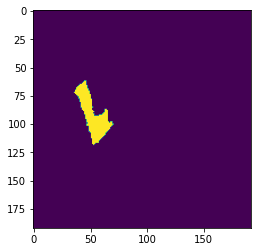

X_test 22


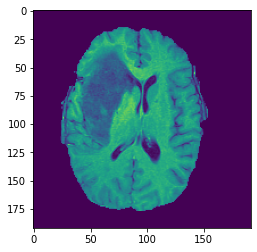

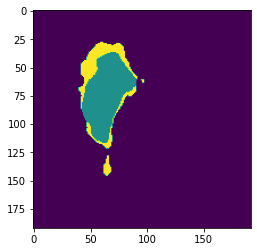

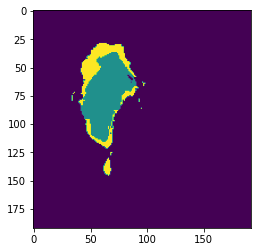

X_test 23


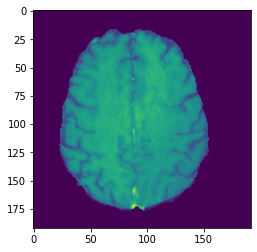

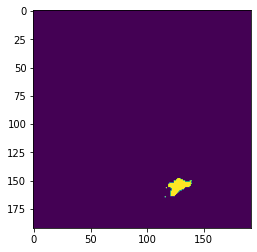

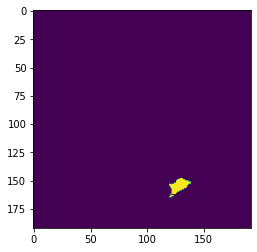

X_test 24


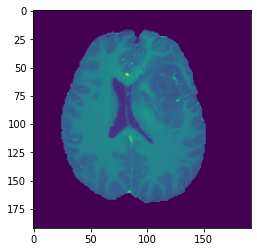

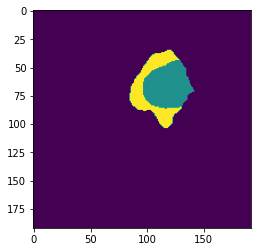

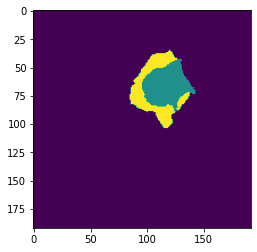

X_test 25


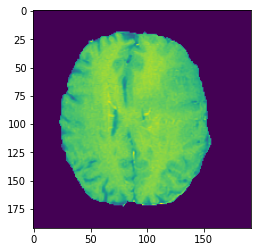

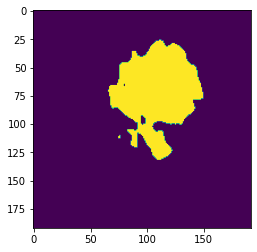

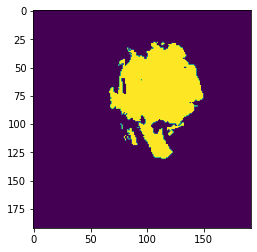

X_test 26


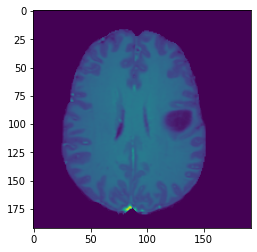

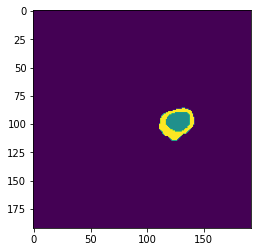

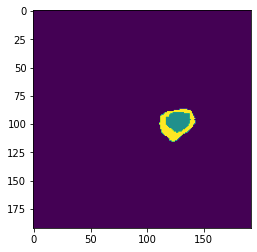

X_test 27


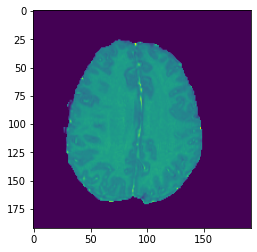

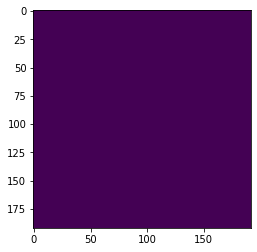

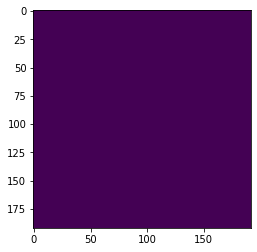

X_test 28


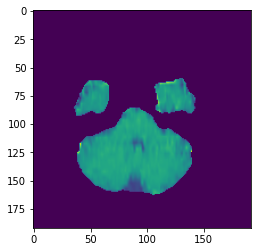

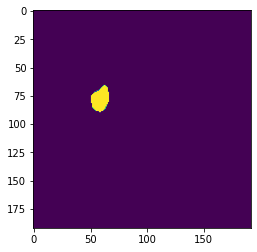

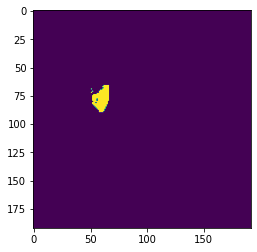

X_test 29


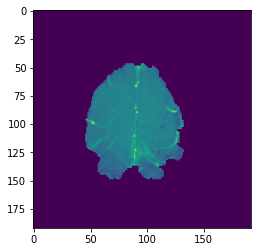

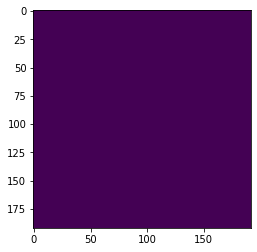

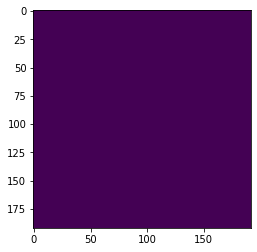

X_test 30


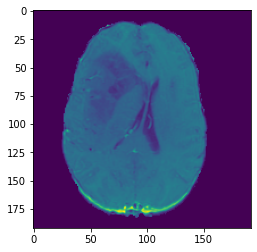

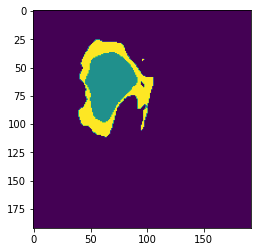

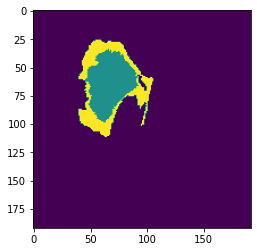

X_test 31


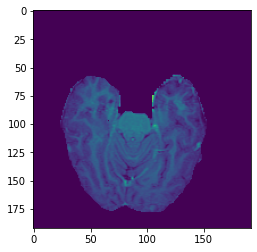

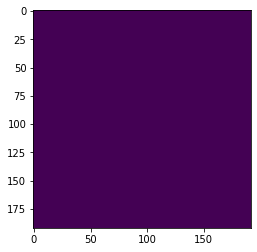

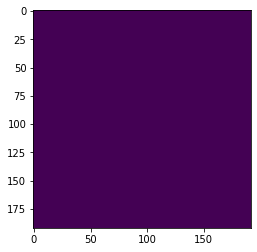

X_test 32


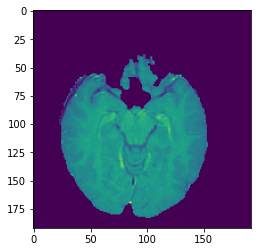

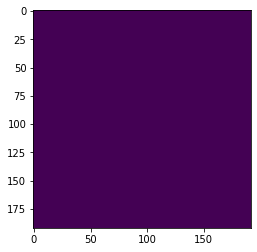

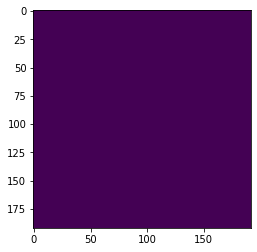

X_test 33


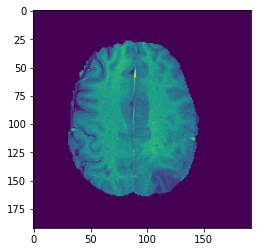

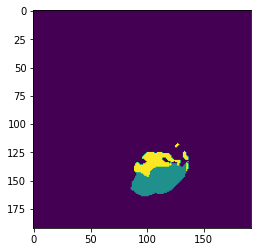

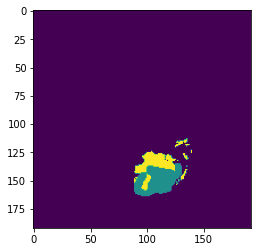

X_test 34


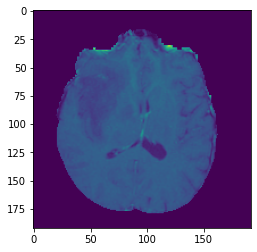

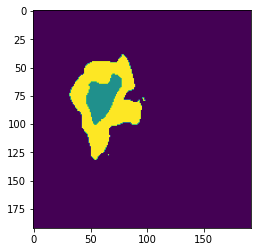

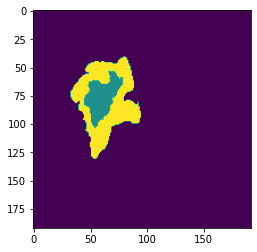

X_test 35


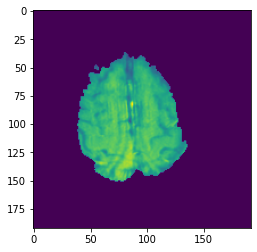

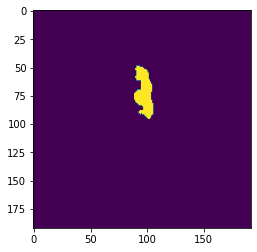

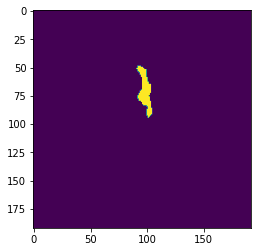

X_test 36


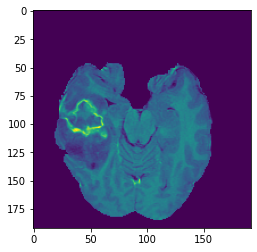

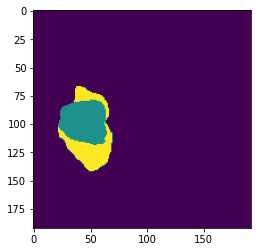

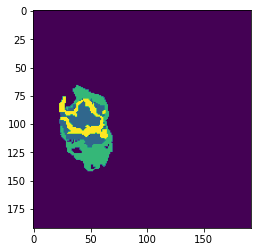

X_test 37


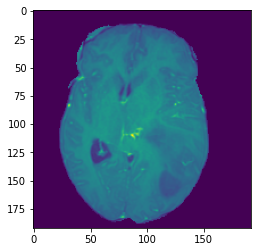

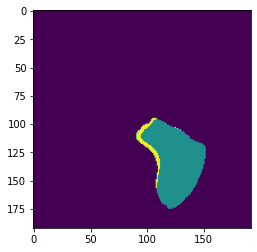

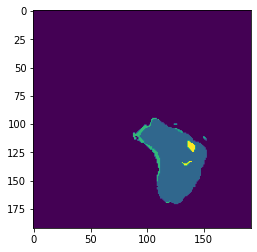

X_test 38


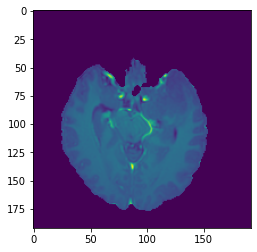

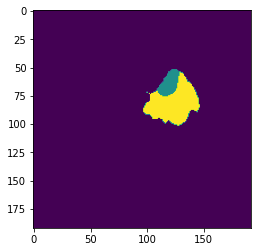

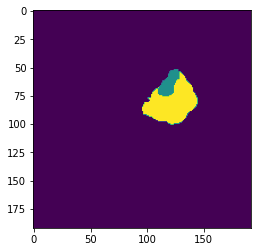

X_test 39


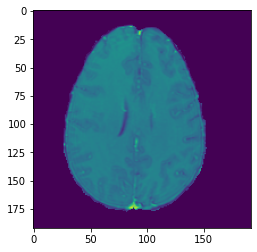

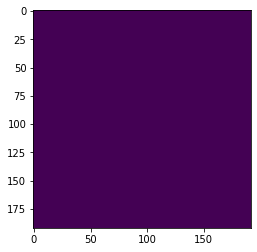

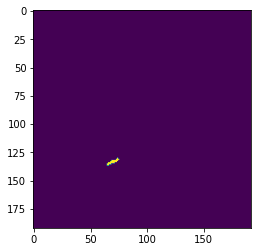

X_test 40


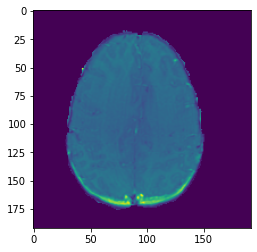

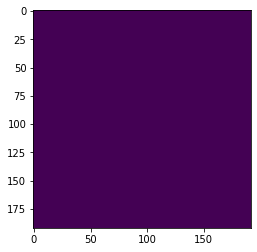

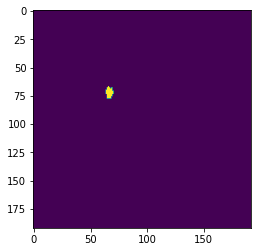

X_test 41


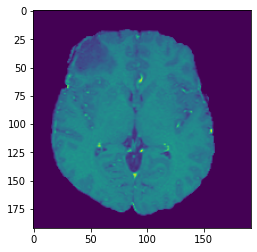

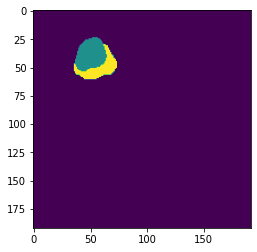

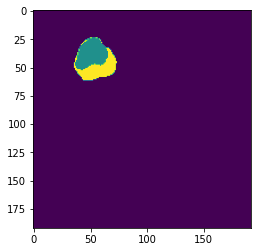

X_test 42


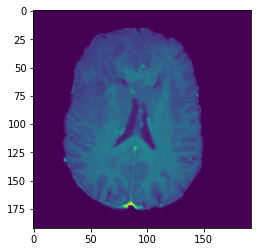

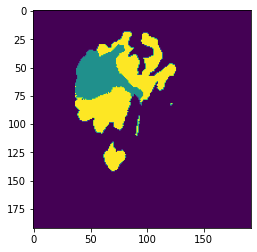

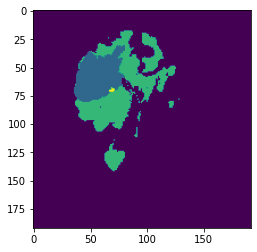

X_test 43


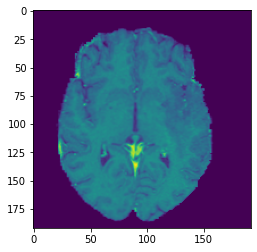

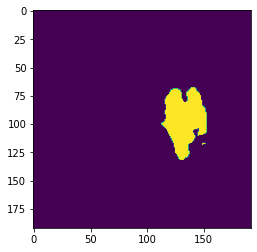

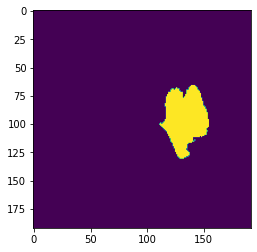

X_test 44


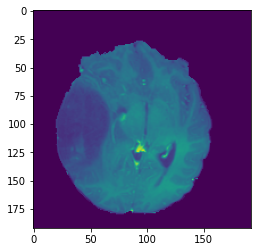

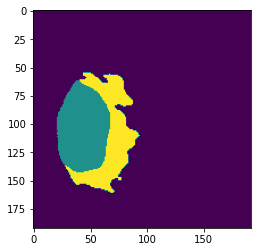

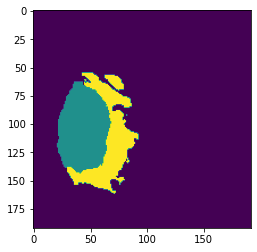

X_test 45


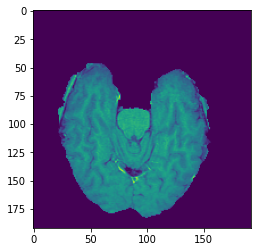

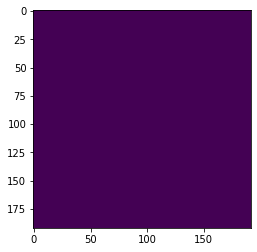

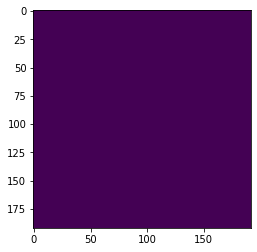

X_test 46


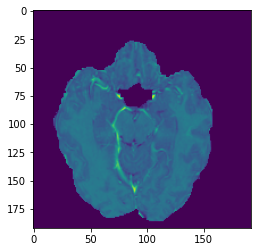

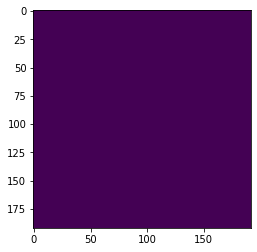

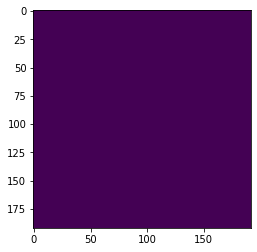

X_test 47


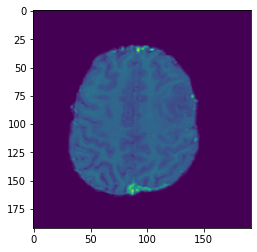

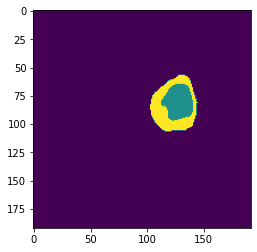

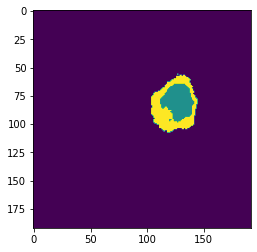

X_test 48


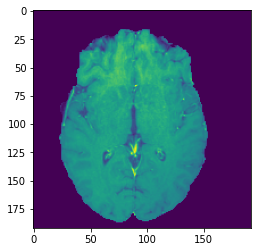

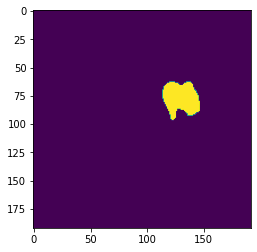

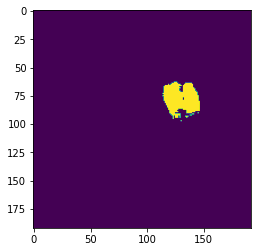

X_test 49


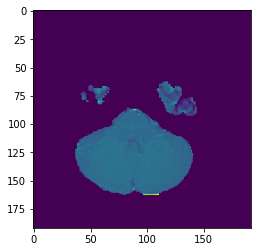

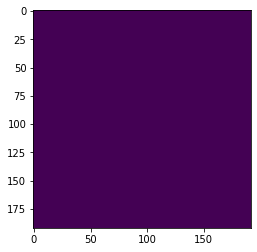

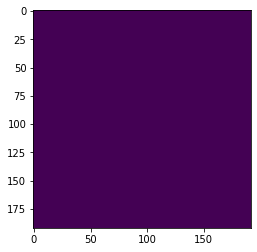

X_test 50


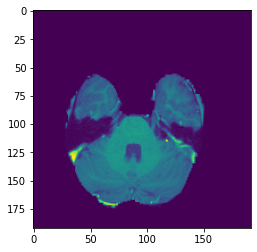

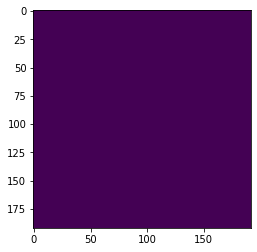

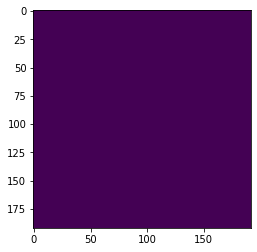

X_test 51


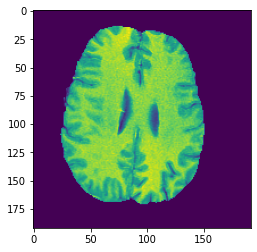

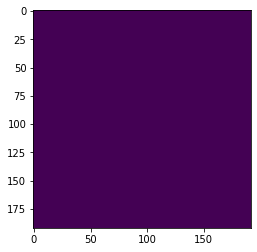

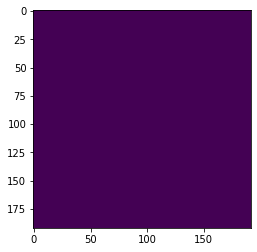

X_test 52


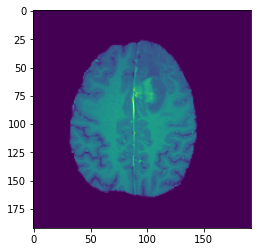

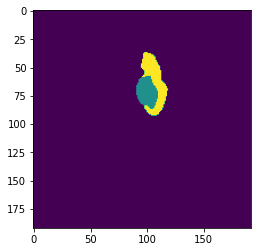

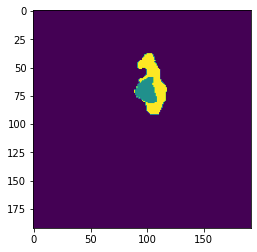

X_test 53


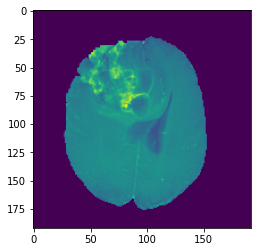

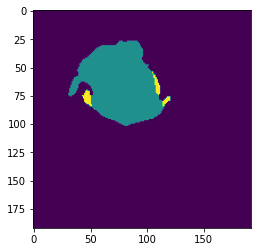

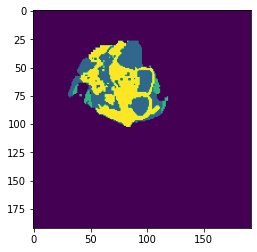

X_test 54


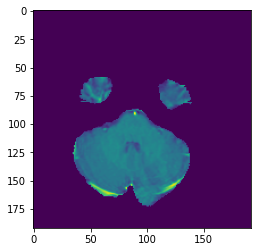

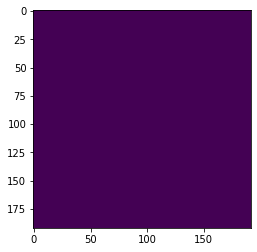

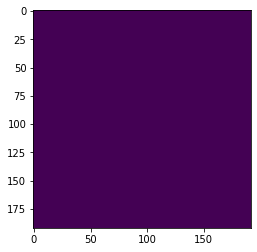

X_test 55


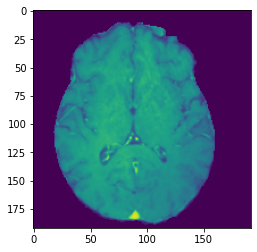

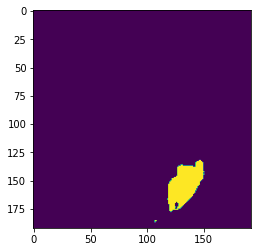

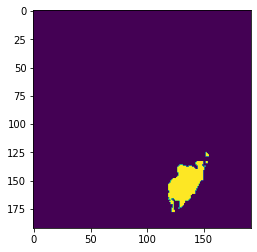

X_test 56


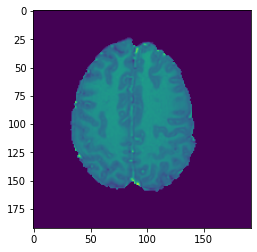

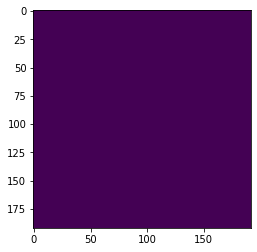

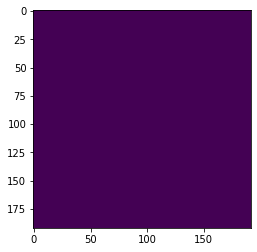

X_test 57


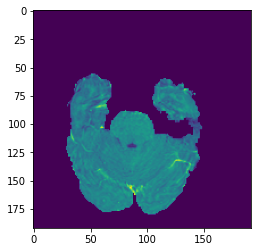

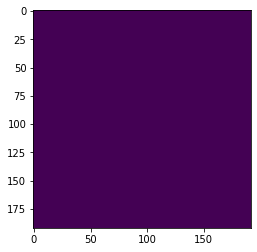

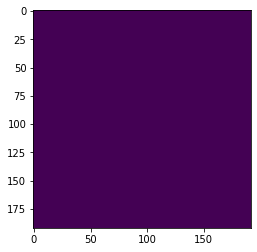

X_test 58


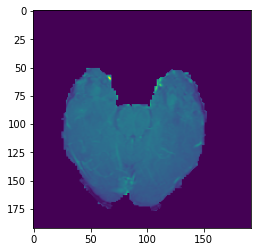

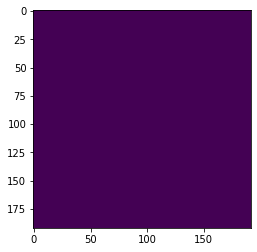

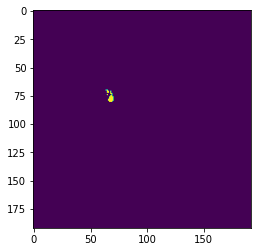

X_test 59


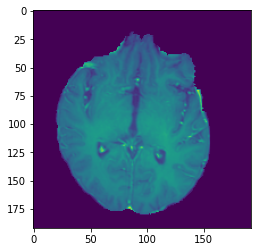

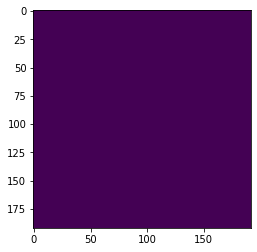

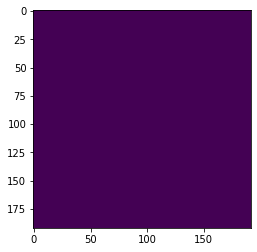

X_test 60


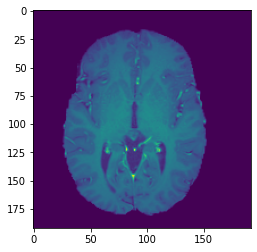

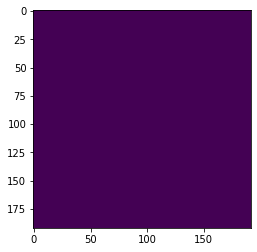

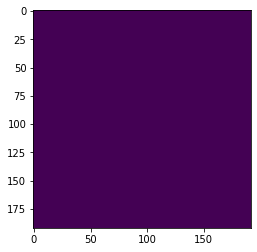

X_test 61


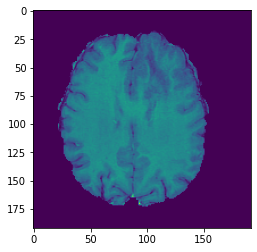

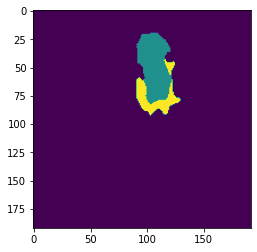

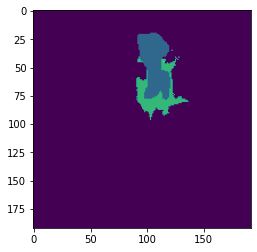

X_test 62


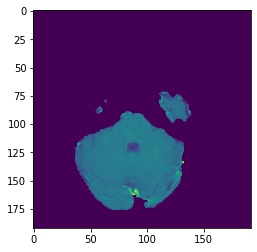

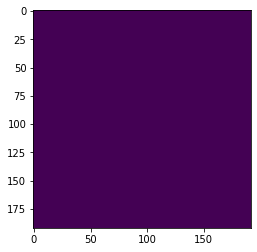

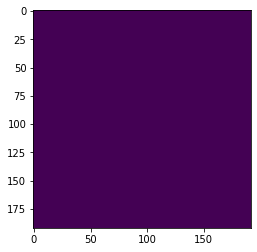

X_test 63


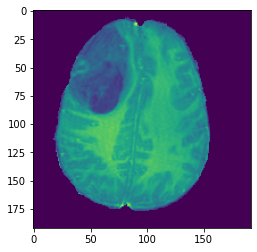

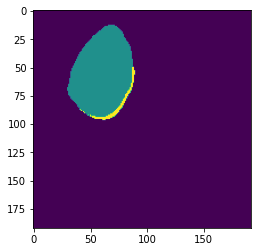

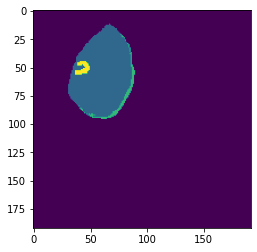

X_test 64


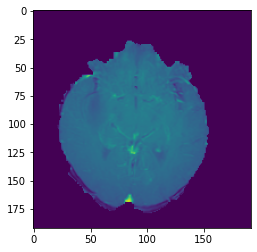

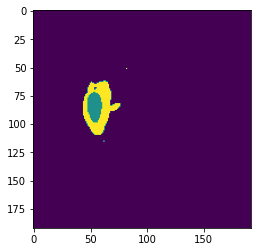

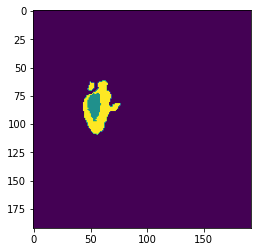

X_test 65


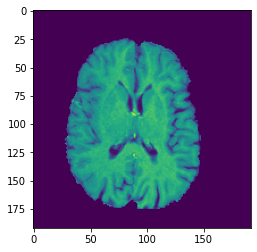

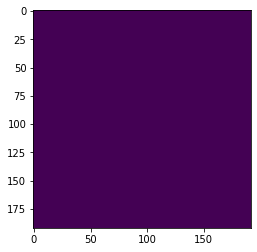

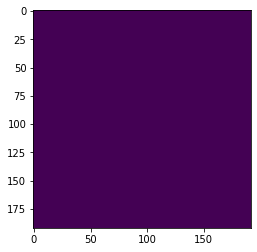

X_test 66


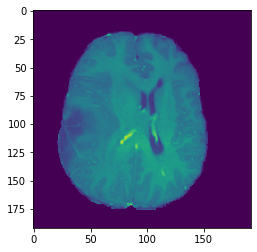

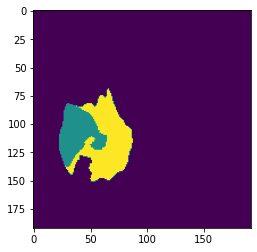

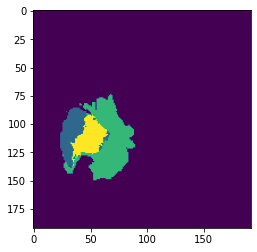

X_test 67


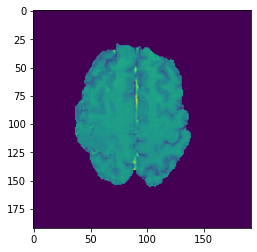

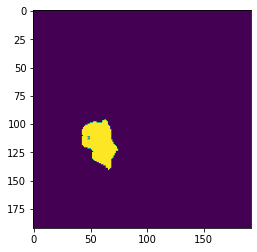

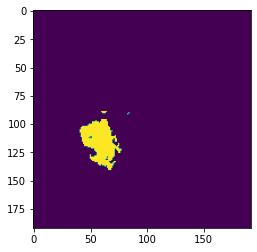

X_test 68


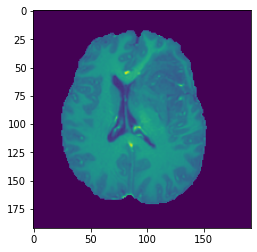

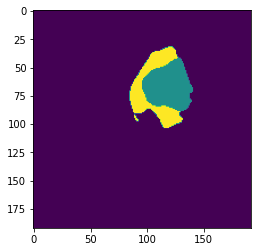

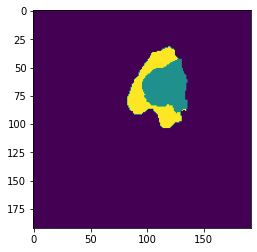

X_test 69


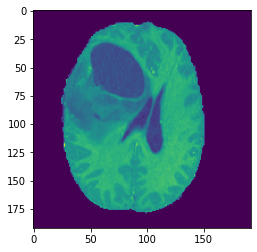

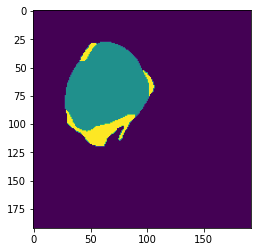

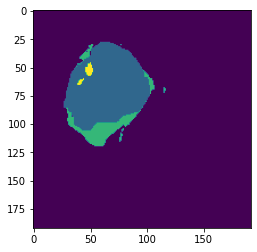

X_test 70


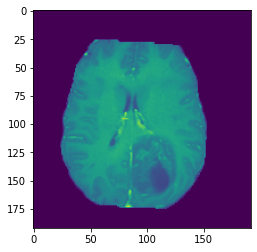

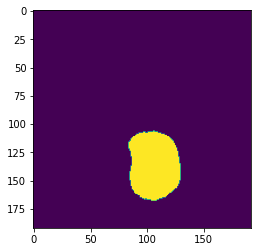

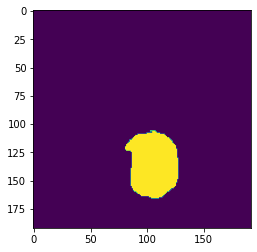

X_test 71


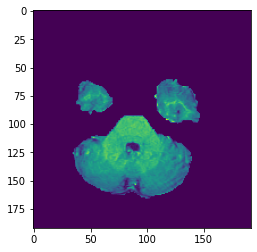

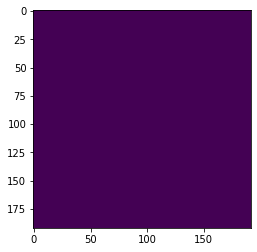

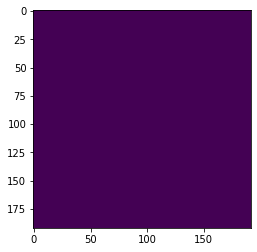

X_test 72


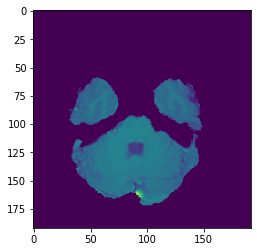

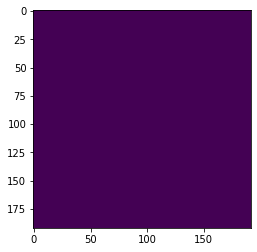

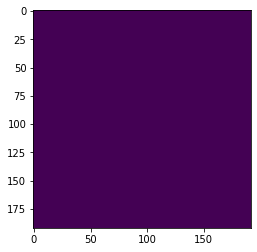

X_test 73


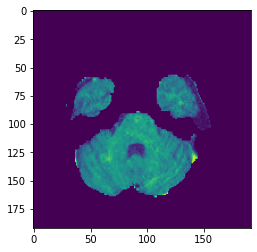

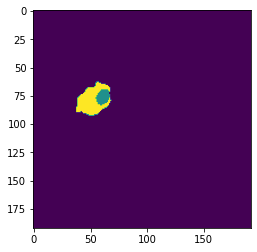

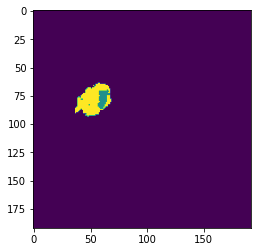

X_test 74


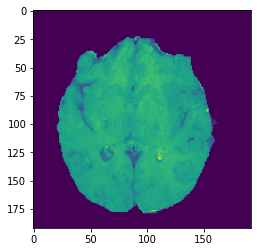

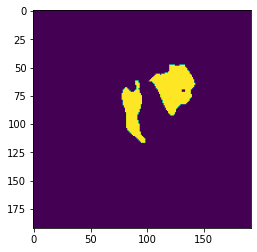

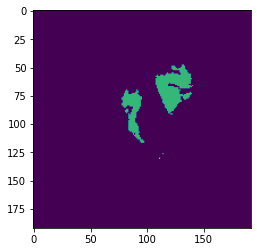

X_test 75


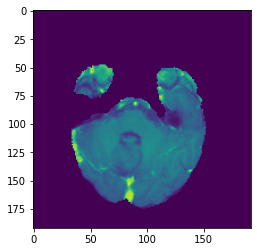

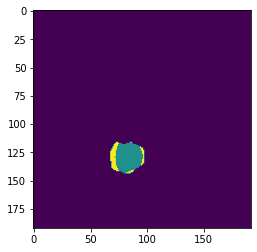

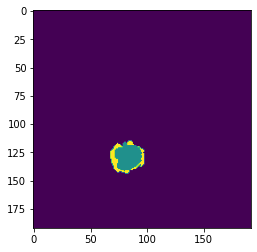

X_test 76


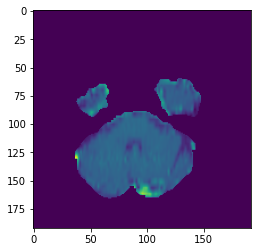

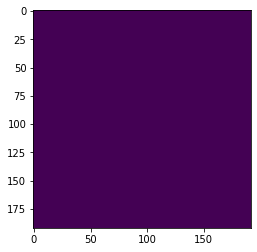

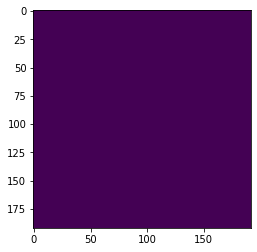

X_test 77


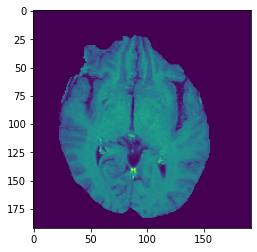

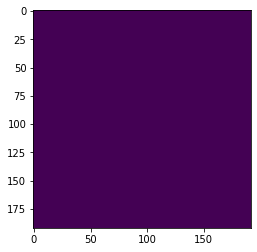

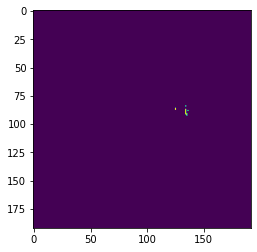

X_test 78


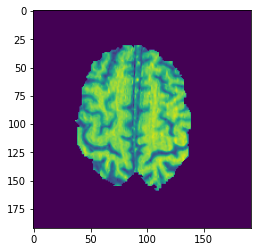

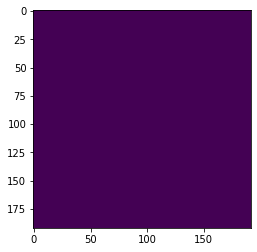

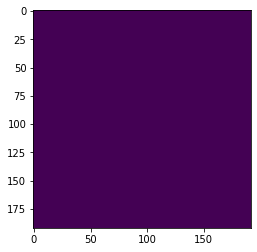

X_test 79


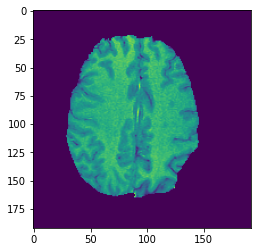

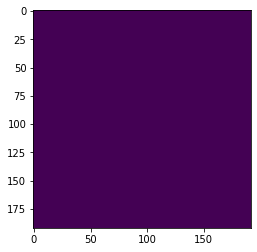

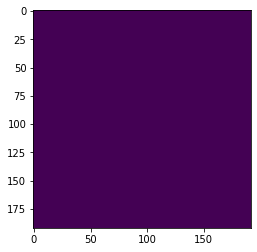

X_test 80


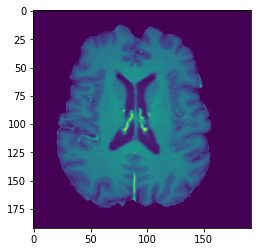

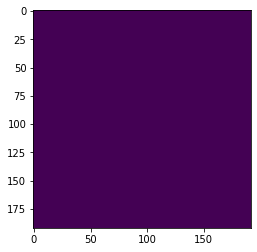

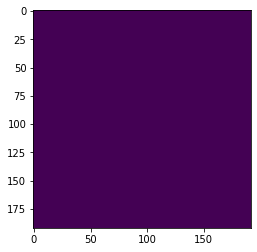

X_test 81


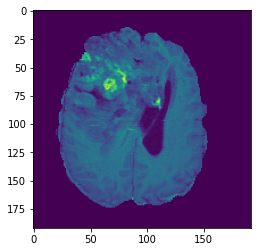

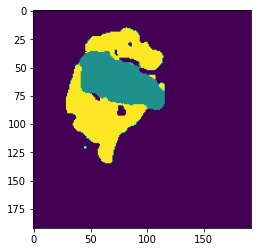

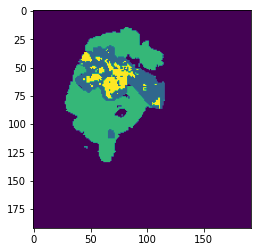

X_test 82


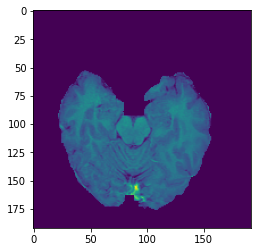

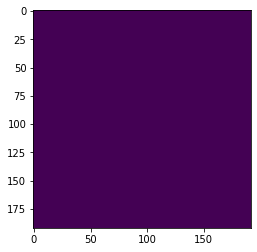

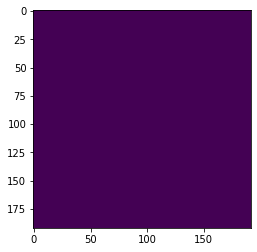

X_test 83


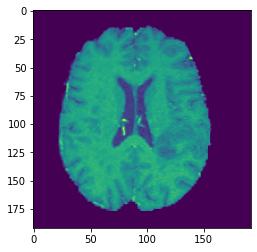

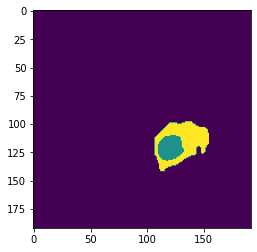

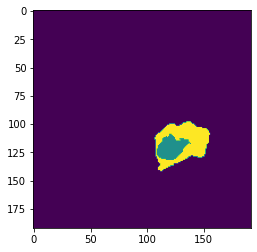

X_test 84


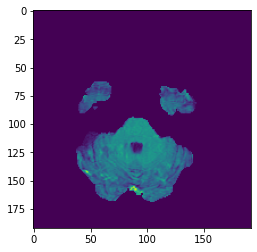

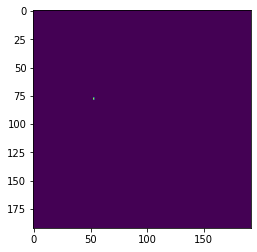

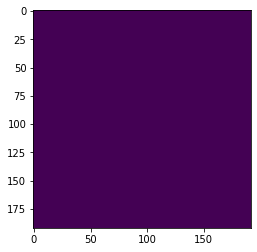

X_test 85


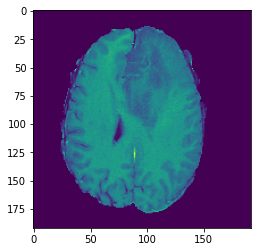

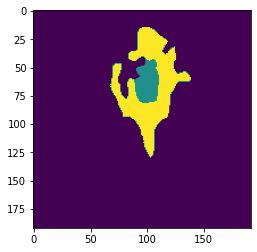

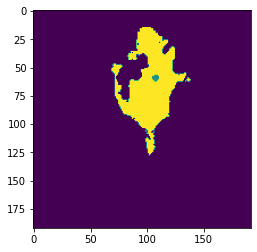

X_test 86


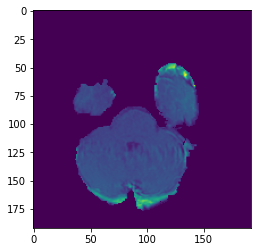

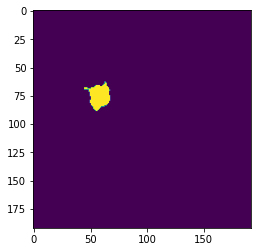

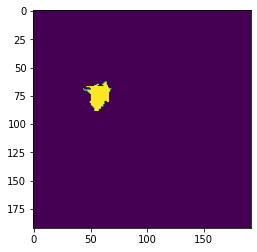

X_test 87


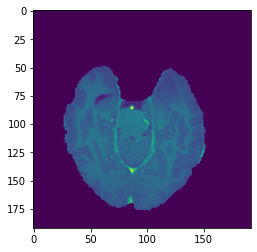

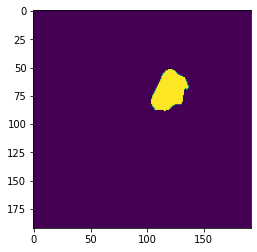

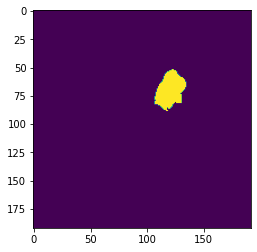

X_test 88


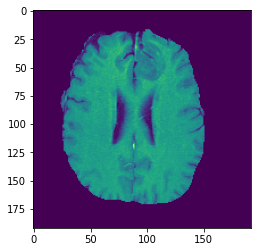

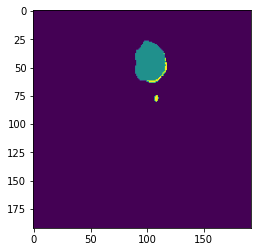

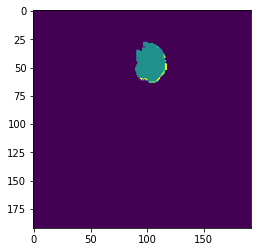

X_test 89


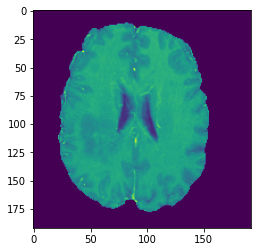

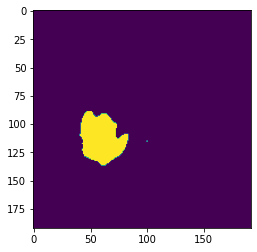

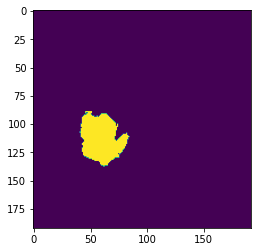

In [ ]:
for i in range(0,90):
  print('X_test '+ str(i))
  plt.imshow(X_test[i,:,:,2])
  plt.show()
  plt.imshow(Y_pre[i,:,:,0])
  plt.show()
  plt.imshow(Y_test[i,:,:,0])
  plt.show()

## UNet with 50 epoches


### Load model and training history data

In [ ]:
from tensorflow.keras.models import model_from_json
json_file = open('Model/unet50_model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
unet_model_50 = model_from_json(loaded_model_json)

unet_model_50.load_weights("Model/unet50_model.h5")
print("Loaded model from disk")


Loaded model from disk


In [ ]:
import pandas as pd 
history_50 = pd.read_csv("History/history50u.csv")
history_50.head()

,Unnamed: 0,loss,dice_coef,f1_m,precision_m,recall_m,val_loss,val_dice_coef,val_f1_m,val_precision_m,val_recall_m
0,0,0.006250,0.993750,0.993178,0.993318,0.993037,0.007626,0.992374,0.991622,0.991768,0.991476
1,1,0.006249,0.993751,0.993158,0.993292,0.993023,0.007925,0.992075,0.991350,0.991486,0.991214
2,2,0.006054,0.993946,0.993402,0.993533,0.993271,0.007662,0.992338,0.991619,0.991756,0.991483
3,3,0.006189,0.993811,0.993242,0.993369,0.993115,0.008083,0.991917,0.991204,0.991331,0.991077
4,4,0.005981,0.994020,0.993516,0.993638,0.993394,0.008362,0.991638,0.990865,0.990990,0.990741


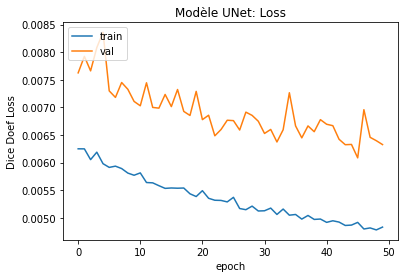

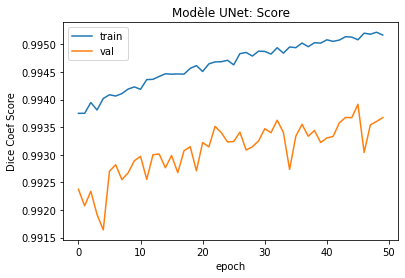

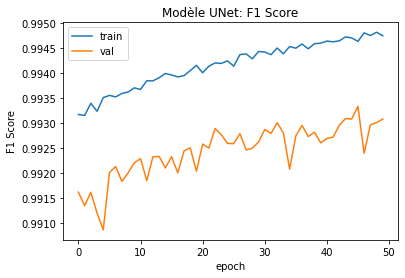

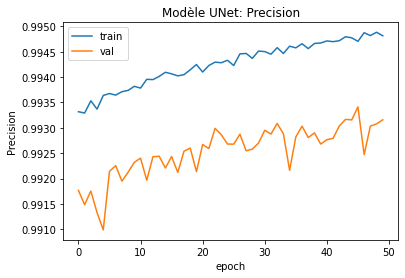

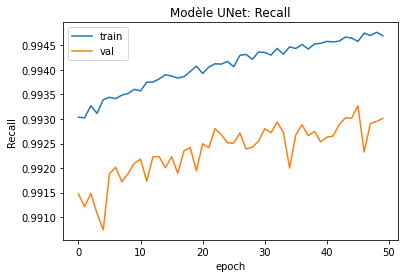

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history_50['loss'])
plt.plot(history_50['val_loss'])
plt.title('Modèle UNet: Loss')
plt.ylabel('Dice Doef Loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Loss.png")
plt.plot(history_50['dice_coef'])
plt.plot(history_50['val_dice_coef'])
plt.title('Modèle UNet: Score')
plt.ylabel('Dice Coef Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Score.png")
plt.plot(history_50['f1_m'])
plt.plot(history_50['val_f1_m'])
plt.title('Modèle UNet: F1 Score')
plt.ylabel('F1 Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_F1_Score.png")
plt.plot(history_50['precision_m'])
plt.plot(history_50['val_precision_m'])
plt.title('Modèle UNet: Precision')
plt.ylabel('Precision')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Precision.png")
plt.plot(history_50['recall_m'])
plt.plot(history_50['val_recall_m'])
plt.title('Modèle UNet: Recall')
plt.ylabel('Recall')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
plt.savefig("Modèle_UNet_Recall.png")

In [ ]:
unet_model_50.compile(optimizer=Adam(lr=1e-5),loss=dice_coef_loss,metrics=[dice_coef,f1_m,precision_m, recall_m])

In [ ]:
loss,score,f1_score,precision,recall = unet_model_50.evaluate(X_test,Y_test_encod,verbose=0)

In [ ]:
print("Loss = ",loss,"Score= ",score,"F1-Score= ",f1_score,"Precision= ",precision,"Recall= ",recall)

Loss =  0.00566073282409394 Score=  0.9943395 F1-Score=  0.99379635 Precision=  0.9938593 Recall=  0.99373364


In [ ]:
Y_pre = np.argmax(unet_model_50.predict(X_test),axis=-1)

In [ ]:
np.unique(Y_pre)

array([0, 1, 2])

In [ ]:
Y_pre=Y_pre.reshape(-1,192,192,1)

In [ ]:
Y_test.shape,X_test.shape

((684, 192, 192, 1), (684, 192, 192, 4))

X_test 0


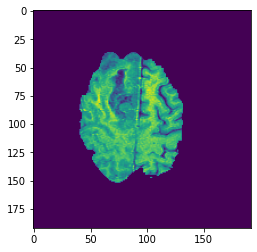

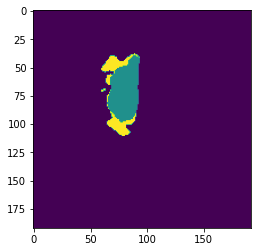

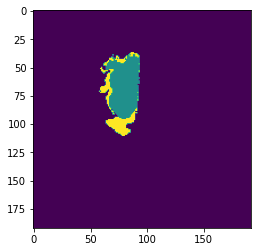

X_test 1


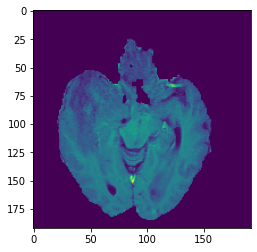

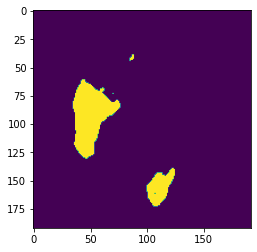

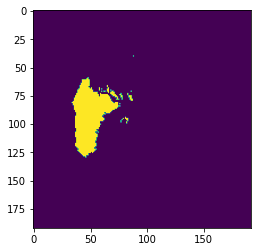

X_test 2


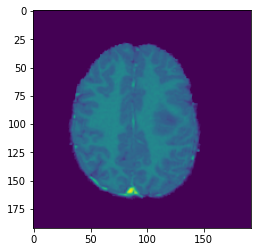

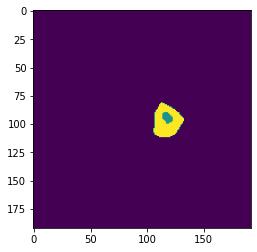

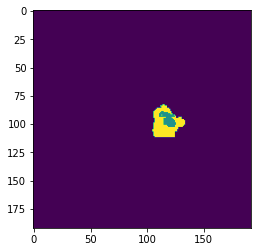

X_test 3


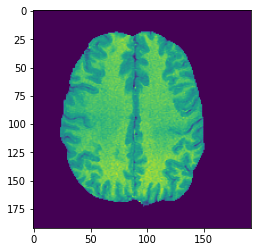

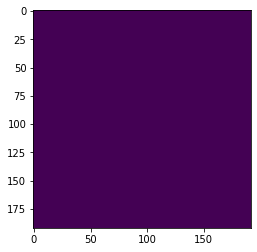

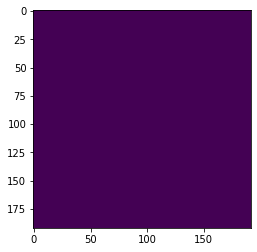

X_test 4


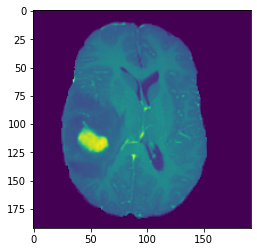

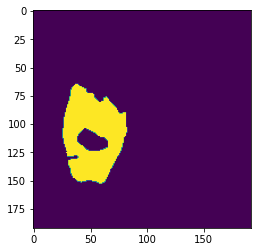

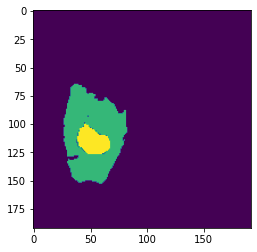

X_test 5


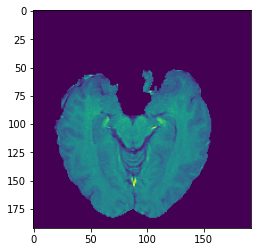

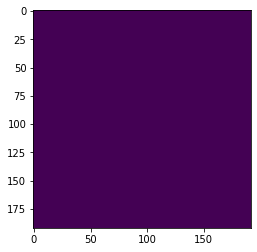

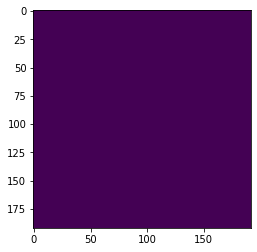

X_test 6


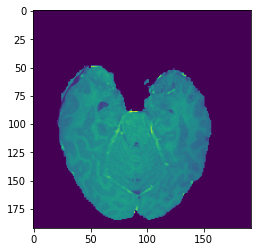

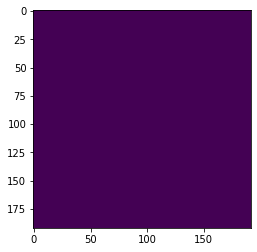

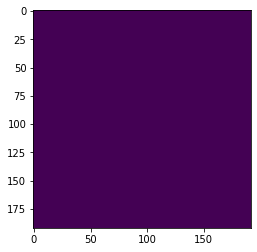

X_test 7


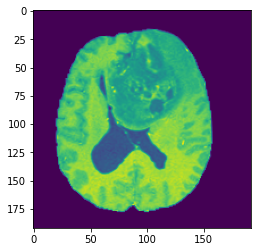

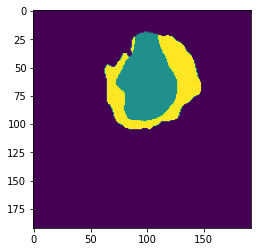

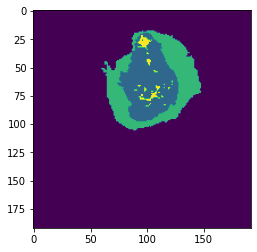

X_test 8


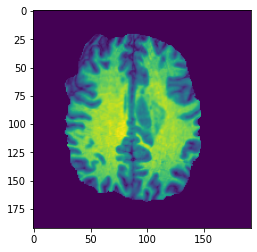

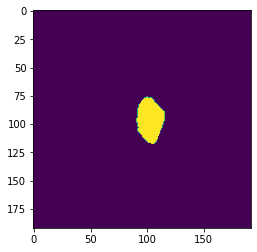

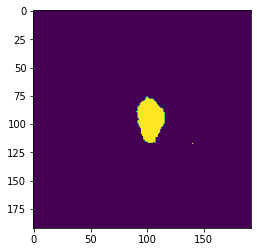

X_test 9


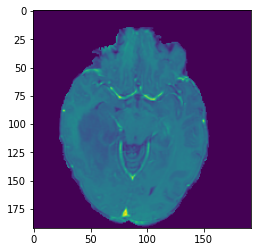

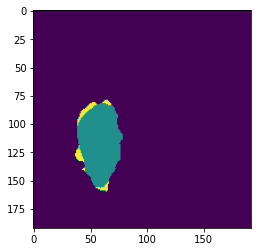

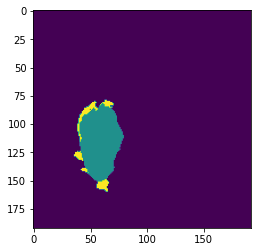

X_test 10


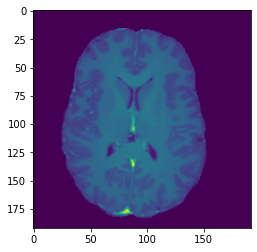

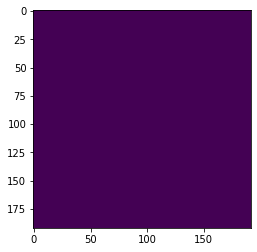

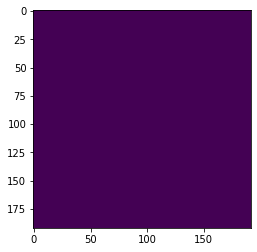

X_test 11


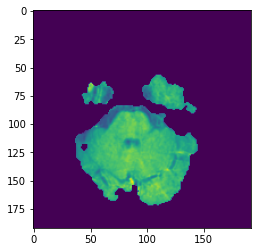

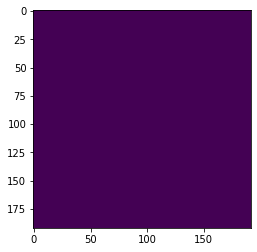

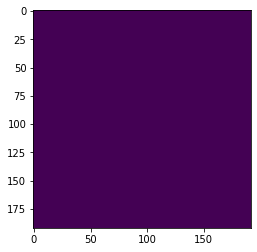

X_test 12


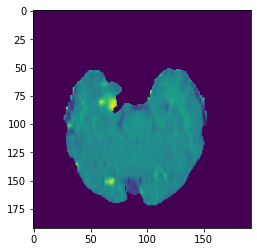

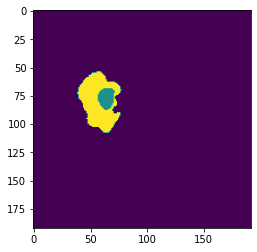

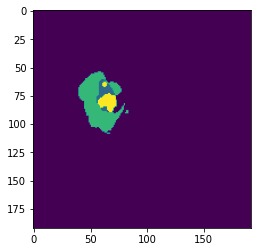

X_test 13


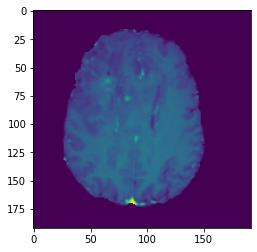

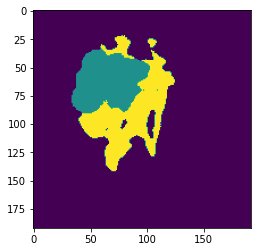

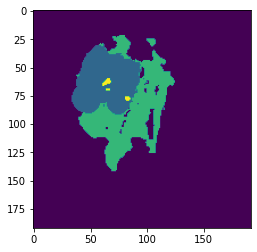

X_test 14


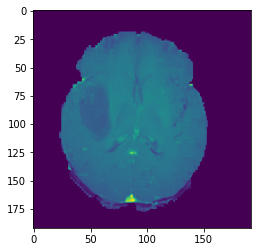

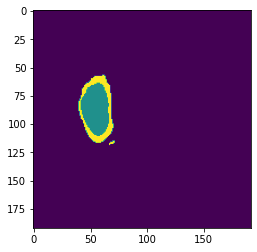

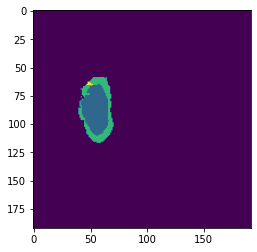

X_test 15


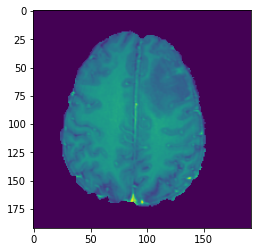

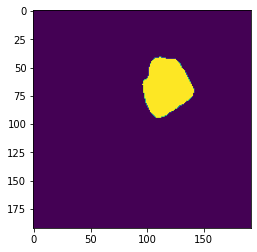

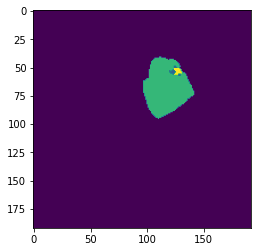

X_test 16


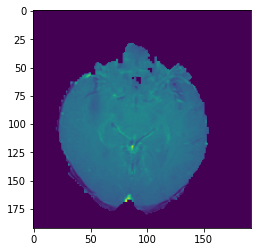

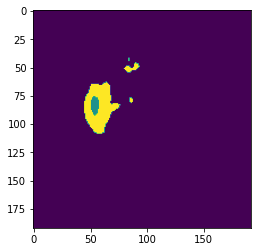

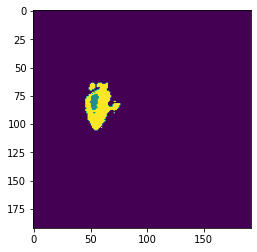

X_test 17


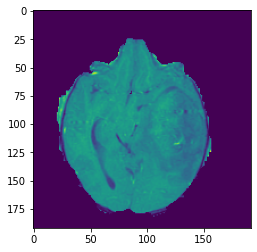

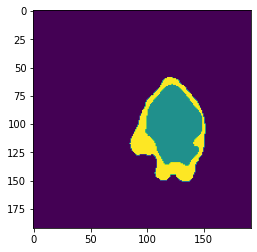

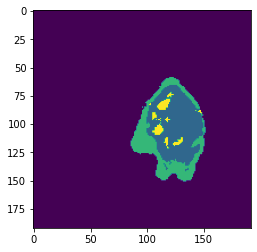

X_test 18


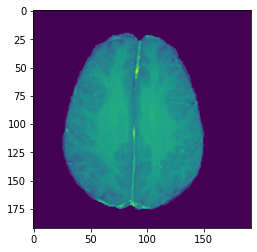

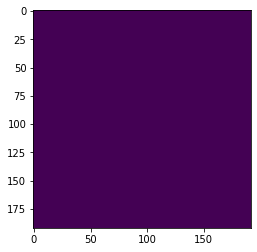

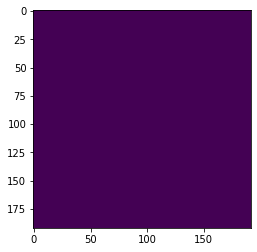

X_test 19


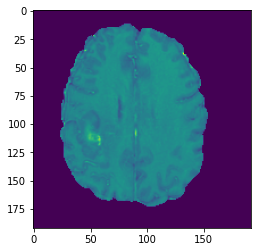

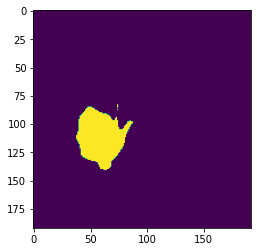

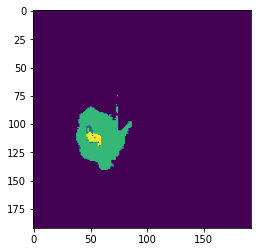

X_test 20


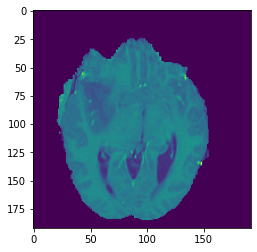

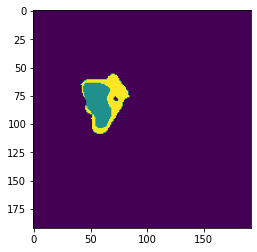

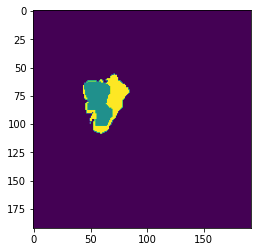

X_test 21


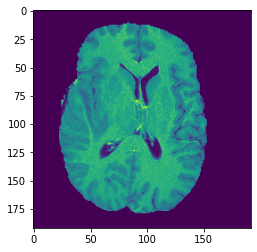

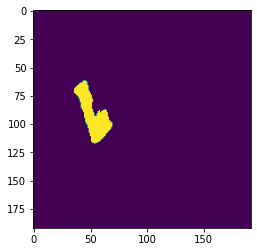

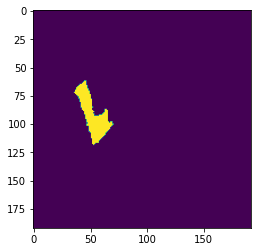

X_test 22


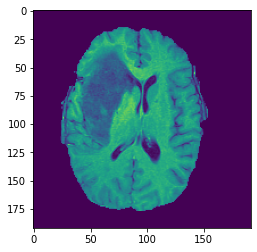

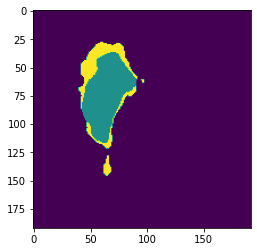

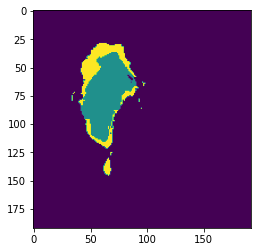

X_test 23


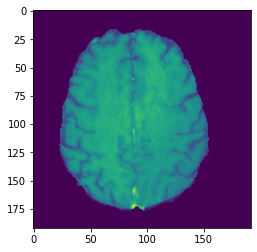

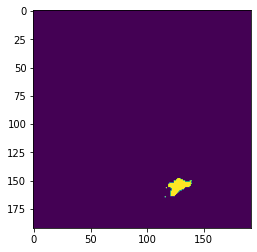

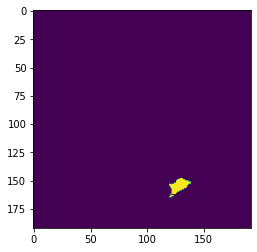

X_test 24


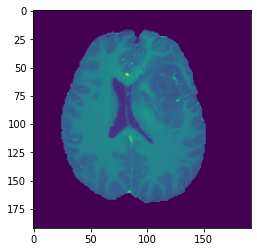

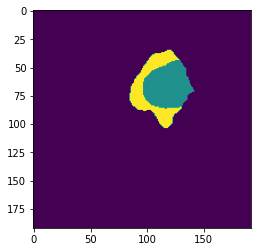

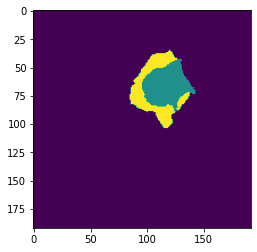

X_test 25


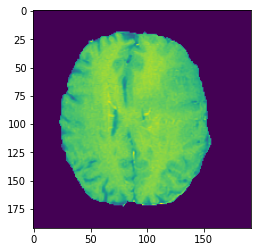

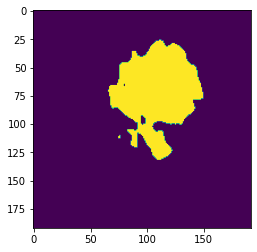

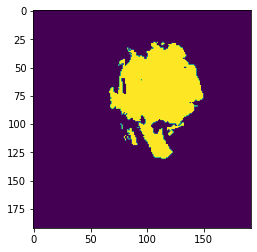

X_test 26


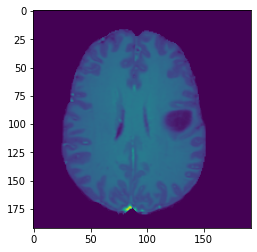

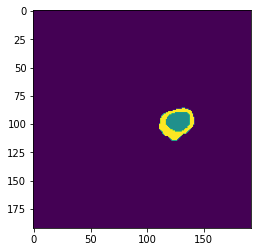

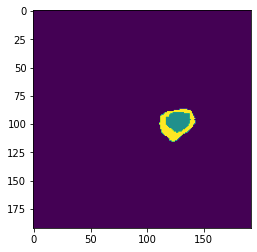

X_test 27


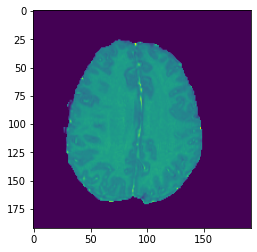

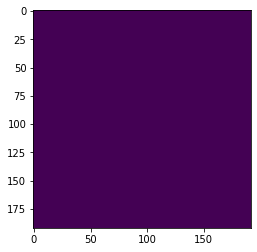

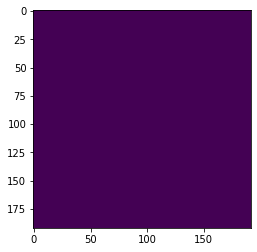

X_test 28


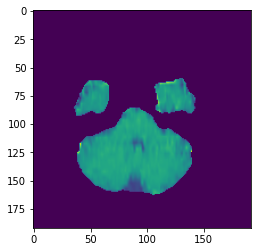

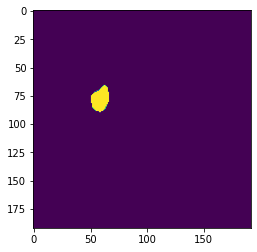

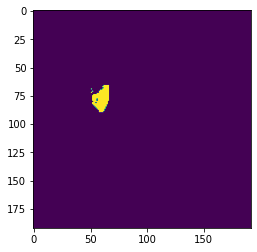

X_test 29


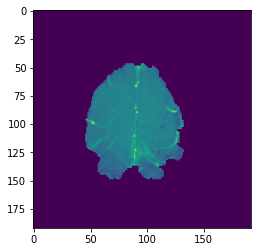

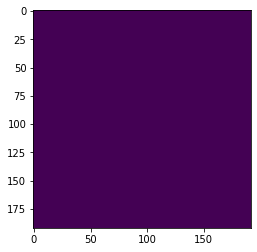

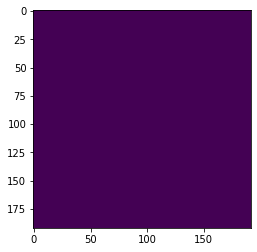

X_test 30


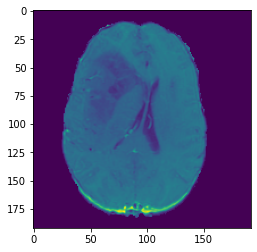

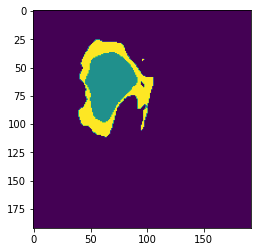

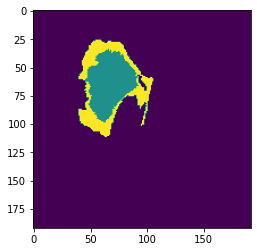

X_test 31


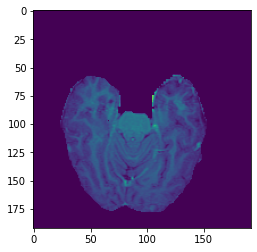

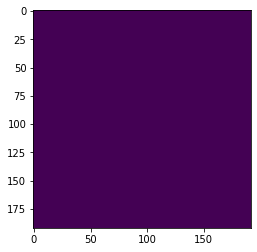

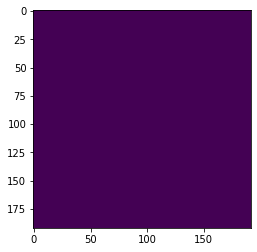

X_test 32


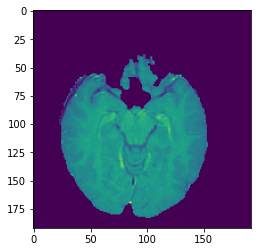

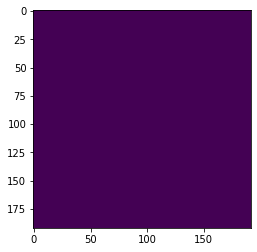

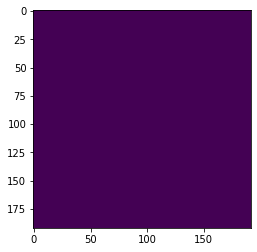

X_test 33


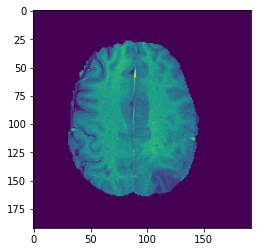

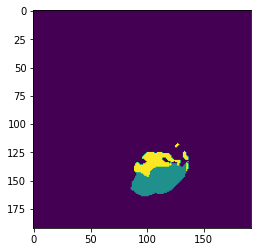

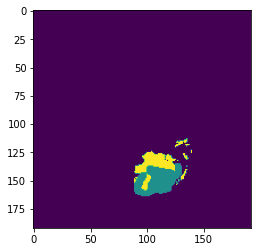

X_test 34


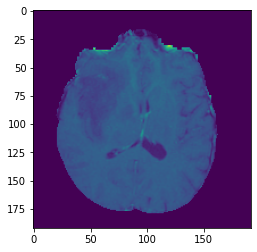

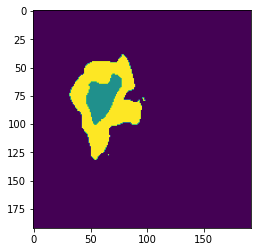

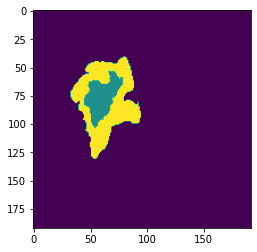

X_test 35


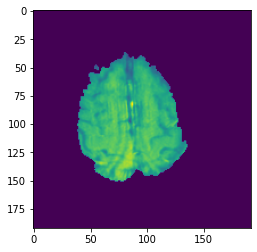

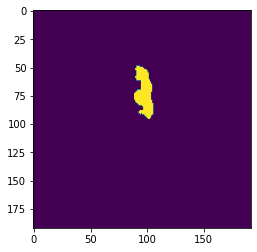

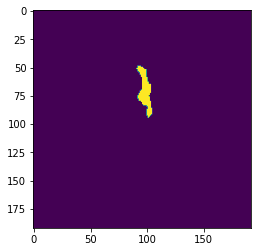

X_test 36


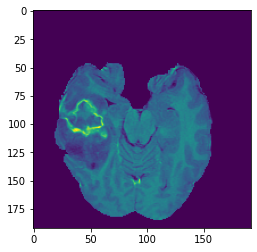

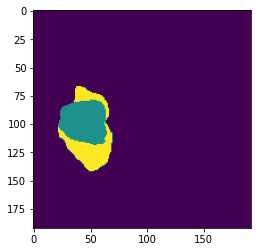

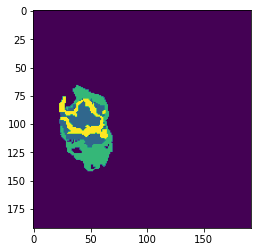

X_test 37


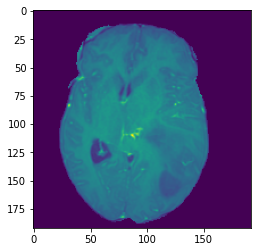

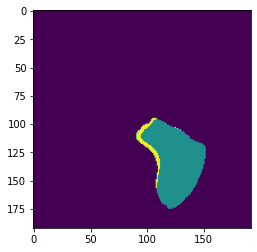

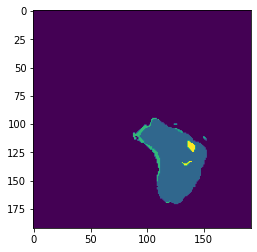

X_test 38


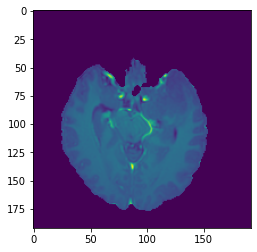

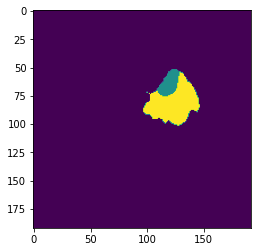

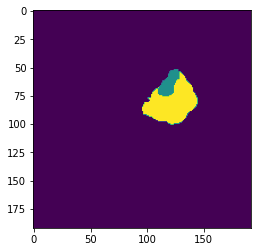

X_test 39


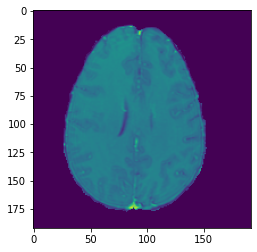

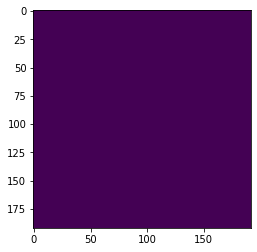

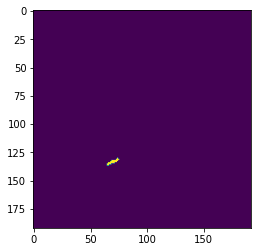

X_test 40


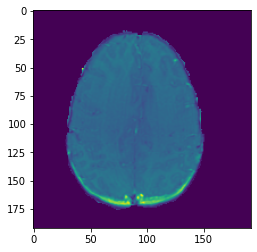

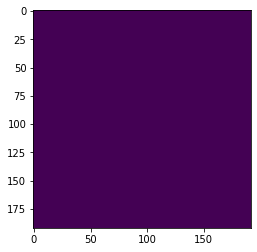

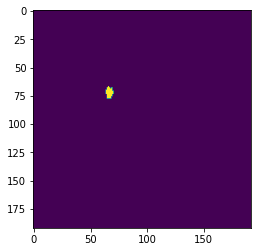

X_test 41


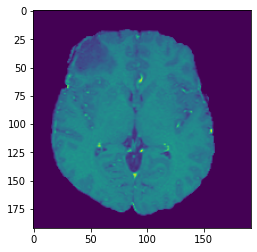

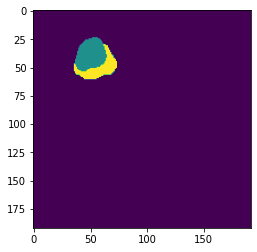

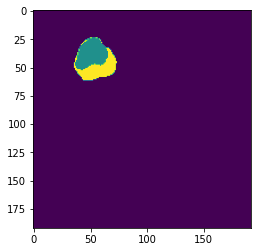

X_test 42


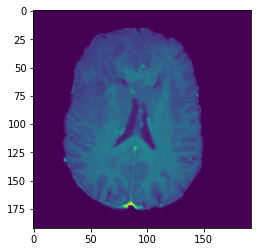

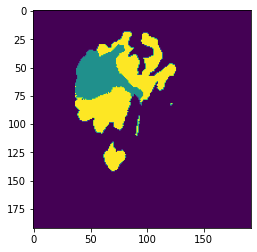

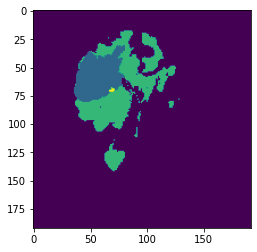

X_test 43


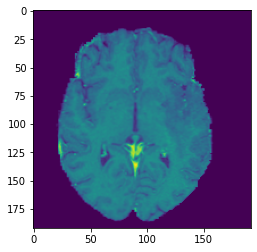

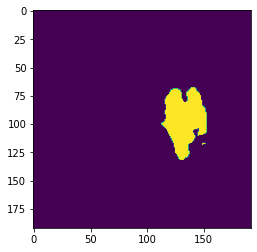

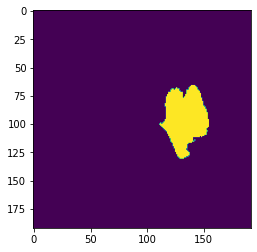

X_test 44


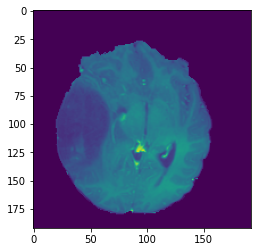

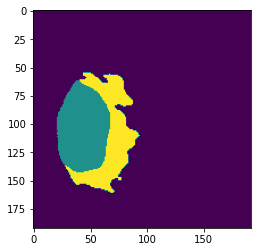

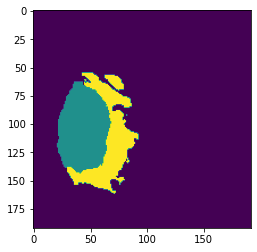

X_test 45


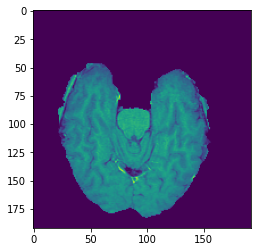

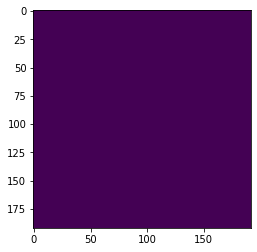

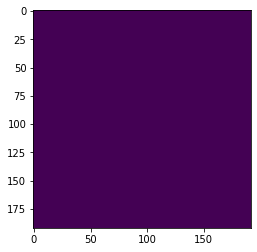

X_test 46


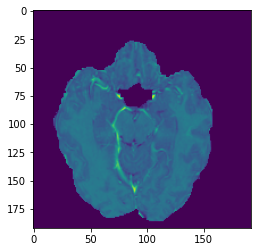

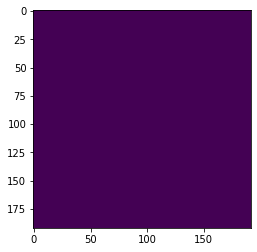

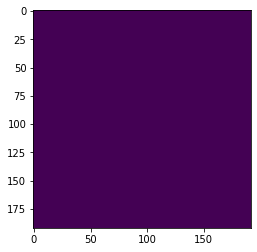

X_test 47


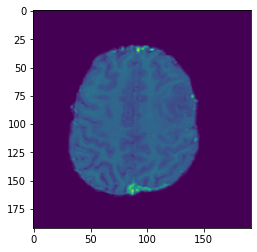

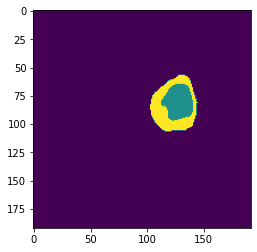

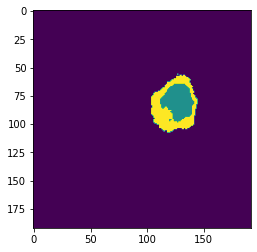

X_test 48


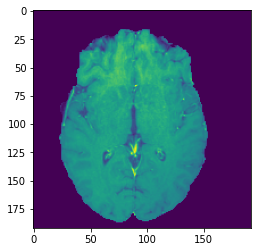

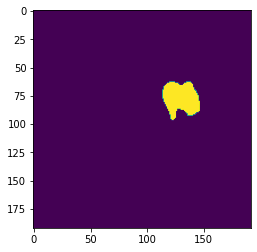

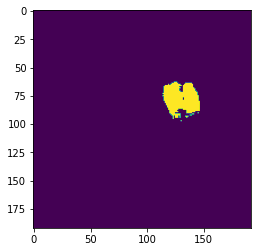

X_test 49


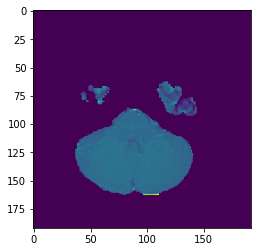

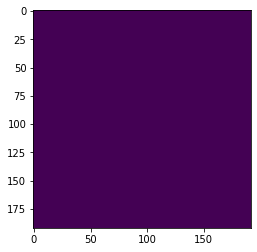

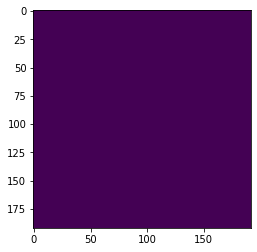

X_test 50


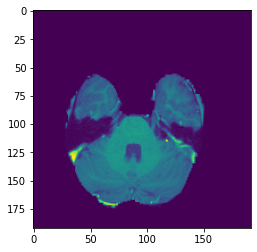

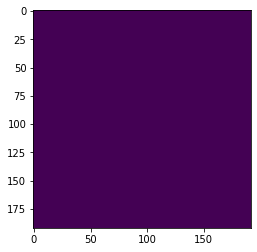

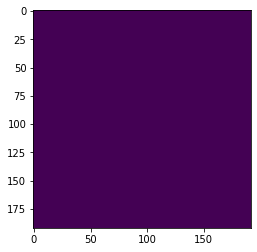

X_test 51


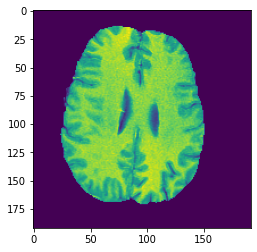

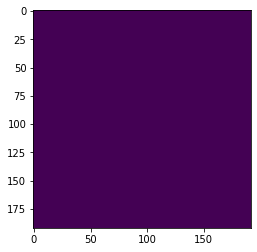

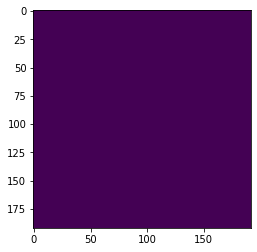

X_test 52


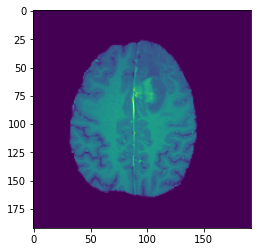

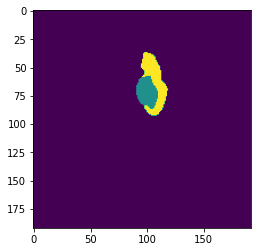

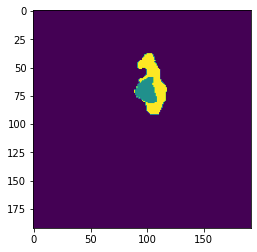

X_test 53


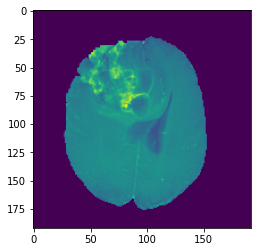

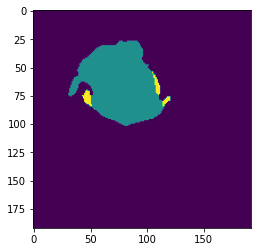

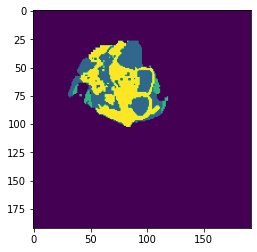

X_test 54


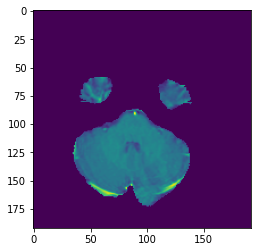

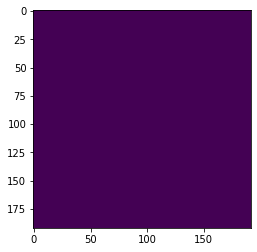

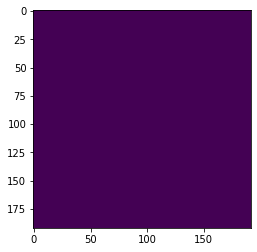

X_test 55


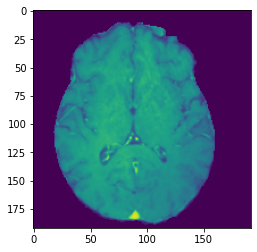

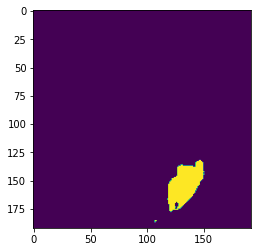

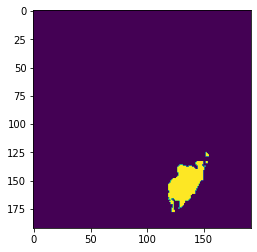

X_test 56


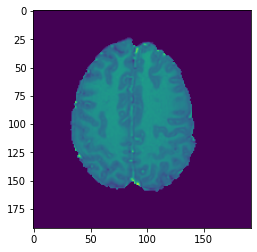

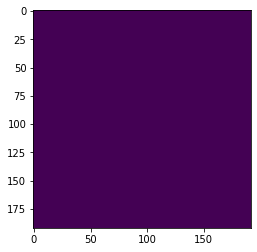

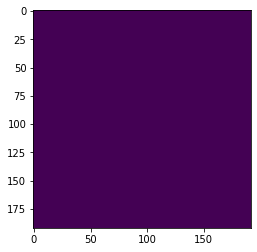

X_test 57


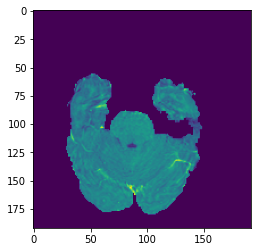

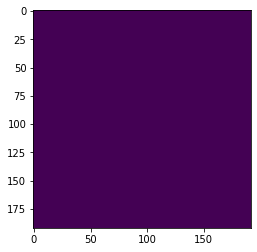

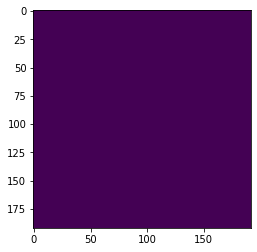

X_test 58


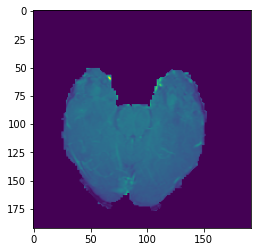

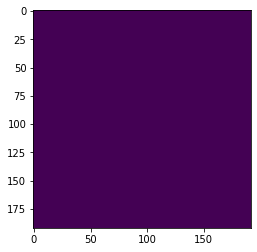

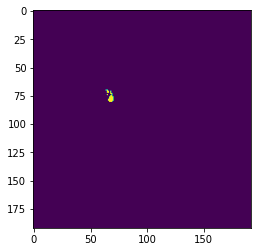

X_test 59


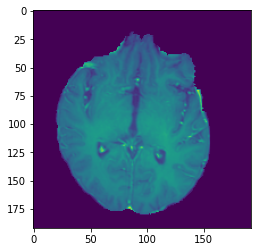

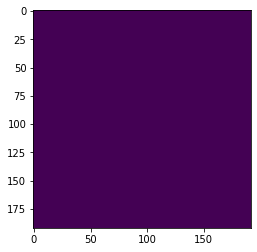

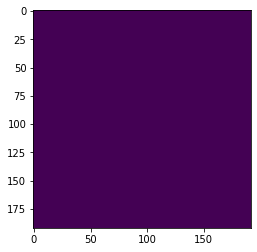

X_test 60


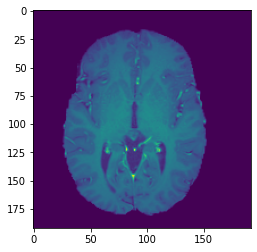

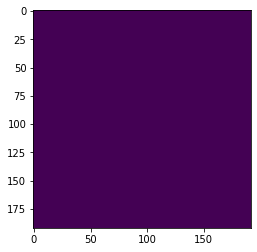

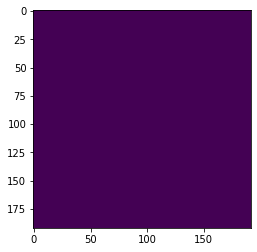

X_test 61


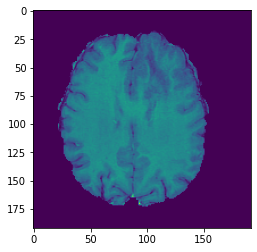

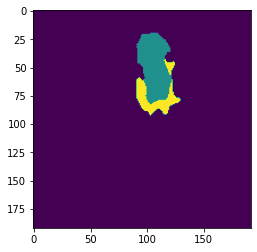

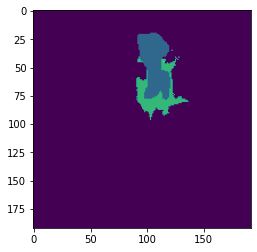

X_test 62


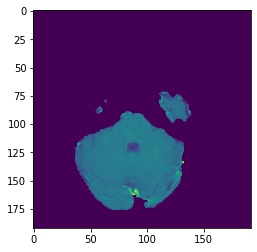

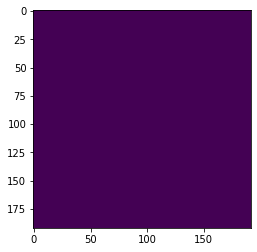

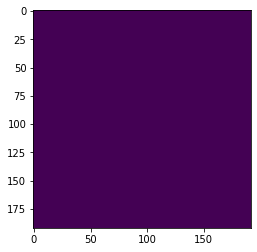

X_test 63


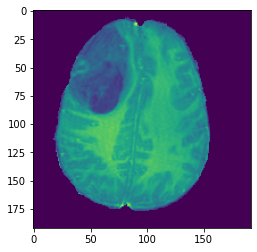

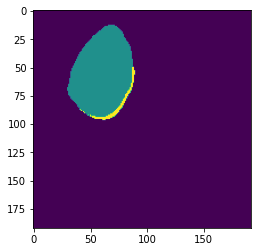

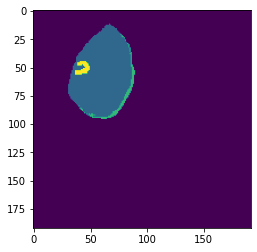

X_test 64


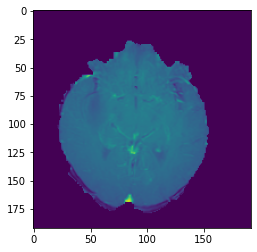

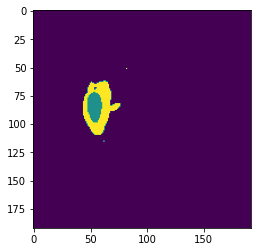

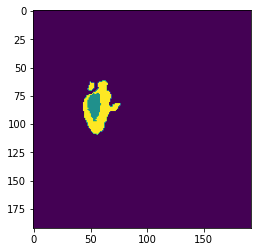

X_test 65


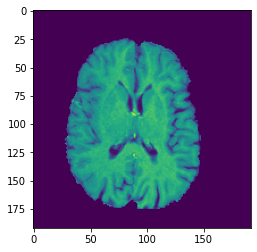

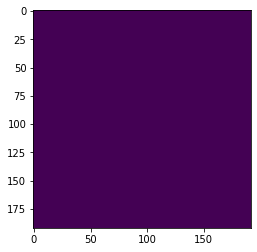

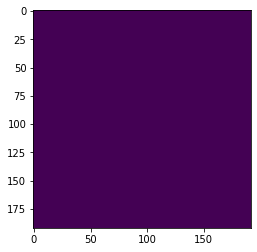

X_test 66


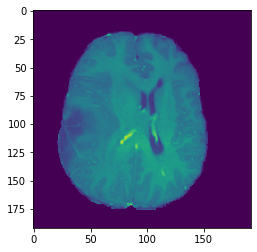

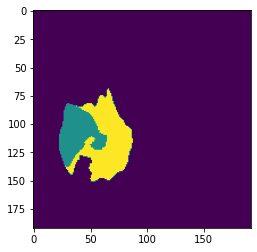

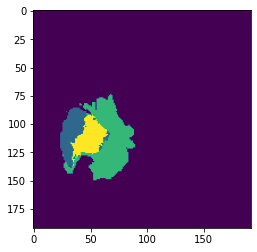

X_test 67


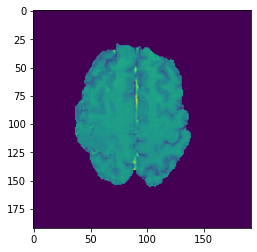

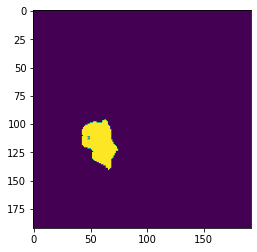

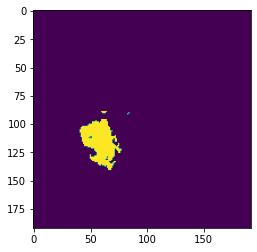

X_test 68


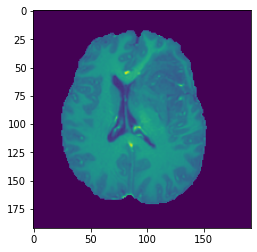

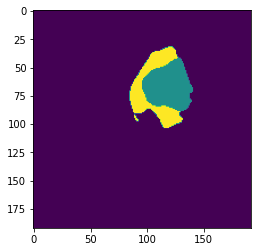

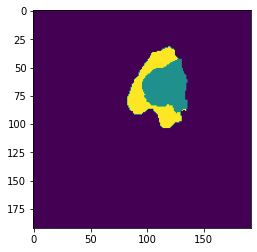

X_test 69


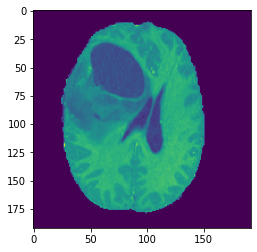

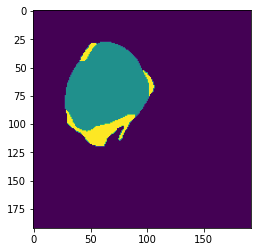

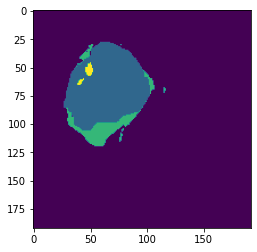

X_test 70


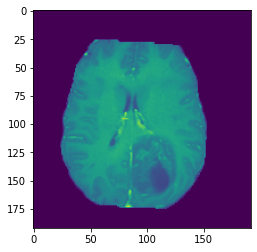

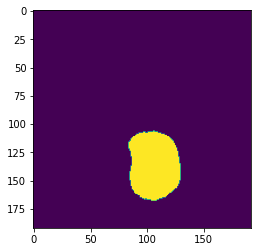

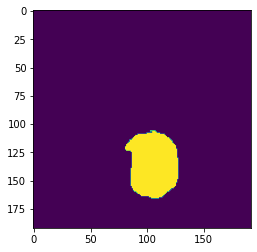

X_test 71


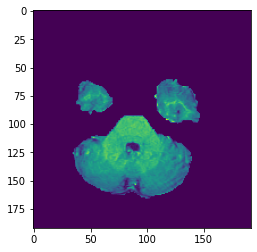

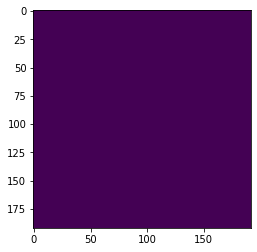

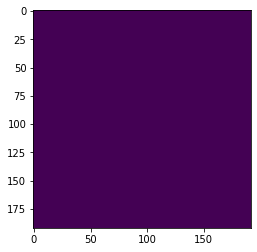

X_test 72


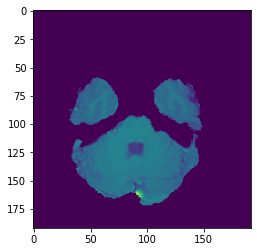

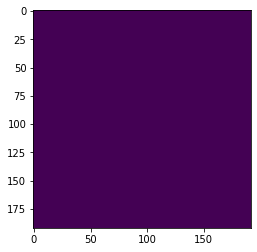

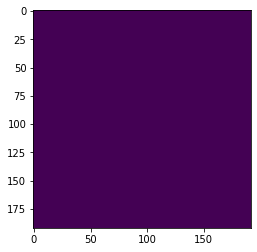

X_test 73


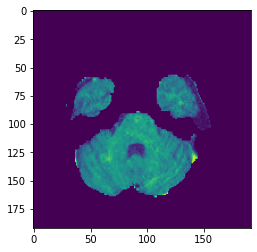

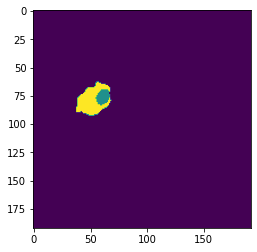

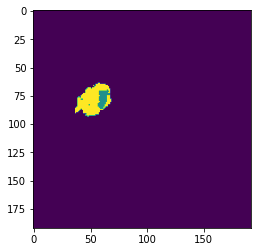

X_test 74


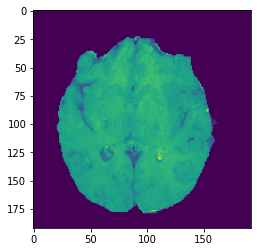

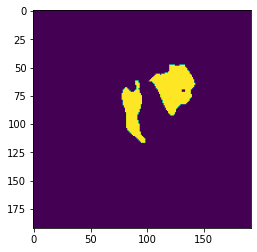

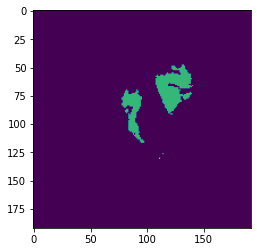

X_test 75


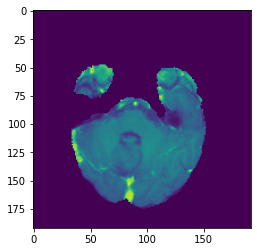

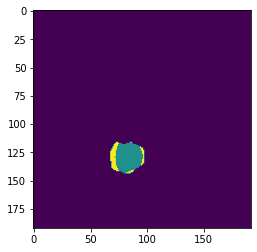

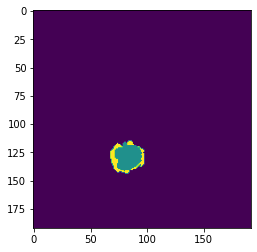

X_test 76


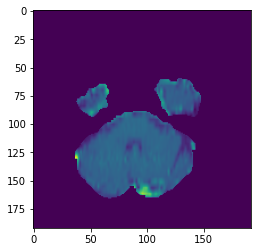

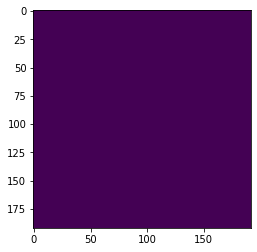

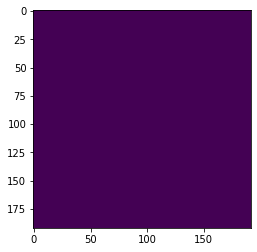

X_test 77


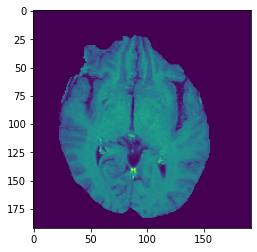

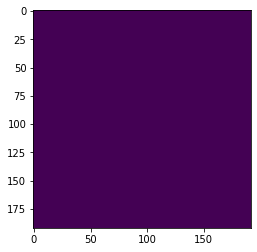

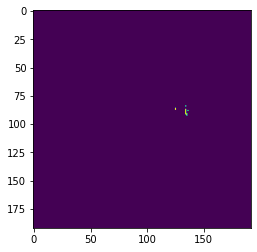

X_test 78


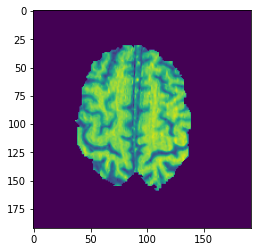

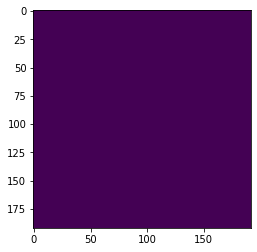

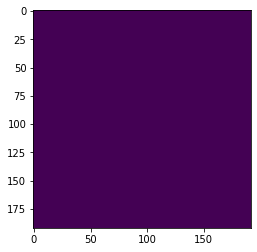

X_test 79


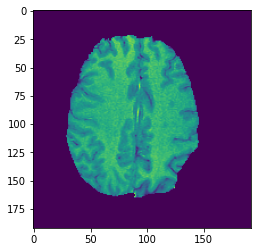

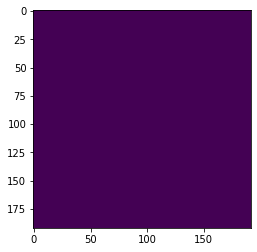

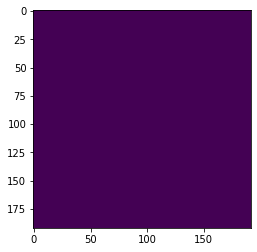

X_test 80


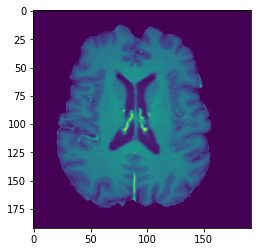

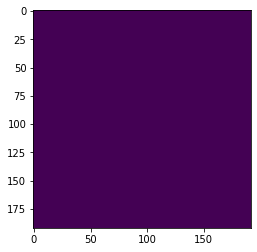

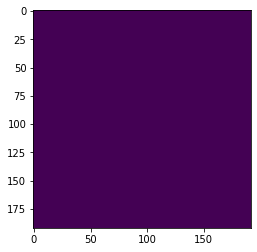

X_test 81


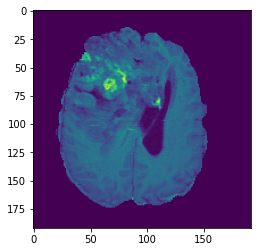

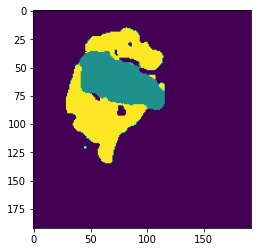

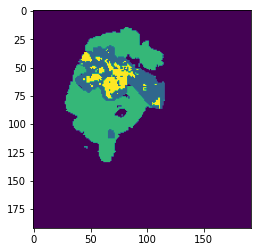

X_test 82


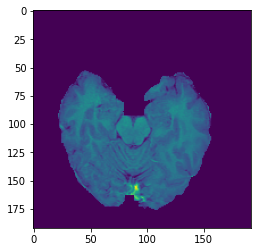

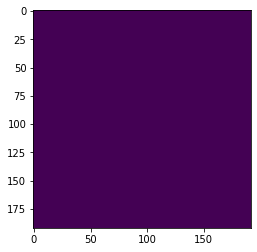

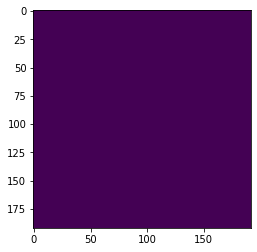

X_test 83


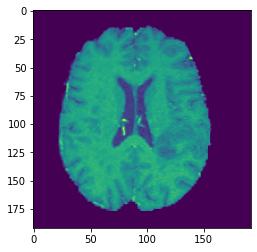

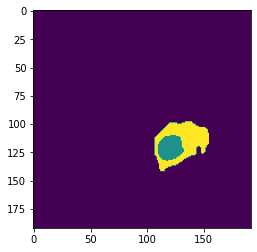

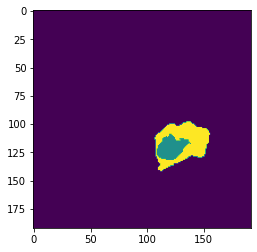

X_test 84


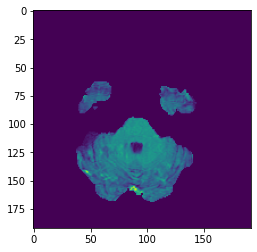

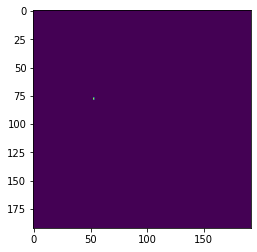

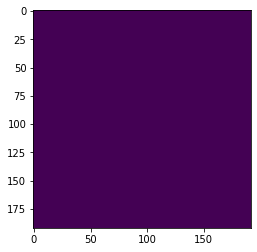

X_test 85


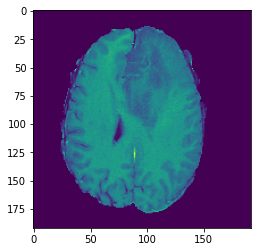

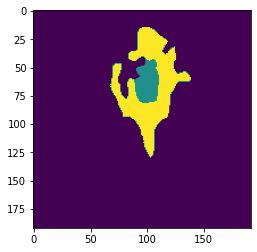

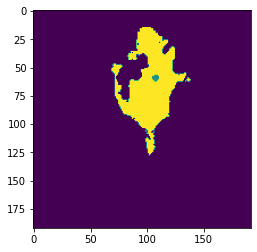

X_test 86


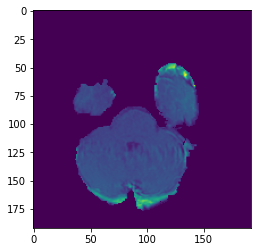

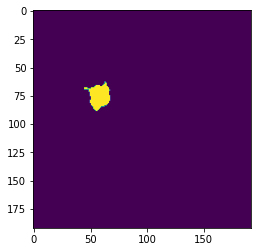

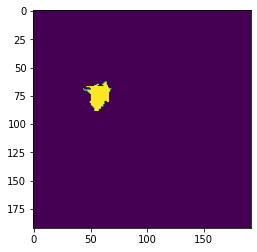

X_test 87


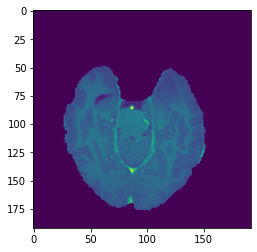

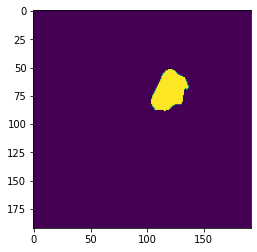

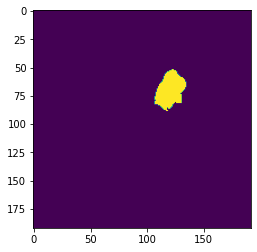

X_test 88


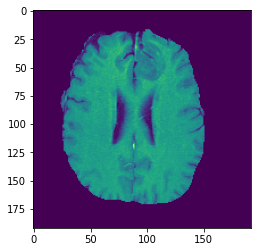

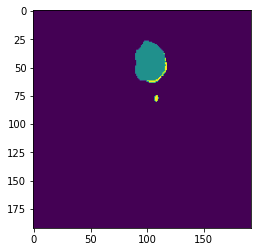

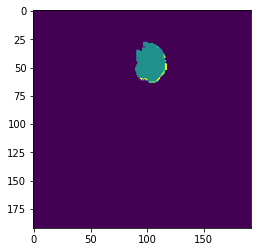

X_test 89


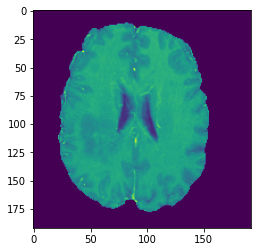

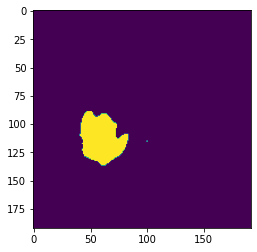

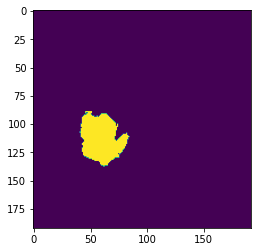

In [ ]:
for i in range(0,90):
  print('X_test '+ str(i))
  plt.imshow(X_test[i,:,:,2])
  plt.show()
  plt.imshow(Y_pre[i,:,:,0])
  plt.show()
  plt.imshow(Y_test[i,:,:,0])
  plt.show()

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


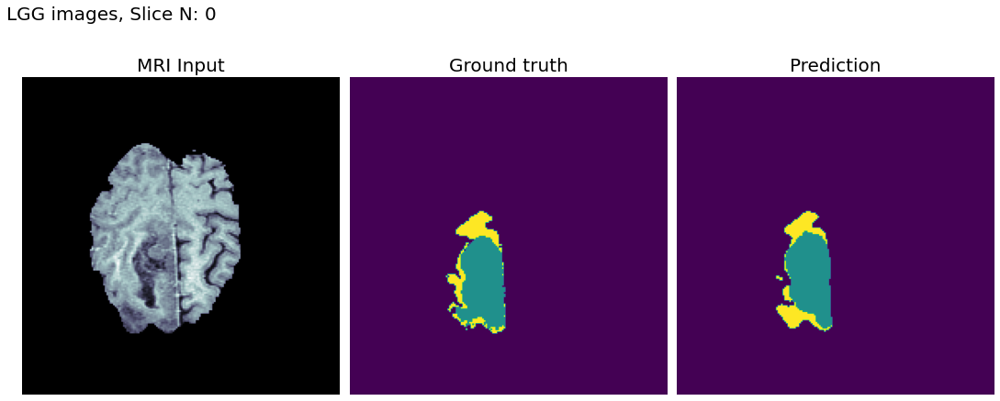

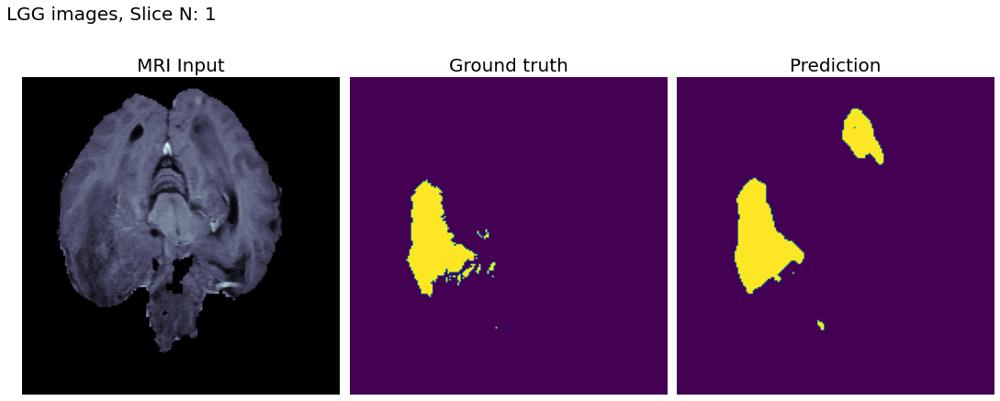

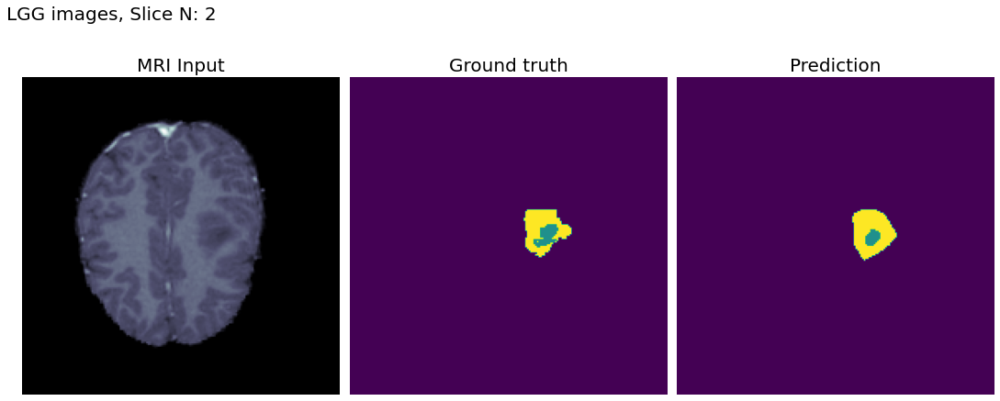

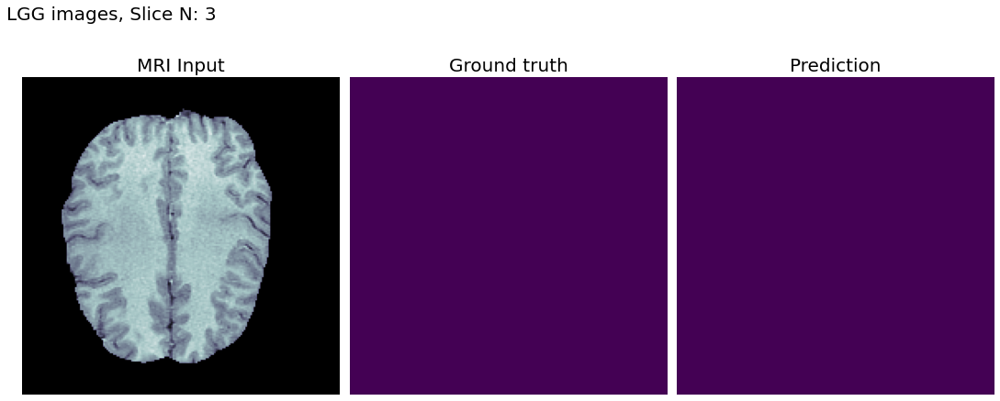

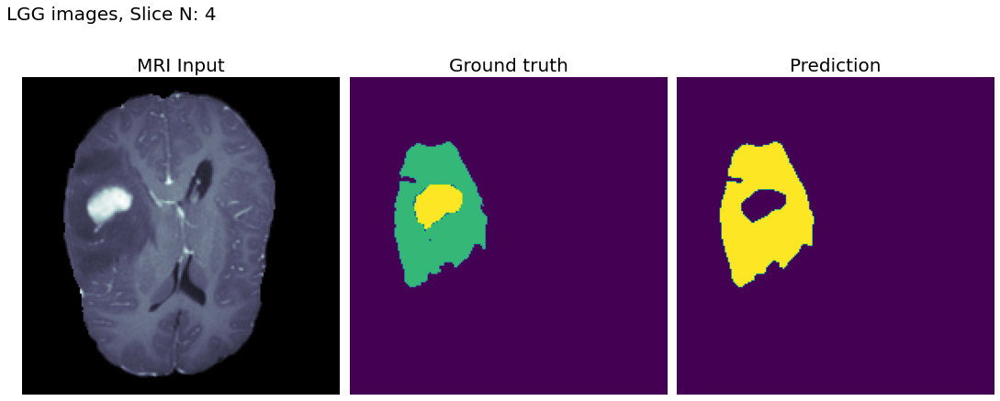

...

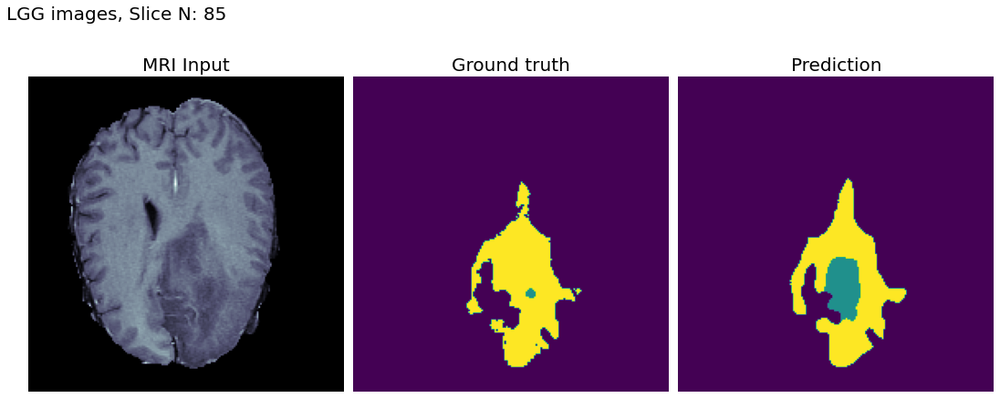

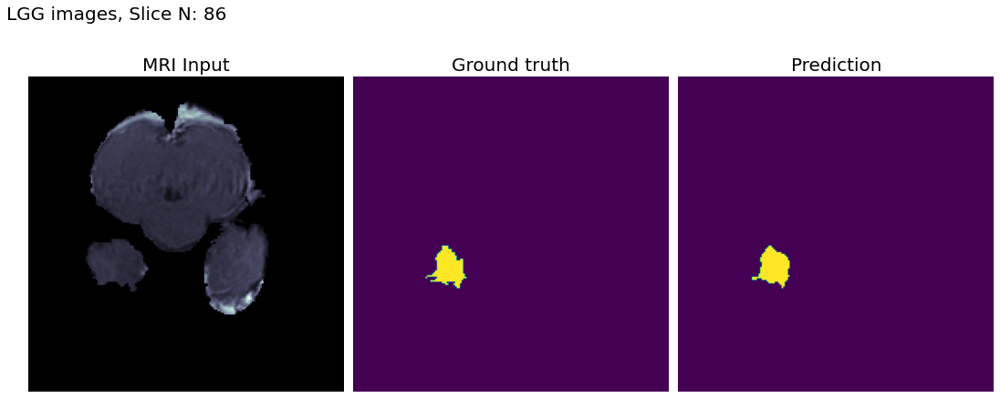

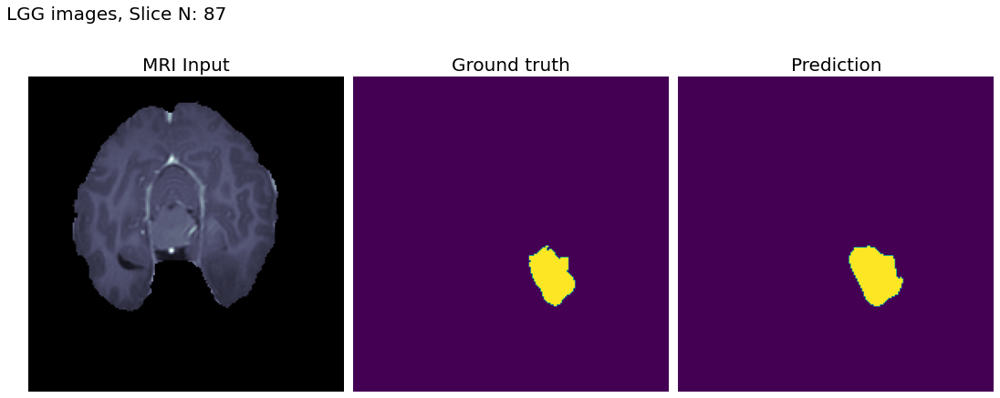

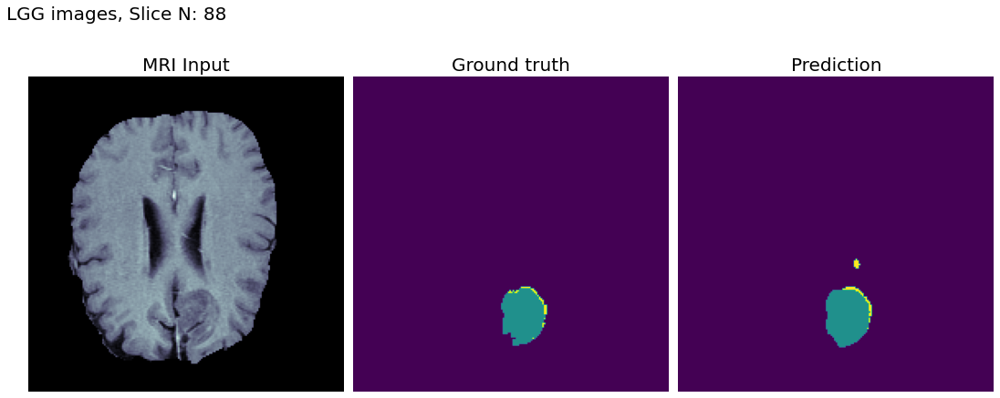

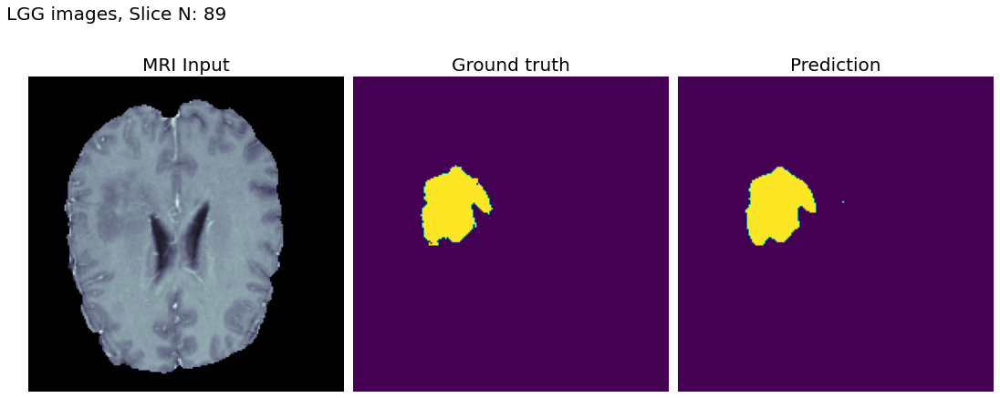

In [ ]:
for i in range(0,90):
        plt.figure(figsize=(15, 15))
        plt.suptitle("LGG images, Slice N: "+str(i), x=0.1, y=0.70,  fontsize=20, va="bottom")
        plt.subplot(1, 3, 1)
        plt.imshow(X_test[i,:,:,2], cmap="bone", origin="lower")
        plt.axis("off")
        plt.title("MRI Input", fontsize=20)
        plt.subplot(1, 3, 2)
        plt.imshow(Y_test[i,:,:,0], origin="lower")
        plt.axis("off")
        plt.title("X: Ground truth", fontsize=20)
        plt.subplot(1, 3, 3)
        plt.imshow(Y_pre[i,:,:,0], origin="lower")
        plt.axis("off")
        plt.title("Y: Prediction", fontsize=20)

        plt.tight_layout()